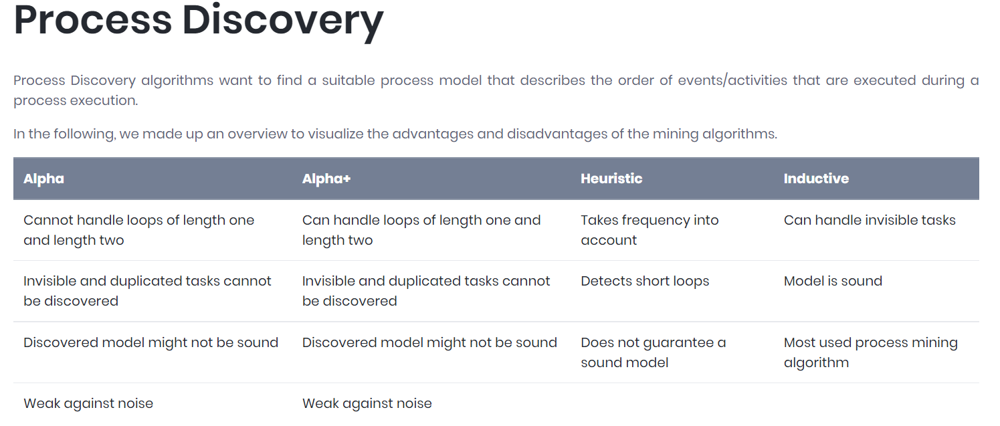

In [ ]:
!pip install vispm

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip install -U -q pm4py

import pandas as pd
import numpy as np
import pm4py
import seaborn as sns
import matplotlib.pyplot as plt

from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
#move to the directory where the module are located for duration_statistics_module  and social_network_analysis_module
%cd /content/drive/MyDrive/Abou Keita - Capstone 606/Python Notebooks
import duration_statistics_module 
import social_network_analysis_module

/content/drive/.shortcut-targets-by-id/1ciOd6JJn15yFRl7lXb8wUDf4DEFkFYlV/Abou Keita - Capstone 606/Python Notebooks


## Review Example Dataset

In [ ]:
review_example = '/content/drive/MyDrive/Abou Keita - Capstone 606/Datasets/review_example_large.xes'
df_log = pm4py.read_xes(review_example)

parsing log, completed traces ::   0%|          | 0/10000 [00:00<?, ?it/s]

Get starting and ending activities

In [ ]:
xes_start_activites = pm4py.get_start_activities(df_log)
xes_end_activites = pm4py.get_end_activities(df_log)
print("starting activity: {} \n ending activity: {}".format(xes_start_activites, xes_end_activites))

starting activity: {'invite reviewers': 10000} 
 ending activity: {'accept': 5068, 'reject': 4932}


DataFrame

In [ ]:
df_log

,org:resource,time:timestamp,concept:name,lifecycle:transition,case:concept:name,case:description,result
0,Mike,2005-12-31 23:00:00+00:00,invite reviewers,start,1,Simulated process instance,NaN
1,Mike,2006-01-04 23:00:00+00:00,invite reviewers,complete,1,Simulated process instance,NaN
2,Mary,2006-01-04 23:00:00+00:00,get review 3,complete,1,Simulated process instance,reject
3,Pam,2006-01-05 23:00:00+00:00,get review 1,complete,1,Simulated process instance,reject
4,__INVALID__,2006-01-14 23:00:00+00:00,time-out 2,complete,1,Simulated process instance,NaN
...,...,...,...,...,...,...,...
236355,Anne,2223-07-16 23:00:00+00:00,invite additional reviewer,start,9999,Simulated process instance,NaN
236356,Anne,2223-07-16 23:00:00+00:00,invite additional reviewer,complete,9999,Simulated process instance,NaN
236357,Sam,2223-07-20 23:00:00+00:00,get review X,complete,9999,Simulated process instance,accept
236358,Mike,2223-08-05 23:00:00+00:00,accept,start,9999,Simulated process instance,NaN


In [ ]:
df_log.columns

Index(['org:resource', 'time:timestamp', 'concept:name',
       'lifecycle:transition', 'case:concept:name', 'case:description',
       'result'],
      dtype='object')

In [ ]:
#df_Lbt.columns = df_Lbt.columns.str.replace('[:]','')

In [ ]:
#rename the columns
#df_Lbt.rename(columns={'orgresource':'Resource', 'lifecycletransition':'Transaction_life','timetimestamp':'timestamp' ,'conceptname':'activity','caseconceptname':'case_id'}, inplace=True)

In [ ]:
#df_Lbt.columns

In [ ]:
num_event = len(df_log)
num_cases = len(df_log['case:concept:name'].unique())
print("number of event: {} \n Number of unique cases: {}".format(num_event, num_cases))

number of event: 236360 
 Number of unique cases: 10000


In [ ]:
#This block determines which activities are used to start and which activities processes ends with a given dataset
#In the case of this datasets, all 10000 events start with the "ST" activity and ends with the "FT" activity
# Returns the number starting and ending traces with the number of events starting/ending with them
#df_Lbt2 = pm.format_dataframe(df_log, case_id='case:concept:name', activity_key='concept:name', timestamp_key='time:timestamp', timest_format='%Y-%m-%d %H:%M:%S%z')
#start_activites = pm.get_start_activities(df_Lbt2)
#end_activities = pm.get_end_activities(df_Lbt2)
#print("starting activity: {} \n ending activity: {}".format(start_activites, end_activities))

In [ ]:
df_log['org:resource'].unique()

array(['Mike', 'Mary', 'Pam', '__INVALID__', 'Anne', 'Wil', 'Carol',
       'Pete', 'Sara', 'John', 'Sam'], dtype=object)

In [ ]:
#the unique activies taking places in the log
df_log['concept:name'].nunique()

14

**Inductive Miner**

In PM4Py, we offer an implementation of the inductive miner (IM), of the inductive miner infrequent (IMf), and of the inductive miner directly-follows (IMd) algorithm. The papers describing the approaches are the following:

Inductive Miner: Discovering block-structured process models from event logs-a constructive approach
Inductive Miner infrequent: Discovering block-structured process models from event logs containing infrequent behaviour
Inductive Miner directly-follows Scalable process discovery with guarantees
The basic idea of Inductive Miner is about detecting a 'cut' in the log (e.g. sequential cut, parallel cut, concurrent cut and loop cut) and then recur on sublogs, which were found applying the cut, until a base case is found. The Directly-Follows variant avoids the recursion on the sublogs but uses the Directly Follows graph.

Inductive miner models usually make extensive use of hidden transitions, especially for skipping/looping on a portion on the model. Furthermore, each visible transition has a unique label (there are no transitions in the model that share the same label). \n

https://pm4py.fit.fraunhofer.de/documentation#discovery


In [ ]:
xes_log = pm4py.convert_to_event_log(df_log)

/usr/local/lib/python3.8/dist-packages/pm4py/utils.py:486: UserWarning: the EventLog class has been deprecated and will be removed in a future release.
  warnings.warn("the EventLog class has been deprecated and will be removed in a future release.")


**BPMN model**

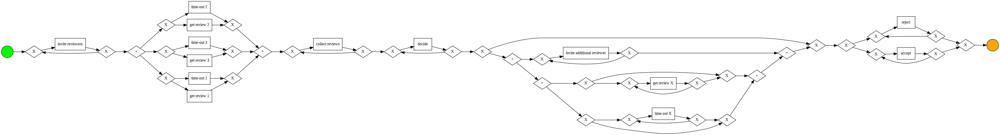

In [ ]:
# The BPMN model is model where PM4PY looks at the event log and computes an abstract version of the "Direct Follow Graph".. It tries to smartly discover certain patterns
# Direct Follow Graph shows a graph of the CONSECUTIVE presence of one acitvites after another 
# It detects sequential behavior and tries to find any concucenry of activities

#How to read
#--------------
#1. The graph is read from left to right
#2. The direction of the arrows indications the sequential direction of one activity to another
#3. The start is denoted in green, The end is denoted in orange
#4. Any activites INSIDE the <+> indicates that they can be done concurently
#5. Any activites INSIDE the <X> indicates that they ONLY ONE of the activities can be done before moving to the right
#1. The graph is read from left to right,

bpmn_model = pm4py.discover_bpmn_inductive(xes_log)
pm4py.view_bpmn(bpmn_model)

**Process Trees**

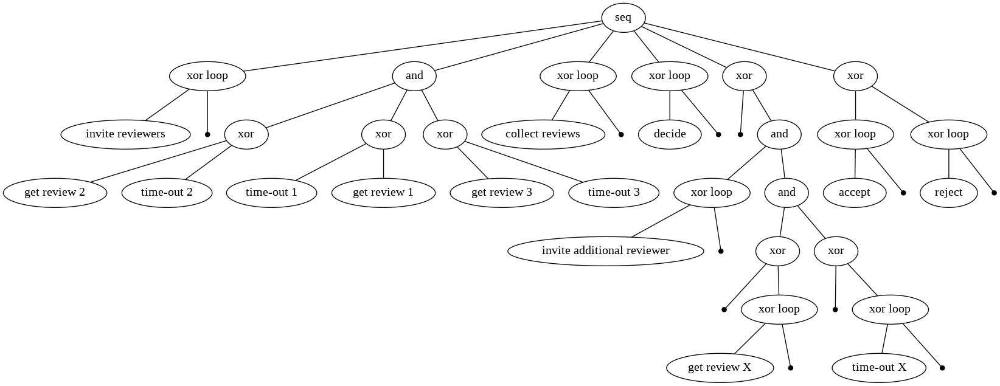

In [ ]:
# The Process Tree model creates a hieracrchal represenation of the process model
# it contains XOR node = which means that either A CHOICE OF ACTIVITY must be made to continue 
# It contains AND node = means that the followwing activity can be done concurrently. HOWEVER, ALL the activites on the left branches must be done to continue to the right tree of the AND parent node

#How to read
#--------------
#1. Every node and leaf has an assoicated label
 #a. A node with two or more connection indicate that it is an internal node, meaning inside of a process group
 #b. A node = an operator or describe an activity
#2. the "seq" node indicates that it is a sequential activtiy occurring from left activity to right activity
  #a. ALL activity from the right side MUST be fully (all the way to the most bottom leaf to all the way the right node)

process_tree = pm4py.discover_process_tree_inductive(xes_log)
pm4py.view_process_tree(process_tree)

**Petri Nets**: To mine a Petri Net 

A log is read, the inductive miner is applied and the Petri net along with the initial and the final marking are found. First, the log is read, then the inductive miner algorithm is applied.

Can also accepts a process tree as input

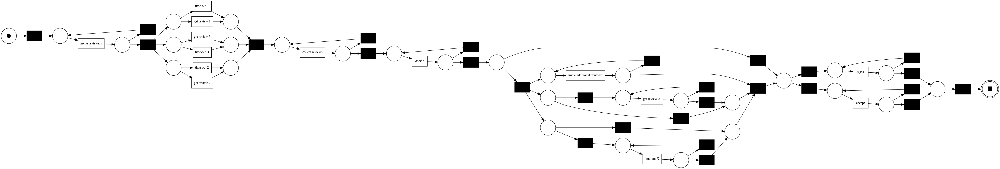

In [ ]:
#How to read
#--------------
#1. Similar to the BPMN model in term of the reading 
 #a. The white circle = transition of state. 
 #b. The circle with the black circle can be represent as the start and the black circle as a token of where an event is in the activites
 #c. The black circle = token
 #d. As the token reaches an activity, it erase the token from the previous steps and generate a new from that specicifc acitvity and moves to the right. It create a new token for each new path taken
 #e. When a token reaches a white circle, the old token is erase and the generates a new one then moves
 # the black shaded squares indicates that the algorithm detected an "unobservable activity". They are used for routing and enable concurance
 # More information can be found on this site for more clarification: https://www.techfak.uni-bielefeld.de/~mchen/BioPNML/Intro/pnfaq.html
 

net, initial_marking, final_marking = pm4py.discover_petri_net_inductive(xes_log)
pm4py.view_petri_net(net, initial_marking, final_marking)

**Alpha Miner**

The alpha miner is one of the most known Process Discovery algorithm and is able to find:

A Petri net model where all the transitions are visible and unique and correspond to classified events (for example, to activities).
An initial marking that describes the status of the Petri net model when a execution starts.
A final marking that describes the status of the Petri net model when a execution ends.

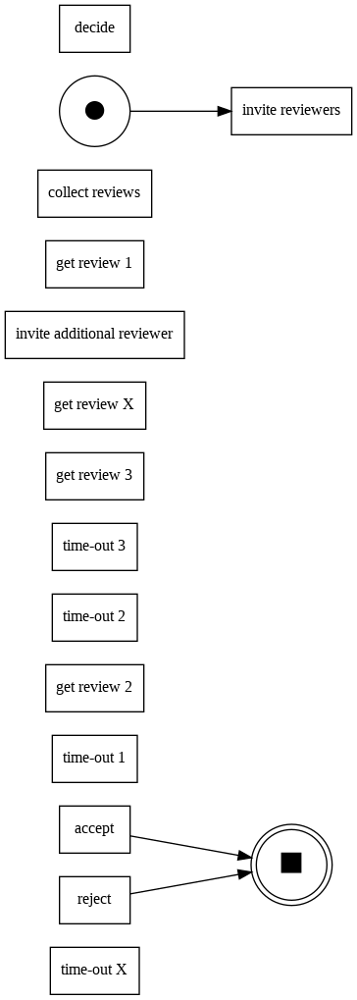

In [ ]:
net1, im1, fm1 = pm4py.discover_petri_net_alpha(xes_log)
pm4py.view_petri_net(net1, im1, fm1)

**Alpha Miner Plus**

a. not good at finding "invisble" transition

b. can be problamatic

<ipython-input-52-d2afa5897a15>:1: DeprecatedWarning: discover_petri_net_alpha_plus is deprecated as of 2.3.0 and will be removed in 3.0.0. this method will be removed in a future release.
  net2, im2, fm2 = pm4py.discover_petri_net_alpha_plus(xes_log)


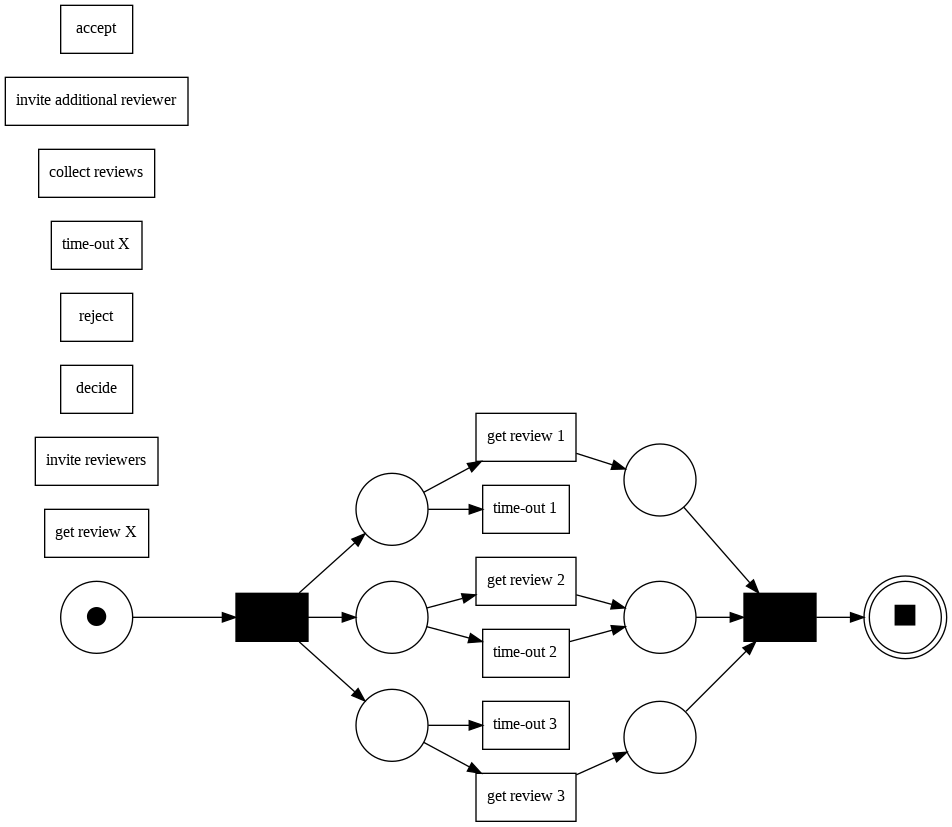

In [ ]:
net2, im2, fm2 = pm4py.discover_petri_net_alpha_plus(xes_log)
pm4py.view_petri_net(net2, im2, fm2)

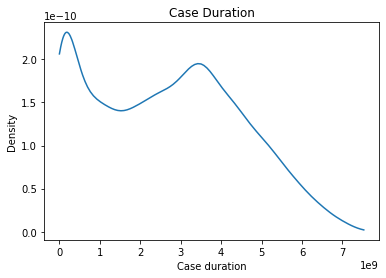

In [ ]:
pm4py.view_case_duration_graph(xes_log)

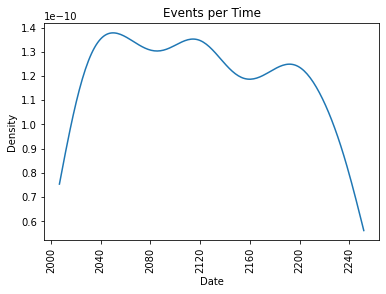

In [ ]:
pm4py.vis.view_events_per_time_graph(xes_log)

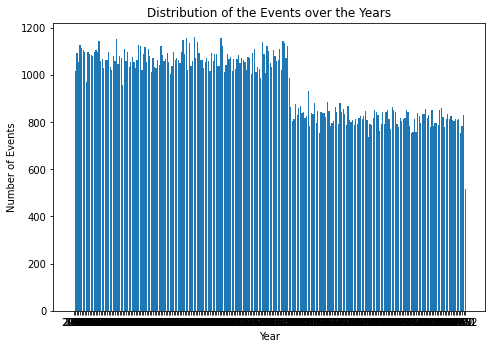

In [ ]:
pm4py.vis.view_events_distribution_graph(xes_log, distr_type= 'years', activity_key='concept:name', case_id_key='case:concept:name', timestamp_key='time:timestamp')

**Directly-Follows Graph**

Process models modeled using Petri nets have a well-defined semantic: a process execution starts from the places included in the initial marking and finishes at the places included in the final marking. 

Directly-Follows graphs are graphs where the nodes represent the events/activities in the log and directed edges are present between nodes if there is at least a trace in the log where the source event/activity is followed by the target event/activity. 

On top of these directed edges, it is easy to represent metrics like frequency (counting the number of times the source event/activity is followed by the target event/activity) and performance (some aggregation, for example, the mean, of time inter-lapsed between the two events/activities).

The type of process map used in other commecial tools. 

Cons:

1. The graphical relationship showed is LOCAL meaning from one activity to another activity
2. The structure can be misinterpreted by the user since it does not show a"general or global" relationship among activities. 
3. False interpretation leads to incorrect decision making when reorganize organization process

Pros:
1. Shows a clear LOCAL relationship among activities

<ipython-input-56-e14e9b39e739>:1: DeprecatedWarning: discover_dfg is deprecated as of 2.3.0 and will be removed in 2.4.0. this method will be replaced by the discover_dfg_typed function(). Please adapt your code to use pm4py.discover_dfg_typed()
  dfg, start_activities, end_activities = pm4py.discover_dfg(xes_log)


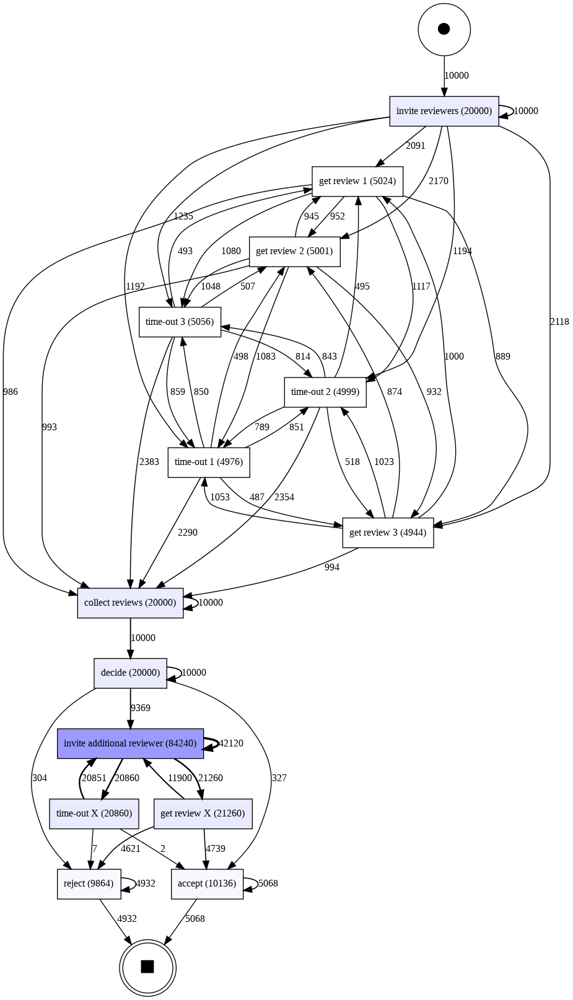

In [ ]:
dfg, start_activities, end_activities = pm4py.discover_dfg(xes_log)
pm4py.view_dfg(dfg, start_activities, end_activities)

**Visualization of DFG**


First, we have to import the log. Subsequently, we can extract the Directly-Follows Graph. In addition, code is provided to visualize the Directly-Follows Graph. This visualization is a colored visualization of the Directly-Follows graph that is decorated with the frequency of activities.


```
import os
import pm4py

if __name__ == "__main__":
    log = pm4py.read_xes(os.path.join("tests","input_data","running-example.xes"))
    dfg, start_activities, end_activities = pm4py.discover_dfg(log)
    pm4py.view_dfg(dfg, start_activities, end_activities)
```

To get a Directly-Follows graph decorated with the performance between the edges, two parameters of the previous code have to be replaced.
```
import os
import pm4py

if __name__ == "__main__":
    log = pm4py.read_xes(os.path.join("tests","input_data","running-example.xes"))
    performance_dfg, start_activities, end_activities = pm4py.discover_performance_dfg(log)
    pm4py.view_performance_dfg(performance_dfg, start_activities, end_activities)
```


To save the obtained DFG, for instance in the SVG format, code is also provided on the right-hand side.

```
import os
import pm4py

if __name__ == "__main__":
    log = pm4py.read_xes(os.path.join("tests","input_data","running-example.xes"))
    performance_dfg, start_activities, end_activities = pm4py.discover_performance_dfg(log)
    pm4py.save_vis_performance_dfg(performance_dfg, start_activities, end_activities, 'perf_dfg.svg')
```

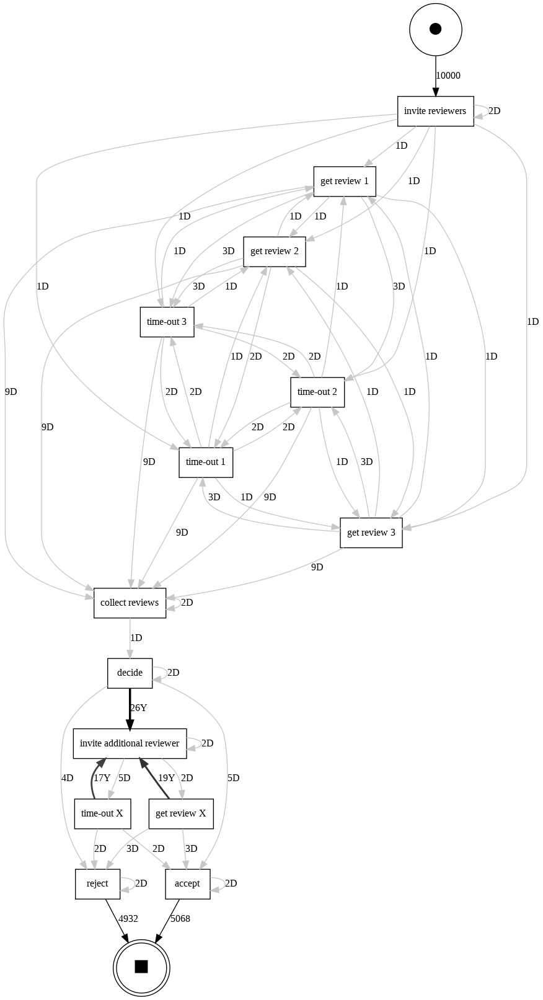

In [ ]:
performance_dfg, start_activities, end_activities = pm4py.discover_performance_dfg(xes_log)
pm4py.view_performance_dfg(performance_dfg, start_activities, end_activities)

**Heuristic Miner**

Heuristics Miner is an algorithm that acts on the Directly-Follows Graph, providing way to handle with noise and to find common constructs (dependency between two activities, AND). The output of the Heuristics Miner is an Heuristics Net, so an object that contains the activities and the relationships between them. The Heuristics Net can be then converted into a Petri net. 


To apply the Heuristics Miner to discover an Heuristics Net, it is necessary to import a log. Then, a Heuristic Net can be found. There are also numerous possible parameters that can be inspected by clicking on the following button.


Parameter name/ Meaning

1. dependency_threshold: dependency threshold of the Heuristics Miner (default: 0.5)
2. and_threshold: AND measure threshold of the Heuristics Miner (default: 0.65)
3. loop_two_threshold: thresholds for the loops of length 2 (default 0.5)

To obtain a Petri Net that is based on the Heuristics Miner, the code on the right hand side can be used. Also this Petri Net can be visualized.

```
    net, im, fm = pm4py.discover_petri_net_heuristics(log, dependency_threshold=0.99)]
    pm4py.view_petri_net(net, im, fm)
```

Steps
* Tries to learn from the DFG
* Tries to reason which acitivites are concurent
* Will NOT convert concurent activities
* creates a process map where CAUSAL RELATIONSHIP are present
* Removes concurency cycle




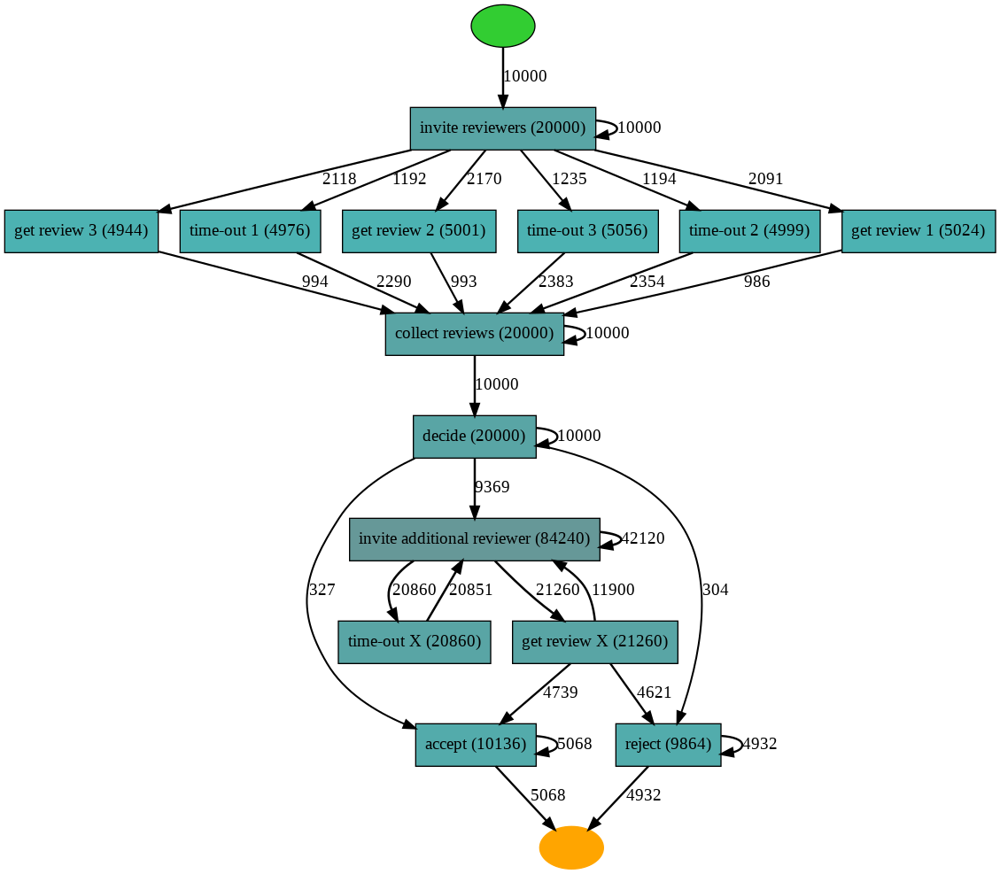

In [ ]:
map = pm4py.discover_heuristics_net(xes_log)
pm4py.view_heuristics_net(map)

### Statistics

In [ ]:
#case description
simple_ga_descritpion = duration_statistics_module.duration_statistics.cases_description(xes_log)
simple_ga_descritpion

{'1': {'startTime': 1136070000.0,
  'endTime': 1138402800.0,
  'caseDuration': 2332800.0},
 '10': {'startTime': 1139180400.0,
  'endTime': 1200524400.0,
  'caseDuration': 61344000.0},
 '100': {'startTime': 1175641200.0,
  'endTime': 2081026800.0,
  'caseDuration': 905385600.0},
 '1000': {'startTime': 1563231600.0,
  'endTime': 3840476400.0,
  'caseDuration': 2277244800.0},
 '10000': {'startTime': 5418054000.0,
  'endTime': 8505385200.0,
  'caseDuration': 3087331200.0},
 '1001': {'startTime': 1566342000.0,
  'endTime': 3416338800.0,
  'caseDuration': 1849996800.0},
 '1002': {'startTime': 1565650800.0,
  'endTime': 3982258800.0,
  'caseDuration': 2416608000.0},
 '1003': {'startTime': 1564700400.0,
  'endTime': 1671318000.0,
  'caseDuration': 106617600.0},
 '1004': {'startTime': 1561935600.0,
  'endTime': 4572457200.0,
  'caseDuration': 3010521600.0},
 '1005': {'startTime': 1565132400.0,
  'endTime': 3746991600.0,
  'caseDuration': 2181859200.0},
 '1006': {'startTime': 1562454000.0,
  'en

In [ ]:
#Gets all the case durations out of the log
simple_ga_case_duration = duration_statistics_module.duration_statistics.all_case_duration(xes_log)
simple_ga_case_duration

[604800.0,
 604800.0,
 604800.0,
 777600.0,
 777600.0,
 950400.0,
 950400.0,
 950400.0,
 950400.0,
 950400.0,
 950400.0,
 1036800.0,
 1036800.0,
 1036800.0,
 1036800.0,
 1036800.0,
 1036800.0,
 1036800.0,
 1036800.0,
 1123200.0,
 1123200.0,
 1123200.0,
 1123200.0,
 1123200.0,
 1123200.0,
 1123200.0,
 1123200.0,
 1209600.0,
 1209600.0,
 1209600.0,
 1209600.0,
 1209600.0,
 1209600.0,
 1209600.0,
 1209600.0,
 1209600.0,
 1209600.0,
 1209600.0,
 1296000.0,
 1296000.0,
 1296000.0,
 1296000.0,
 1296000.0,
 1296000.0,
 1296000.0,
 1296000.0,
 1296000.0,
 1296000.0,
 1296000.0,
 1296000.0,
 1382400.0,
 1382400.0,
 1382400.0,
 1382400.0,
 1382400.0,
 1382400.0,
 1382400.0,
 1382400.0,
 1382400.0,
 1382400.0,
 1382400.0,
 1382400.0,
 1382400.0,
 1382400.0,
 1382400.0,
 1382400.0,
 1382400.0,
 1382400.0,
 1382400.0,
 1382400.0,
 1382400.0,
 1468800.0,
 1468800.0,
 1468800.0,
 1468800.0,
 1468800.0,
 1468800.0,
 1468800.0,
 1468800.0,
 1468800.0,
 1468800.0,
 1468800.0,
 1468800.0,
 1468800.0,
 14

In [ ]:
simple_ga_median_case_duration = duration_statistics_module.duration_statistics.median_case_duration(xes_log)
print("Median case duration in second: ",simple_ga_median_case_duration, "second")
print("Median case duration in days: ",simple_ga_median_case_duration / 86400, "days")

Median case duration in second:  2654294400.0 second
Median case duration in days:  30721.0 days


### SNA

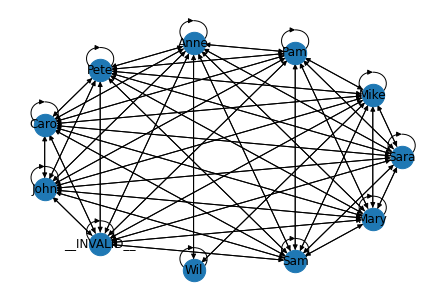

In [ ]:
handover_of_work = social_network_analysis_module.sna.handover_of_work(xes_log)

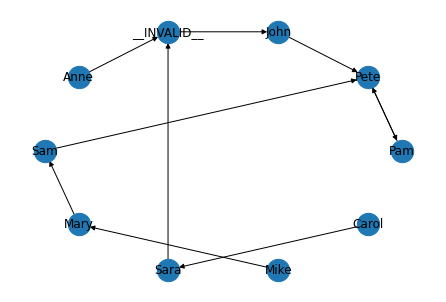

In [ ]:
subcontracting = social_network_analysis_module.sna.subcontracting(xes_log)

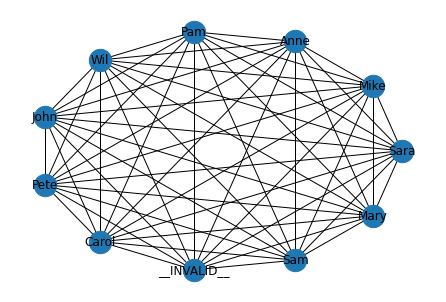

In [ ]:
working_together = social_network_analysis_module.sna.working_together(xes_log) 

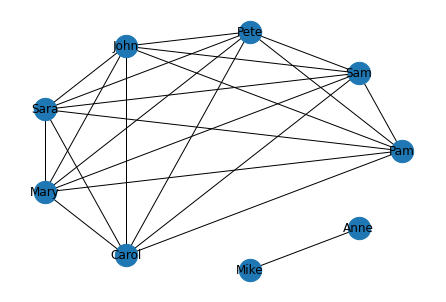

In [ ]:
similar_activities = social_network_analysis_module.sna.similar_activities(xes_log) 

In [ ]:
organizational_mining = social_network_analysis_module.sna.organizational_mining(xes_log) 


group_relative_focus
{'Mike': {'invite reviewers': 0.4975, 'get review 3': 0.0, 'get review 1': 0.0, 'time-out 2': 0.0, 'collect reviews': 0.5028, 'decide': 0.0, 'invite additional reviewer': 0.4985280151946819, 'get review X': 0.0, 'reject': 0.5097323600973236, 'time-out 1': 0.0, 'get review 2': 0.0, 'time-out X': 0.0, 'accept': 0.4984214680347277, 'time-out 3': 0.0}, 'Mary': {'invite reviewers': 0.0, 'get review 3': 0.14037216828478966, 'get review 1': 0.1429140127388535, 'time-out 2': 0.0, 'collect reviews': 0.0, 'decide': 0.0, 'invite additional reviewer': 0.0, 'get review X': 0.14313264346190027, 'reject': 0.0, 'time-out 1': 0.0, 'get review 2': 0.14397120575884823, 'time-out X': 0.0, 'accept': 0.0, 'time-out 3': 0.0}, 'Pam': {'invite reviewers': 0.0, 'get review 3': 0.14826051779935276, 'get review 1': 0.14709394904458598, 'time-out 2': 0.0, 'collect reviews': 0.0, 'decide': 0.0, 'invite additional reviewer': 0.0, 'get review X': 0.14167450611476953, 'reject': 0.0, 'time-out 1':

In [ ]:
clustering = social_network_analysis_module.sna.clustering(xes_log) 

clustered similar activities metric: {'1': ['John', 'Sam', 'Carol', 'Sara', 'Pam', 'Pete', 'Mary'], '0': ['__INVALID__', 'Anne', 'Wil', 'Mike']}
 working together clustered metric: {'2': ['John', 'Sam', 'Carol', 'Sara', 'Pam', 'Pete', 'Mary'], '0': ['__INVALID__'], '1': ['Anne'], '3': ['Wil'], '4': ['Mike']}


### EDA

<AxesSubplot: >

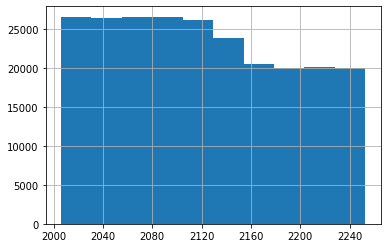

In [ ]:
df_log['time:timestamp'].hist()

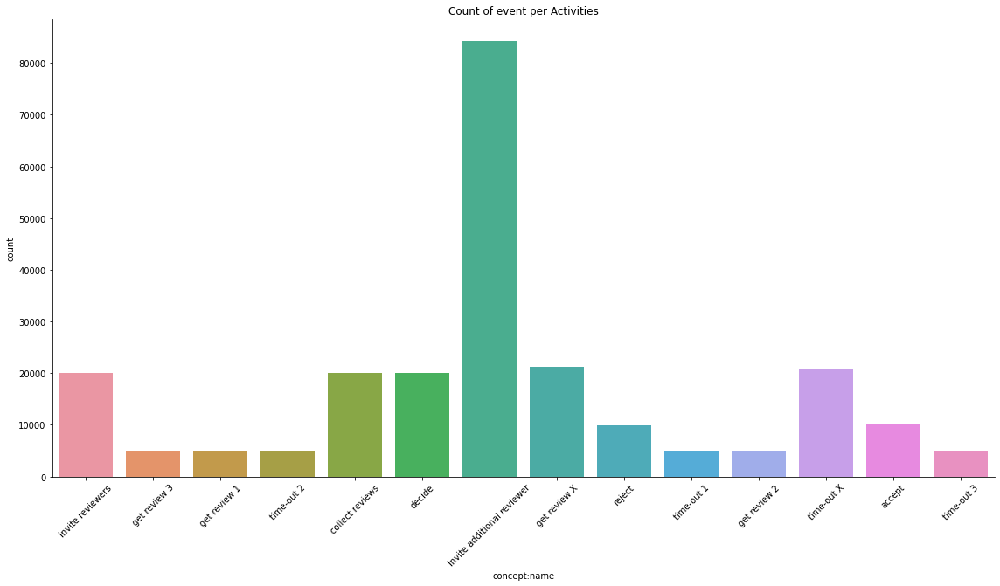

In [ ]:
fig = sns.catplot(x='concept:name', kind='count', data=df_log, height=8, aspect=2)
plt.xticks(rotation=45)
plt.title('Count of event per Activities')
plt.show(fig)

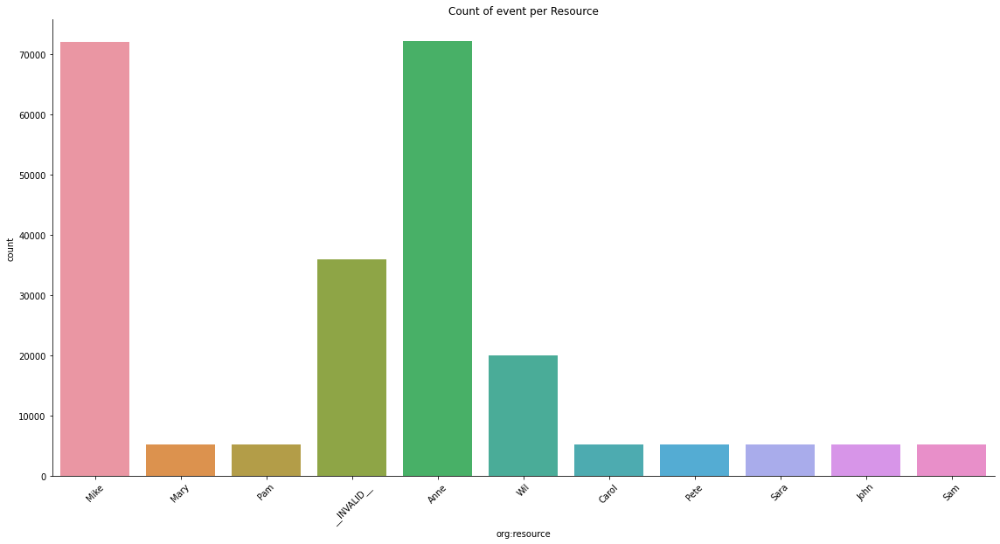

In [ ]:
fig = sns.catplot(x='org:resource', kind='count', data=df_log, height=8, aspect=2)
plt.xticks(rotation=45)
plt.title('Count of event per Resource')
plt.show(fig)

In [ ]:
activities = pm4py.get_event_attribute_values(df_log, "concept:name")
resources = pm4py.get_event_attribute_values(df_log, "org:resource")

In [ ]:
activities

{'invite additional reviewer': 84240,
 'get review X': 21260,
 'time-out X': 20860,
 'invite reviewers': 20000,
 'collect reviews': 20000,
 'decide': 20000,
 'accept': 10136,
 'reject': 9864,
 'time-out 3': 5056,
 'get review 1': 5024,
 'get review 2': 5001,
 'time-out 2': 4999,
 'time-out 1': 4976,
 'get review 3': 4944}

In [ ]:
resources

{'Anne': 72158,
 'Mike': 72082,
 '__INVALID__': 35891,
 'Wil': 20000,
 'Pete': 5233,
 'Sara': 5195,
 'Pam': 5180,
 'Mary': 5175,
 'John': 5157,
 'Carol': 5146,
 'Sam': 5143}

### VISPM https://github.com/AdamBanham/vispm

[StaticDottedChartPresentor] Processing event data... 
[StaticDottedChartPresentor] Cannot find concept:name in eventlog attributes. 
[StaticDottedChartPresentor] Ready to plot... 
[StaticDottedChartPresentor] Compiling finished...         
[StaticDottedChartPresentor] Plotting data... 
[StaticDottedChartPresentor] Cleaning up plot... 
[StaticDottedChartPresentor] Plot is ready to show... 


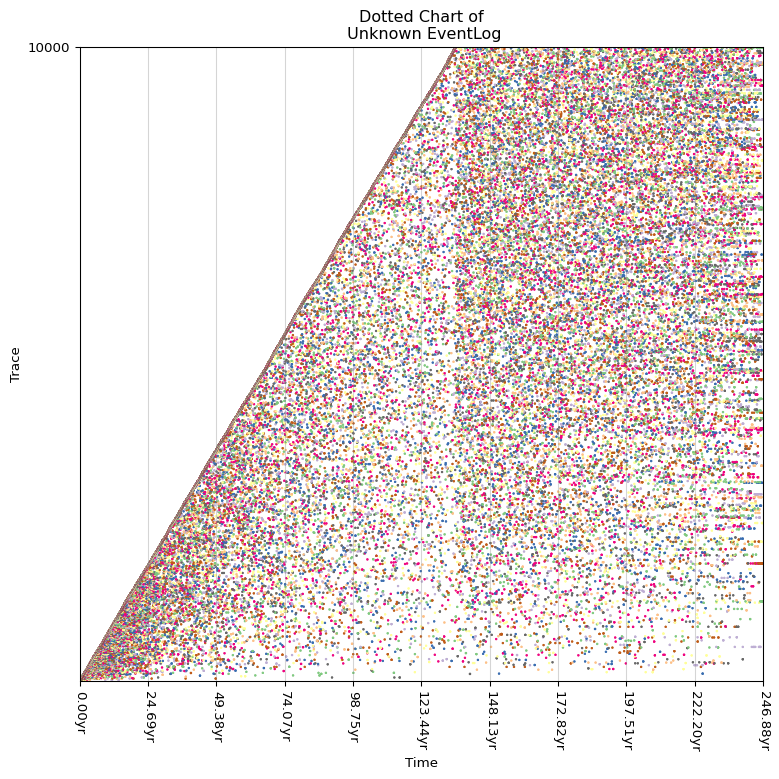

In [ ]:
# Static Presentors
from vispm import StaticDottedChartPresentor
from vispm.helpers.colours.colourmaps import HIGH_CONTRAST_COOL,HIGH_CONTRAST_WARM,EARTH,COOL_WINTER,CATEGORICAL
from matplotlib import pyplot as plt

presentor = StaticDottedChartPresentor(xes_log)
presentor.plot()
plt.show()

[StaticDottedChartPresentor] Processing event data... 
[StaticDottedChartPresentor] Cannot find concept:name in eventlog attributes. 
[StaticDottedChartPresentor] Ready to plot... 
[StaticDottedChartPresentor] Added extension : DottedColourHistogramExtension 
[StaticDottedChartPresentor] Added extension : DottedColourHistogramExtension 
[StaticDottedChartPresentor] Added extension : DottedColourHistogramExtension 
[StaticDottedChartPresentor] Added extension : DottedColourHistogramExtension 
[StaticDottedChartPresentor] Compiling finished...         
[StaticDottedChartPresentor] Plotting data... 
[DottedColourHistogramExtension] ploting histogram... 
[DottedColourHistogramExtension] ploting histogram... 
[DottedColourHistogramExtension] ploting histogram... 
[DottedColourHistogramExtension] ploting histogram... 
[StaticDottedChartPresentor] Cleaning up plot... 
[StaticDottedChartPresentor] Plot is ready to show... 


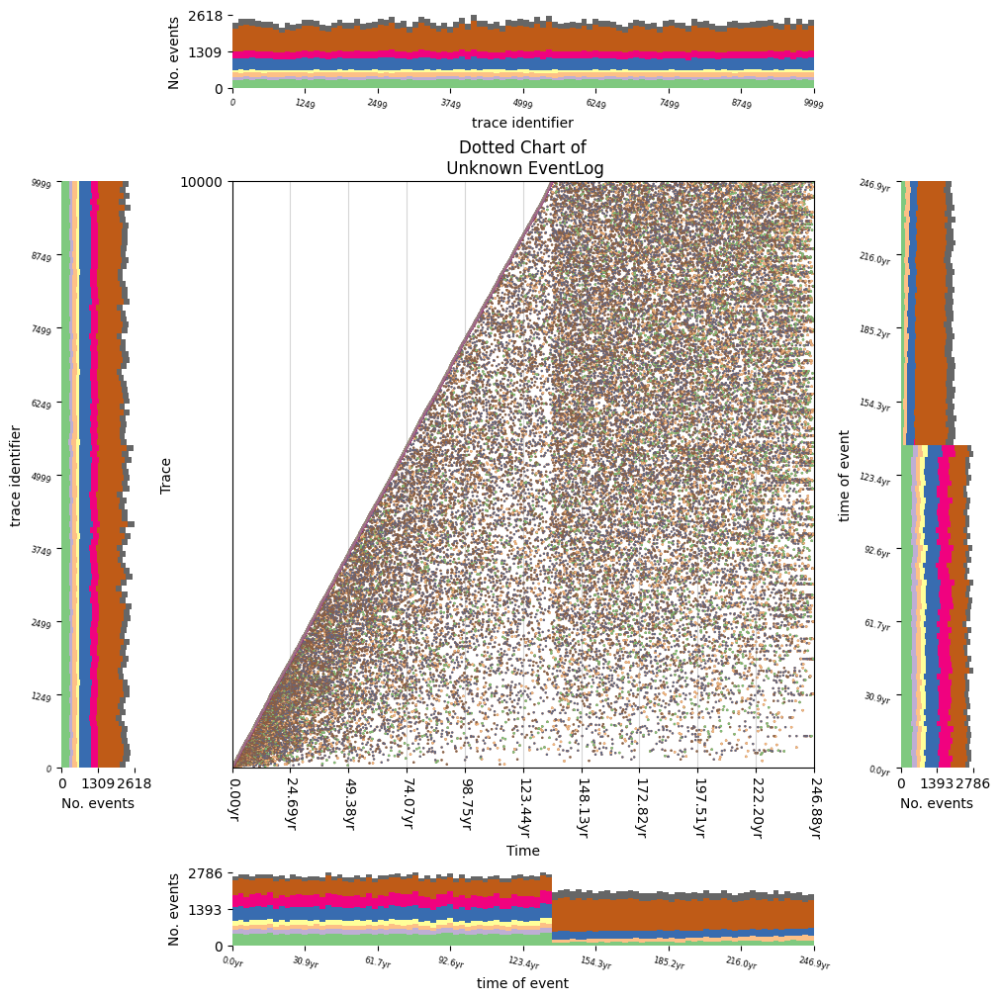

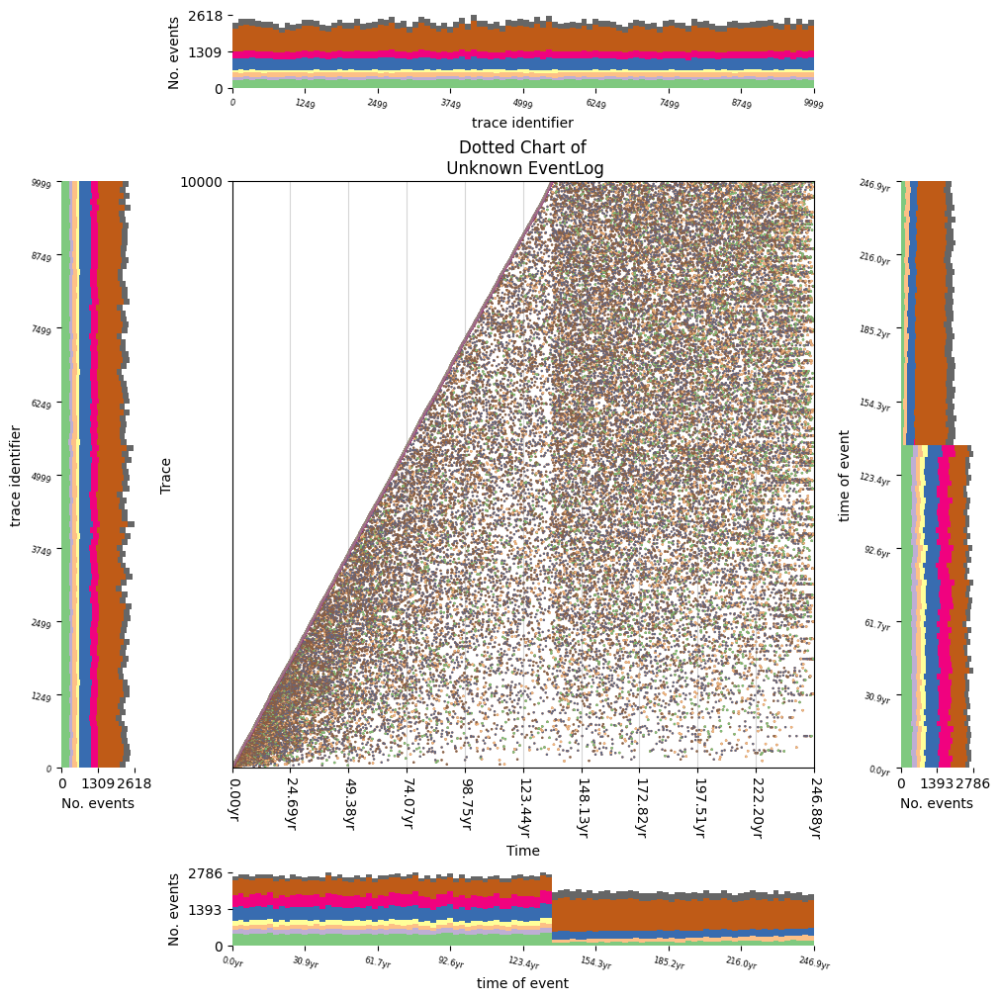

In [ ]:
# DottedColourHistogramExtension
#This extension plots a histogram based on the events within a dotted chart. Events will be broken down by colour for each bin.
from vispm import StaticDottedChartPresentor, DottedColourHistogramExtension
from vispm.helpers.colours.colourmaps import HIGH_CONTRAST_COOL,HIGH_CONTRAST_WARM,EARTH,COOL_WINTER,CATEGORICAL


presentor = StaticDottedChartPresentor(xes_log,dpi=100,
    event_colour_scheme=StaticDottedChartPresentor.EventColourScheme.EventLabel,
    colormap=CATEGORICAL
)
ext = DottedColourHistogramExtension(direction=DottedColourHistogramExtension.Direction.NORTH)
presentor.add_extension(ext)
ext = DottedColourHistogramExtension(direction=DottedColourHistogramExtension.Direction.SOUTH,
         bin_axes=DottedColourHistogramExtension.PlotAxes.X)
presentor.add_extension(ext)
ext = DottedColourHistogramExtension(direction=DottedColourHistogramExtension.Direction.WEST)
presentor.add_extension(ext)
ext = DottedColourHistogramExtension(direction=DottedColourHistogramExtension.Direction.EAST,
         bin_axes=DottedColourHistogramExtension.PlotAxes.X)
presentor.add_extension(ext)
presentor.plot()

[StaticDottedChartPresentor] Processing event data... 
[StaticDottedChartPresentor] Cannot find concept:name in eventlog attributes. 
[StaticDottedChartPresentor] Ready to plot... 
[StaticDottedChartPresentor] Added extension : DottedEventHistogramExtension 
[StaticDottedChartPresentor] Added extension : DottedEventHistogramExtension 
[StaticDottedChartPresentor] Added extension : DottedEventHistogramExtension 
[StaticDottedChartPresentor] Added extension : DottedEventHistogramExtension 
[StaticDottedChartPresentor] Compiling finished...         
[StaticDottedChartPresentor] Plotting data... 
[DottedEventHistogramExtension] ploting histogram... 
[DottedEventHistogramExtension] Event labels are imputed as :: {'invite reviewers': 'A', 'get review 2': 'B', 'get review 3': 'C', 'get review 1': 'D', 'time-out 1': 'E', 'time-out 3': 'F', 'time-out 2': 'G', 'collect reviews': 'H', 'decide': 'I', 'invite additional reviewer': 'J', 'get review X': 'K', 'time-out X': 'L', 'reject': 'M', 'accept'

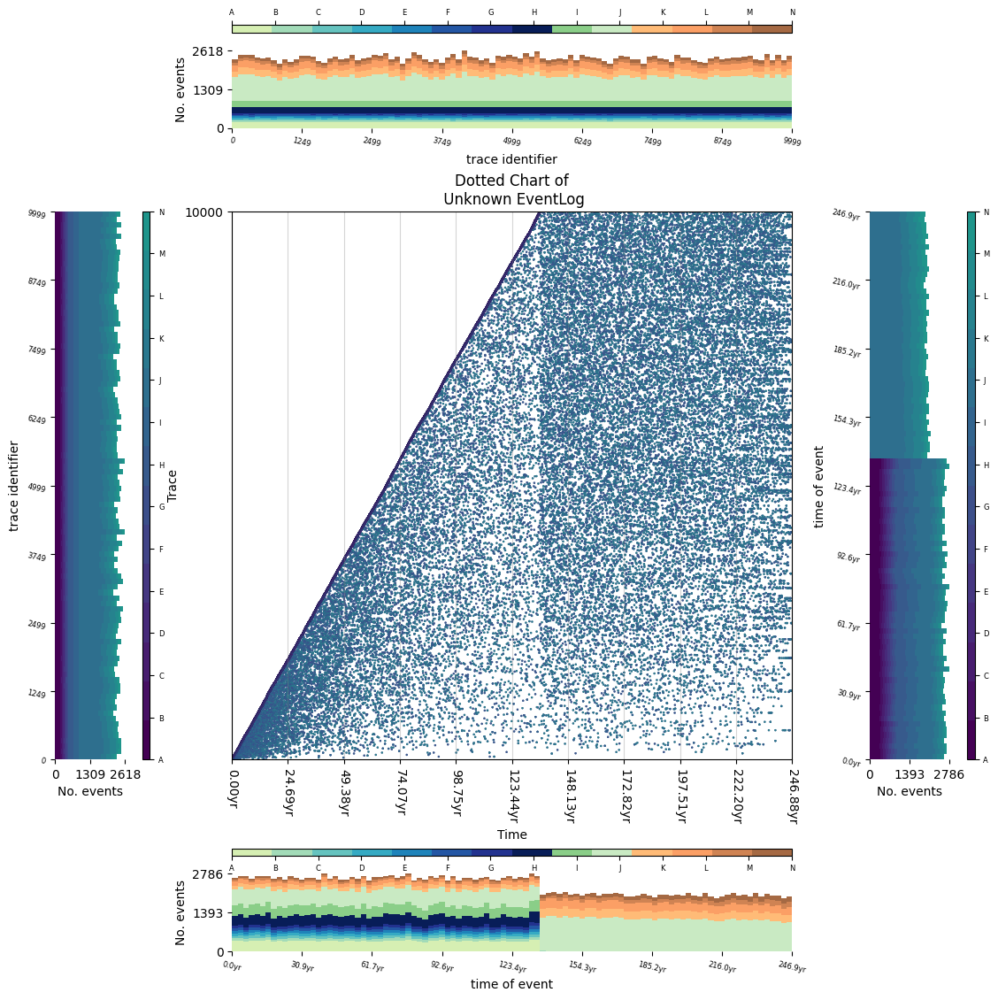

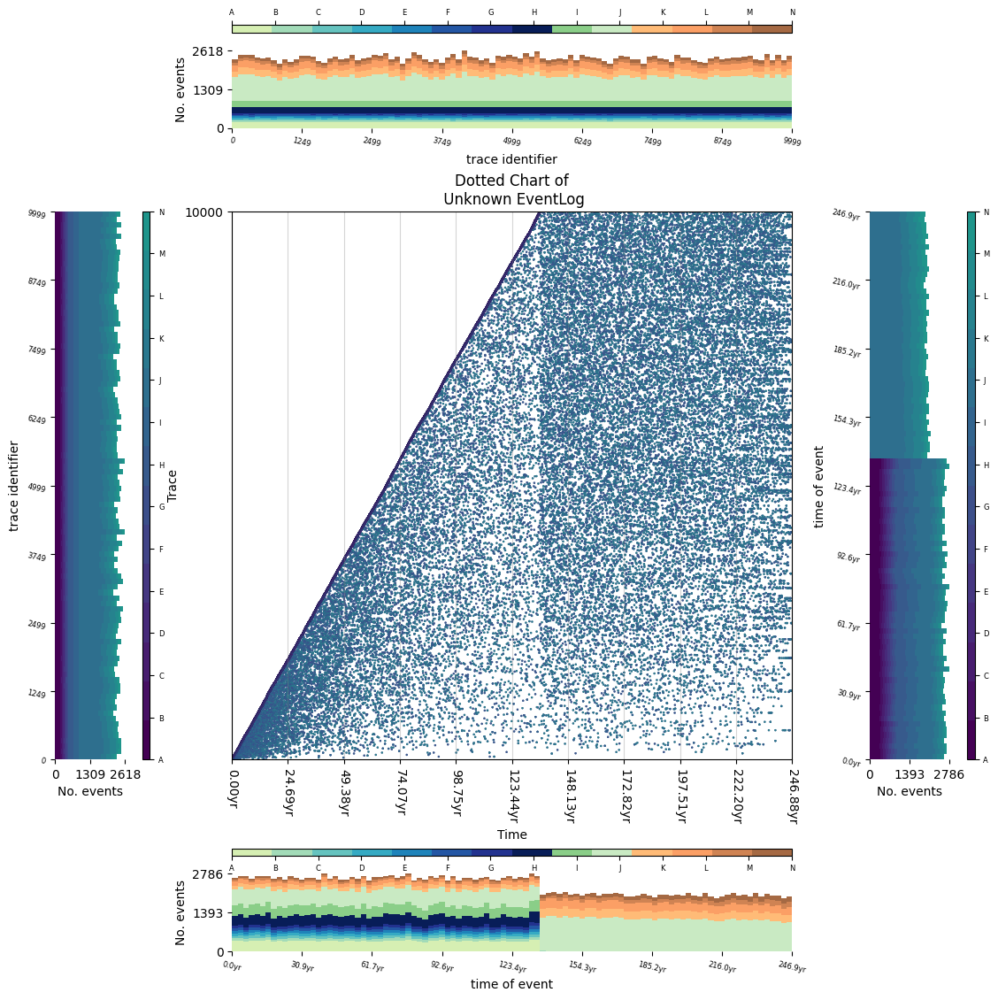

In [ ]:
# 1. setup up colour schemes to use
from vispm import StaticDottedChartPresentor, DottedColourHistogramExtension, DottedEventHistogramExtension
from vispm.helpers.colours.colourmaps import HIGH_CONTRAST_COOL,HIGH_CONTRAST_WARM
from vispm.helpers.colours.colourmaps import EARTH,COOL_WINTER
from vispm import StaticDottedChartPresentor,DottedColourHistogramExtension

import numpy as np
from matplotlib.colors import ListedColormap
from matplotlib.cm import get_cmap

colourmaps = [COOL_WINTER,EARTH,HIGH_CONTRAST_COOL,HIGH_CONTRAST_WARM]
seq_colourmap = np.vstack(
    (
    colourmaps[0](np.linspace(0.20,1,8)),
    colourmaps[1](np.linspace(0.20,1,8)),
    colourmaps[2](np.linspace(0.20,1,8)),
    colourmaps[3](np.linspace(0.20,1,8))
    
    )
)
seq_colourmap = ListedColormap(seq_colourmap, name='VARIANCE')
cmap = get_cmap(HIGH_CONTRAST_COOL, 26)


# 2. create a presentor and add extensions
presentor = StaticDottedChartPresentor(xes_log,dpi=100,
    event_colour_scheme=StaticDottedChartPresentor.EventColourScheme.EventLabel,
    colormap=cmap
)

ext = DottedEventHistogramExtension(
    direction=DottedEventHistogramExtension.Direction.SOUTH,
    bin_axes=DottedEventHistogramExtension.PlotAxes.X,
    colourmap=seq_colourmap
)
presentor.add_extension(ext)
ext = DottedEventHistogramExtension(
    direction=DottedEventHistogramExtension.Direction.NORTH,
    bin_axes=DottedEventHistogramExtension.PlotAxes.Y,
    colourmap=seq_colourmap
)
presentor.add_extension(ext)
ext = DottedEventHistogramExtension(
    direction=DottedEventHistogramExtension.Direction.WEST,
    bin_axes=DottedEventHistogramExtension.PlotAxes.Y,
    colourmap=cmap
)
presentor.add_extension(ext)
ext = DottedEventHistogramExtension(
    direction=DottedEventHistogramExtension.Direction.EAST,
    bin_axes=DottedEventHistogramExtension.PlotAxes.X,
    colourmap=cmap
)
presentor.add_extension(ext)

presentor.plot()

[StaticDottedChartPresentor] Processing event data... 
[StaticDottedChartPresentor] Cannot find concept:name in eventlog attributes. 
[StaticDottedChartPresentor] Ready to plot... 
[StaticDottedChartPresentor] Added extension : DottedEventHistogramExtension 
[StaticDottedChartPresentor] Added extension : DottedEventHistogramExtension 
[StaticDottedChartPresentor] Added extension : DottedEventHistogramExtension 
[StaticDottedChartPresentor] Added extension : DottedEventHistogramExtension 
[StaticDottedChartPresentor] Compiling finished...         
[StaticDottedChartPresentor] Plotting data... 
[DottedEventHistogramExtension] ploting histogram... 
[DottedEventHistogramExtension] Event labels are imputed as :: {'invite reviewers': 'A', 'get review 2': 'B', 'get review 3': 'C', 'get review 1': 'D', 'time-out 1': 'E', 'time-out 3': 'F', 'time-out 2': 'G', 'collect reviews': 'H', 'decide': 'I', 'invite additional reviewer': 'J', 'get review X': 'K', 'time-out X': 'L', 'reject': 'M', 'accept'

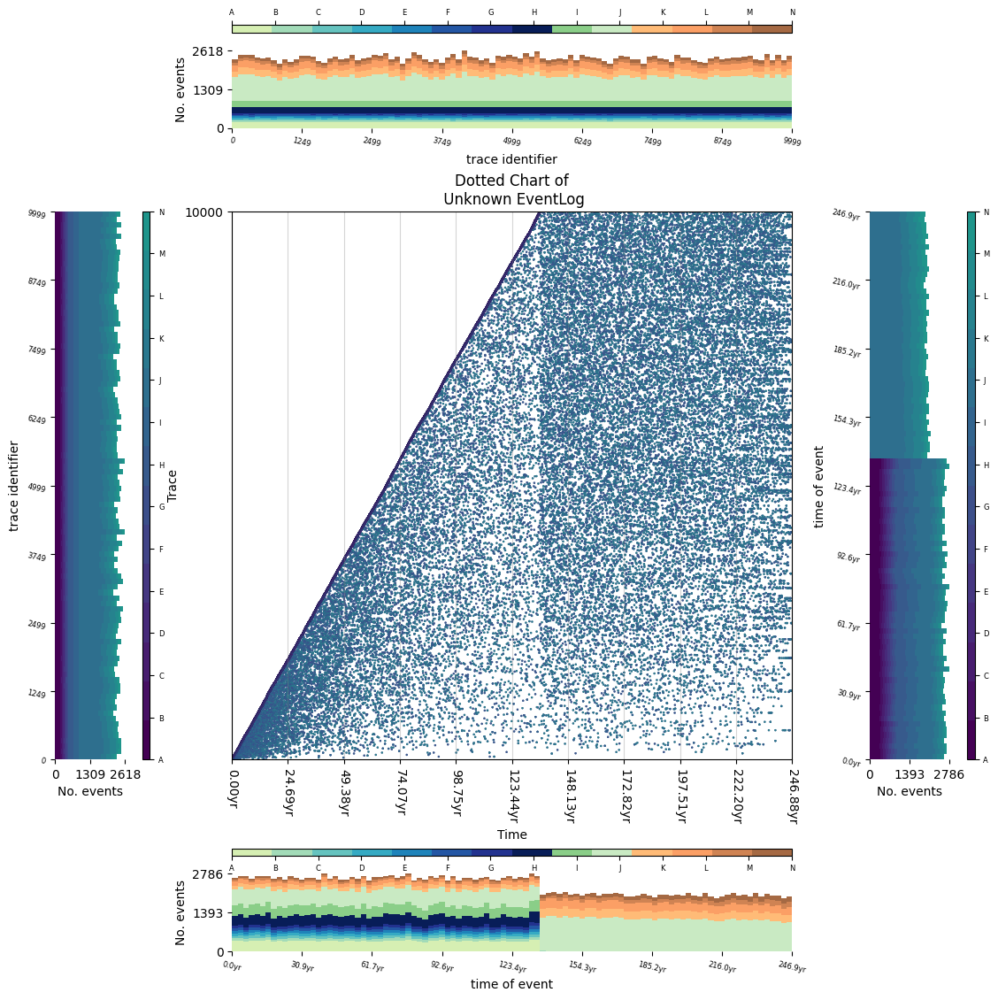

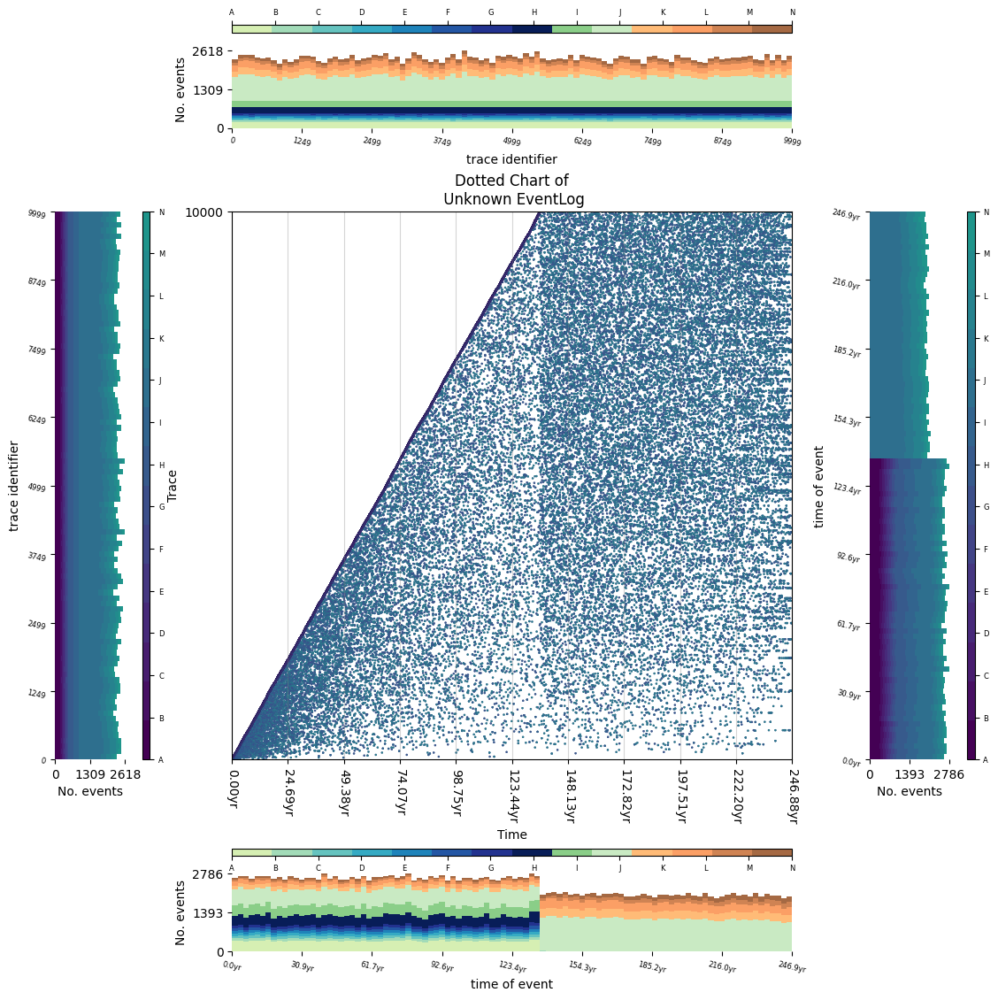

In [ ]:
# 1. setup up colour schemes to use
from vispm import StaticDottedChartPresentor, DottedColourHistogramExtension, DottedEventHistogramExtension
from vispm.helpers.colours.colourmaps import HIGH_CONTRAST_COOL,HIGH_CONTRAST_WARM,EARTH,COOL_WINTER,CATEGORICAL
from vispm import StaticDottedChartPresentor,DottedColourHistogramExtension

import numpy as np
from matplotlib.colors import ListedColormap
from matplotlib.cm import get_cmap

colourmaps = [COOL_WINTER,EARTH,HIGH_CONTRAST_COOL,HIGH_CONTRAST_WARM, CATEGORICAL]
seq_colourmap = np.vstack(
    (
    colourmaps[0](np.linspace(0.20,1,8)),
    colourmaps[1](np.linspace(0.20,1,8)),
    colourmaps[2](np.linspace(0.20,1,8)),
    colourmaps[3](np.linspace(0.20,1,8)),
    colourmaps[4](np.linspace(0.20,1,8))
    
    )
)
seq_colourmap = ListedColormap(seq_colourmap, name='VARIANCE')
cmap = get_cmap(HIGH_CONTRAST_COOL, 26)


# 2. create a presentor and add extensions
presentor = StaticDottedChartPresentor(xes_log,dpi=100,
    event_colour_scheme=StaticDottedChartPresentor.EventColourScheme.EventLabel,
    colormap=cmap
)

ext = DottedEventHistogramExtension(
    direction=DottedEventHistogramExtension.Direction.SOUTH,
    bin_axes=DottedEventHistogramExtension.PlotAxes.X,
    colourmap=seq_colourmap
)
presentor.add_extension(ext)
ext = DottedEventHistogramExtension(
    direction=DottedEventHistogramExtension.Direction.NORTH,
    bin_axes=DottedEventHistogramExtension.PlotAxes.Y,
    colourmap=seq_colourmap
)
presentor.add_extension(ext)
ext = DottedEventHistogramExtension(
    direction=DottedEventHistogramExtension.Direction.WEST,
    bin_axes=DottedEventHistogramExtension.PlotAxes.Y,
    colourmap=cmap
)
presentor.add_extension(ext)
ext = DottedEventHistogramExtension(
    direction=DottedEventHistogramExtension.Direction.EAST,
    bin_axes=DottedEventHistogramExtension.PlotAxes.X,
    colourmap=cmap
)
presentor.add_extension(ext)

presentor.plot()

[StaticDottedChartPresentor] Processing event data... 
[StaticDottedChartPresentor] Cannot find concept:name in eventlog attributes. 
[StaticDottedChartPresentor] Ready to plot... 
[StaticDottedChartPresentor] Added extension : DescriptionHistogramExtension 
[StaticDottedChartPresentor] Added extension : DescriptionHistogramExtension 
[StaticDottedChartPresentor] Added extension : DescriptionHistogramExtension 
[StaticDottedChartPresentor] Added extension : DescriptionHistogramExtension 
[StaticDottedChartPresentor] Compiling finished...         
[StaticDottedChartPresentor] Plotting data... 
[DescriptionHistogramExtension] plotting histogram 
[DescriptionHistogramExtension] Event labels are imputed as :: {'invite reviewers': 'A', 'get review 2': 'B', 'get review 3': 'C', 'get review 1': 'D', 'time-out 1': 'E', 'time-out 3': 'F', 'time-out 2': 'G', 'collect reviews': 'H', 'decide': 'I', 'invite additional reviewer': 'J', 'get review X': 'K', 'time-out X': 'L', 'reject': 'M', 'accept': 

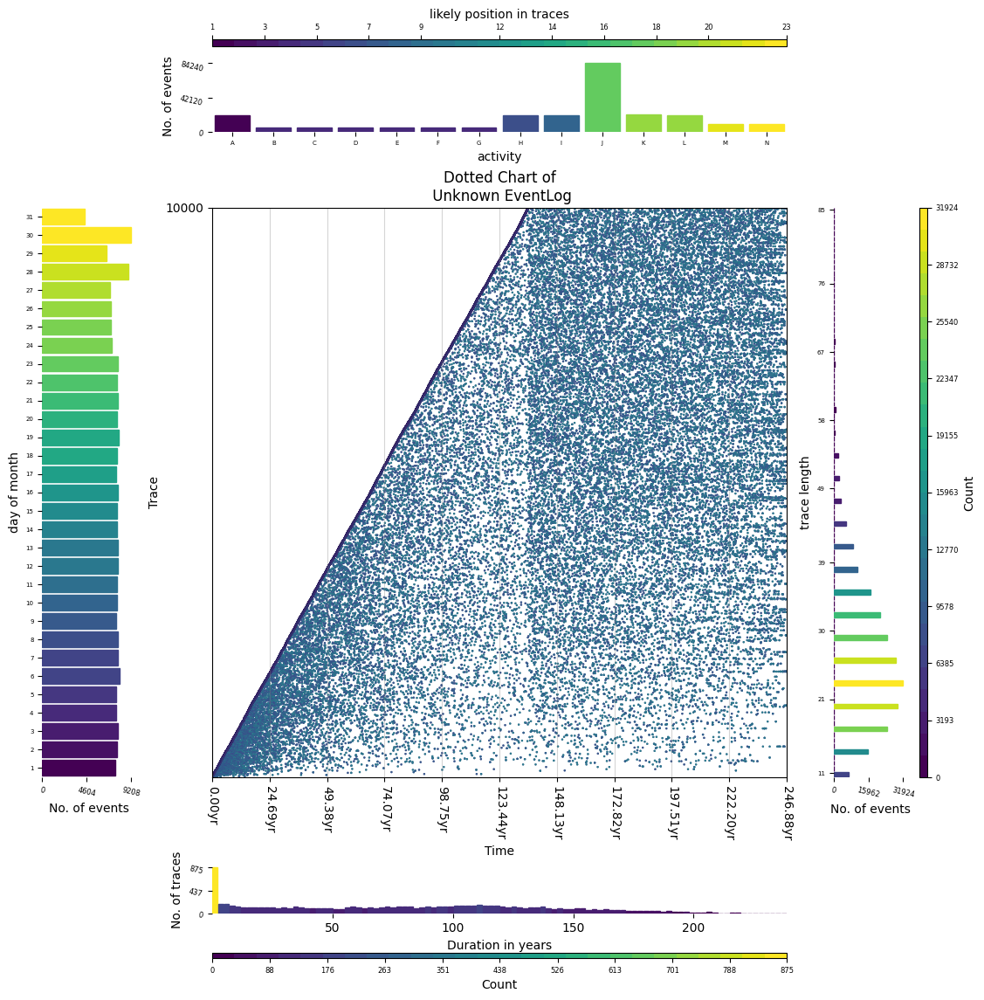

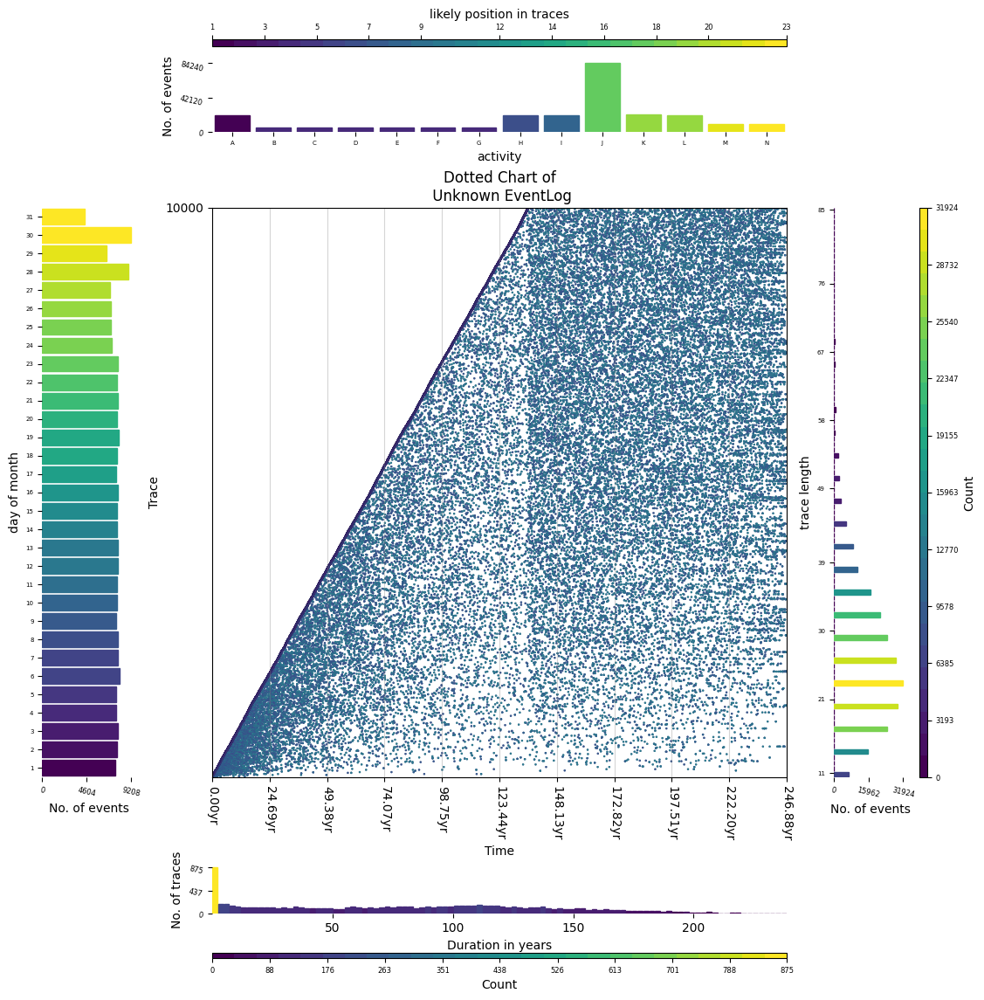

In [ ]:
#DescriptionHistogramExtension
#This extension describes an aspect of the event log.
# For example, a breakdown of trace duration, or trace length (by the number of activities), or event label, or when events occur (weekday or monthday).

#The following example shows how to use this extension to understand the properties of event log, alongside a dotted chart.


from vispm import DescriptionHistogramExtension
from vispm.helpers.colours.colourmaps import HIGH_CONTRAST_COOL,HIGH_CONTRAST_WARM,EARTH,COOL_WINTER,CATEGORICAL
from vispm import StaticDottedChartPresentor,DottedColourHistogramExtension


cmap = get_cmap(HIGH_CONTRAST_COOL, 26)
presentor = StaticDottedChartPresentor(xes_log,dpi=100,
    event_colour_scheme=StaticDottedChartPresentor.EventColourScheme.EventLabel,
    colormap=cmap
)

ext = DescriptionHistogramExtension(
)
presentor.add_extension(ext)

ext = DescriptionHistogramExtension(
    direction=DescriptionHistogramExtension.Direction.EAST,
    describe=DescriptionHistogramExtension.Describe.TraceLength,
    density=DescriptionHistogramExtension.Density.Event
)
presentor.add_extension(ext)

ext = DescriptionHistogramExtension(
    direction=DescriptionHistogramExtension.Direction.SOUTH,
    describe=DescriptionHistogramExtension.Describe.TraceDuration,
    density=DescriptionHistogramExtension.Density.Trace
)
presentor.add_extension(ext)

ext = DescriptionHistogramExtension(
    direction=DescriptionHistogramExtension.Direction.WEST,
    describe=DescriptionHistogramExtension.Describe.Monthday,
    density=DescriptionHistogramExtension.Density.Event
)
presentor.add_extension(ext)

presentor.plot()

## HelpDesk Dataset

** Cleaned Dataset**
Previously, I manually cleaned the dataset in term of user invovled so the imported dataset used is already cleaned for observation

The following code was used to replace the "org:resource" by generating a random fake name trough the Faker module for each unique value 



```
#create fake name for each of the 'org:resource' attribute since 
from faker import Faker
import random

faker = Faker()
names = [faker.name() for i in range(22)]
HelpDesk_log['name'] = [random.choice(names) for i in HelpDesk_log['org:resource']]
HelpDesk_log['org:resource'] = HelpDesk_log['name']
HelpDesk_log.drop('name', axis=1)
```



In [ ]:
HelpDesk = '/content/drive/MyDrive/Abou Keita - Capstone 606/Datasets/cleaned_HelpDesk_log.xes'
df_log = pm4py.read_xes(HelpDesk)

parsing log, completed traces ::   0%|          | 0/4580 [00:00<?, ?it/s]

Get starting and ending activities

In [ ]:
xes_start_activites = pm4py.get_start_activities(df_log)
xes_end_activites = pm4py.get_end_activities(df_log)
print("starting activity: {} \n ending activity: {}".format(xes_start_activites, xes_end_activites))

starting activity: {'Assign seriousness': 4384, 'Insert ticket': 118, 'Take in charge ticket': 74, 'Resolve ticket': 2, 'Create SW anomaly': 1, 'Wait': 1} 
 ending activity: {'Closed': 4557, 'Resolve ticket': 10, 'Wait': 8, 'Require upgrade': 3, 'VERIFIED': 1, 'Take in charge ticket': 1}


DataFrame

In [ ]:
df_log

,concept:name,lifecycle:transition,org:resource,time:timestamp,Activity,Resource,name,case:concept:name,case:variant,case:variant-index,case:creator
0,Assign seriousness,complete,Kelly Williams,2012-10-09 11:50:17+00:00,Assign seriousness,Value 1,Kelly Williams,Case1,Variant 12,12,Fluxicon Disco
1,Take in charge ticket,complete,Angelica Smith,2012-10-09 11:51:01+00:00,Take in charge ticket,Value 1,Angelica Smith,Case1,Variant 12,12,Fluxicon Disco
2,Take in charge ticket,complete,James Rogers,2012-10-12 12:02:56+00:00,Take in charge ticket,Value 2,James Rogers,Case1,Variant 12,12,Fluxicon Disco
3,Resolve ticket,complete,Martin Burton,2012-10-25 08:54:26+00:00,Resolve ticket,Value 1,Martin Burton,Case1,Variant 12,12,Fluxicon Disco
4,Closed,complete,James Rogers,2012-11-09 10:54:39+00:00,Closed,Value 3,James Rogers,Case1,Variant 12,12,Fluxicon Disco
...,...,...,...,...,...,...,...,...,...,...,...
21343,Closed,complete,Wendy Thompson,2010-09-02 07:11:00+00:00,Closed,Value 5,Wendy Thompson,Case4579,Variant 1,1,Fluxicon Disco
21344,Take in charge ticket,complete,Jennifer Young,2012-01-03 07:33:43+00:00,Take in charge ticket,Value 6,Jennifer Young,Case4580,Variant 18,18,Fluxicon Disco
21345,Wait,complete,Mark Valencia,2012-01-10 13:30:11+00:00,Wait,Value 6,Mark Valencia,Case4580,Variant 18,18,Fluxicon Disco
21346,Resolve ticket,complete,Angelica Smith,2012-01-10 15:07:40+00:00,Resolve ticket,Value 6,Angelica Smith,Case4580,Variant 18,18,Fluxicon Disco


In [ ]:
df_log.columns

Index(['concept:name', 'lifecycle:transition', 'org:resource',
       'time:timestamp', 'Activity', 'Resource', 'name', 'case:concept:name',
       'case:variant', 'case:variant-index', 'case:creator'],
      dtype='object')

In [ ]:
num_event = len(df_log)
num_cases = len(df_log['case:concept:name'].unique())
print("number of event: {} \n Number of unique cases: {}".format(num_event, num_cases))

number of event: 21348 
 Number of unique cases: 4580


In [ ]:
df_log['org:resource'].unique()

array(['Kelly Williams', 'Angelica Smith', 'James Rogers',
       'Martin Burton', 'Bradley Acosta', 'Richard Perry',
       'Ricardo Parker', 'Megan Ortiz', 'Mark Valencia',
       'Nicholas Fowler', 'Angela Kirk', 'Linda Brooks', 'Kristin Burton',
       'Wendy Thompson', 'Olivia Henry', 'James Cole', 'John Nichols',
       'Jennifer Young', 'Omar Collins', 'Alex Haley', 'Donna Pearson',
       'Michelle Glenn'], dtype=object)

In [ ]:
#the unique activies taking places in the log
df_log['concept:name'].nunique()

14

**Inductive Miner**

In PM4Py, we offer an implementation of the inductive miner (IM), of the inductive miner infrequent (IMf), and of the inductive miner directly-follows (IMd) algorithm. The papers describing the approaches are the following:

Inductive Miner: Discovering block-structured process models from event logs-a constructive approach
Inductive Miner infrequent: Discovering block-structured process models from event logs containing infrequent behaviour
Inductive Miner directly-follows Scalable process discovery with guarantees
The basic idea of Inductive Miner is about detecting a 'cut' in the log (e.g. sequential cut, parallel cut, concurrent cut and loop cut) and then recur on sublogs, which were found applying the cut, until a base case is found. The Directly-Follows variant avoids the recursion on the sublogs but uses the Directly Follows graph.

Inductive miner models usually make extensive use of hidden transitions, especially for skipping/looping on a portion on the model. Furthermore, each visible transition has a unique label (there are no transitions in the model that share the same label). \n

https://pm4py.fit.fraunhofer.de/documentation#discovery


In [ ]:
xes_log = pm4py.convert_to_event_log(df_log)

/usr/local/lib/python3.8/dist-packages/pm4py/utils.py:486: UserWarning: the EventLog class has been deprecated and will be removed in a future release.
  warnings.warn("the EventLog class has been deprecated and will be removed in a future release.")


**BPMN model**

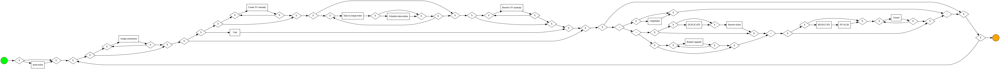

In [ ]:
bpmn_model = pm4py.discover_bpmn_inductive(xes_log)
pm4py.view_bpmn(bpmn_model)

**Process Trees**

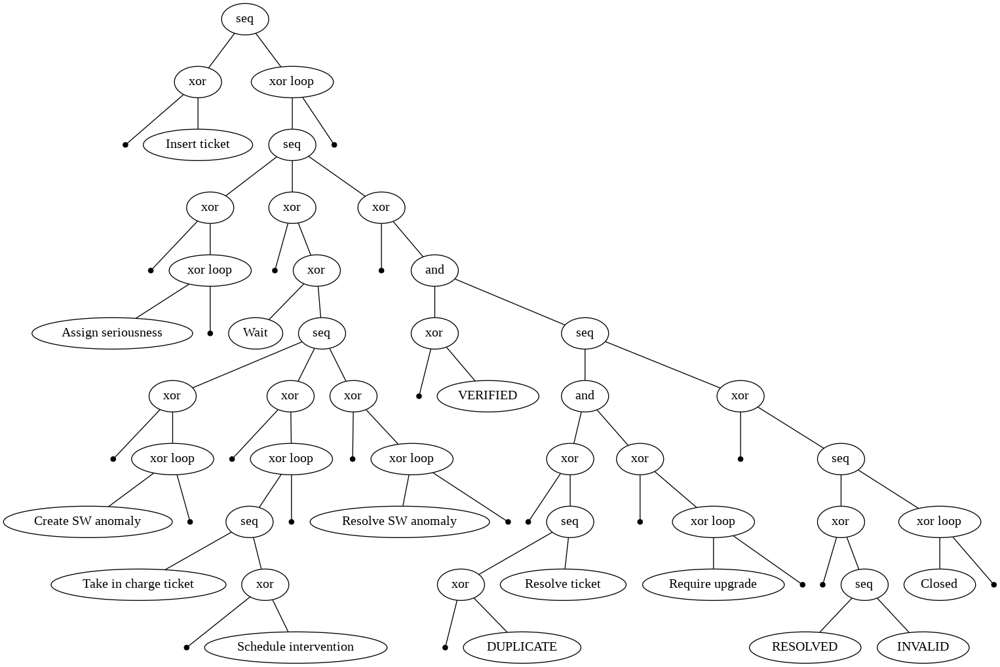

In [ ]:
process_tree = pm4py.discover_process_tree_inductive(xes_log)
pm4py.view_process_tree(process_tree)

**Petri Nets**: To mine a Petri Net 

A log is read, the inductive miner is applied and the Petri net along with the initial and the final marking are found. First, the log is read, then the inductive miner algorithm is applied.

Can also accepts a process tree as input

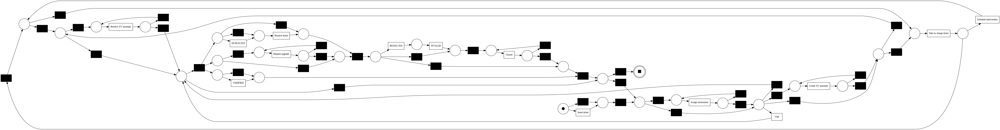

In [ ]:
net, initial_marking, final_marking = pm4py.discover_petri_net_inductive(xes_log)
pm4py.view_petri_net(net, initial_marking, final_marking)

**Alpha Miner**

The alpha miner is one of the most known Process Discovery algorithm and is able to find:

A Petri net model where all the transitions are visible and unique and correspond to classified events (for example, to activities).
An initial marking that describes the status of the Petri net model when a execution starts.
A final marking that describes the status of the Petri net model when a execution ends.

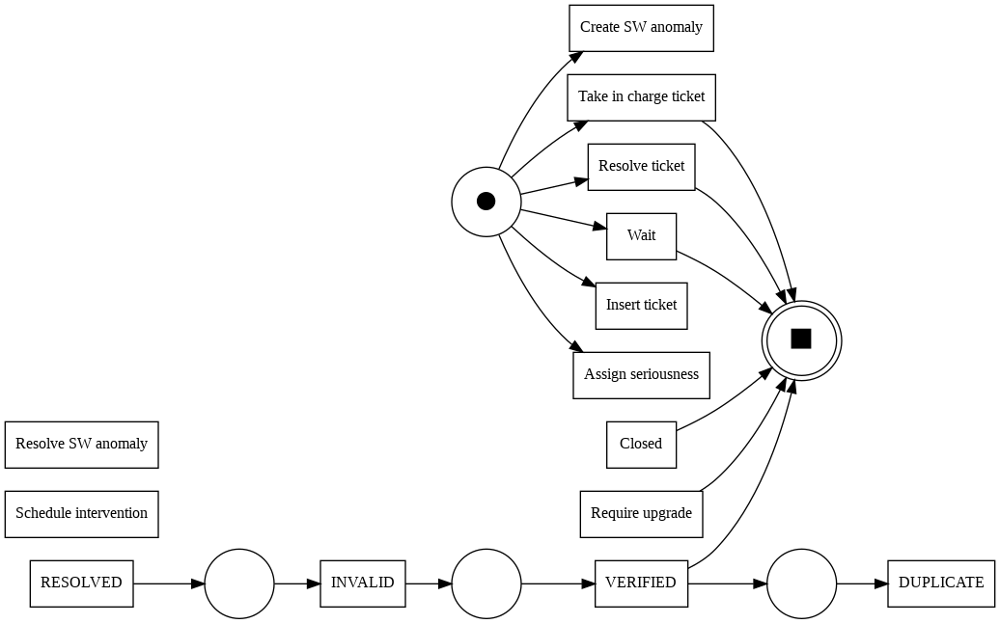

In [ ]:
net1, im1, fm1 = pm4py.discover_petri_net_alpha(xes_log)
pm4py.view_petri_net(net1, im1, fm1)

**Alpha Miner Plus**

a. not good at finding "invisble" transition

b. can be problamatic

<ipython-input-131-d2afa5897a15>:1: DeprecatedWarning: discover_petri_net_alpha_plus is deprecated as of 2.3.0 and will be removed in 3.0.0. this method will be removed in a future release.
  net2, im2, fm2 = pm4py.discover_petri_net_alpha_plus(xes_log)


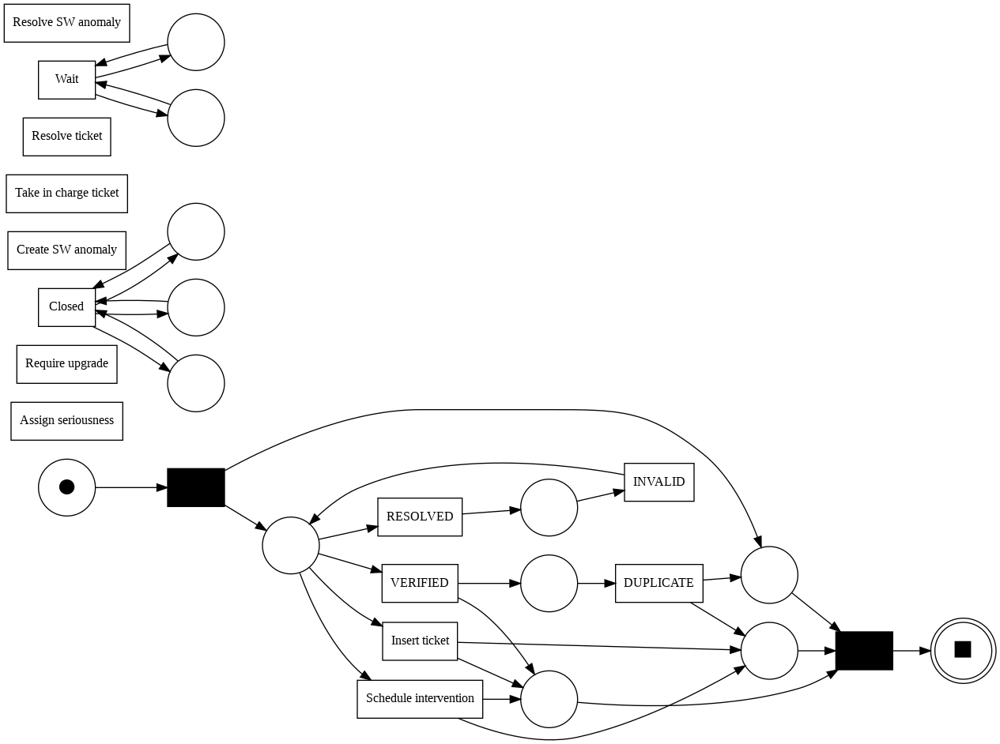

In [ ]:
net2, im2, fm2 = pm4py.discover_petri_net_alpha_plus(xes_log)
pm4py.view_petri_net(net2, im2, fm2)

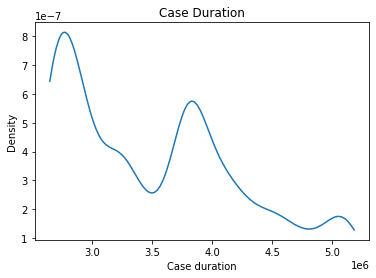

In [ ]:
pm4py.view_case_duration_graph(xes_log)

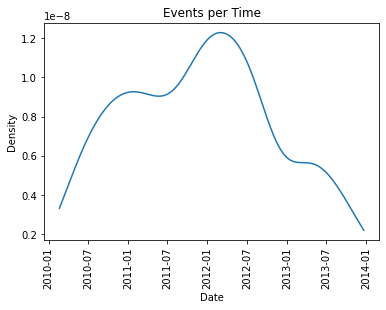

In [ ]:
pm4py.vis.view_events_per_time_graph(xes_log)

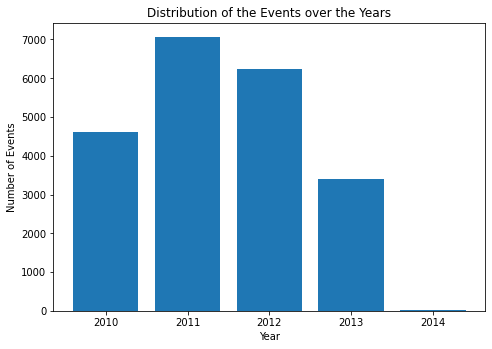

In [ ]:
pm4py.vis.view_events_distribution_graph(xes_log, distr_type= 'years', activity_key='concept:name', case_id_key='case:concept:name', timestamp_key='time:timestamp')

**Directly-Follows Graph**

<ipython-input-135-e14e9b39e739>:1: DeprecatedWarning: discover_dfg is deprecated as of 2.3.0 and will be removed in 2.4.0. this method will be replaced by the discover_dfg_typed function(). Please adapt your code to use pm4py.discover_dfg_typed()
  dfg, start_activities, end_activities = pm4py.discover_dfg(xes_log)


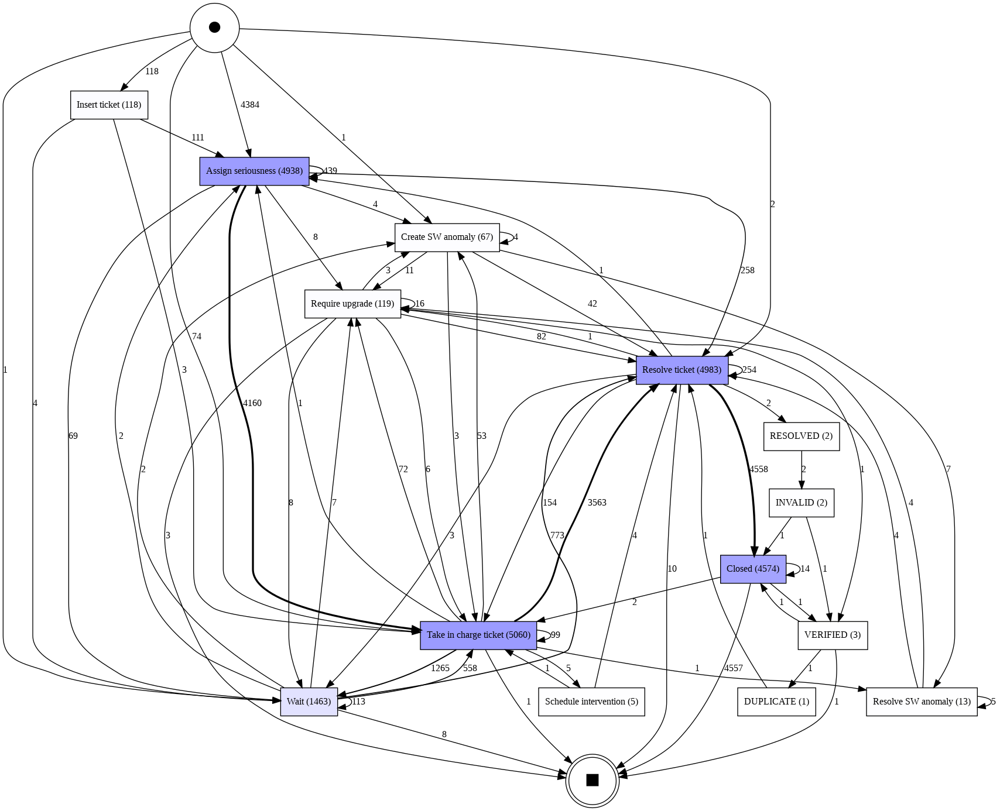

In [ ]:
dfg, start_activities, end_activities = pm4py.discover_dfg(xes_log)
pm4py.view_dfg(dfg, start_activities, end_activities)

**Visualization of DFG**

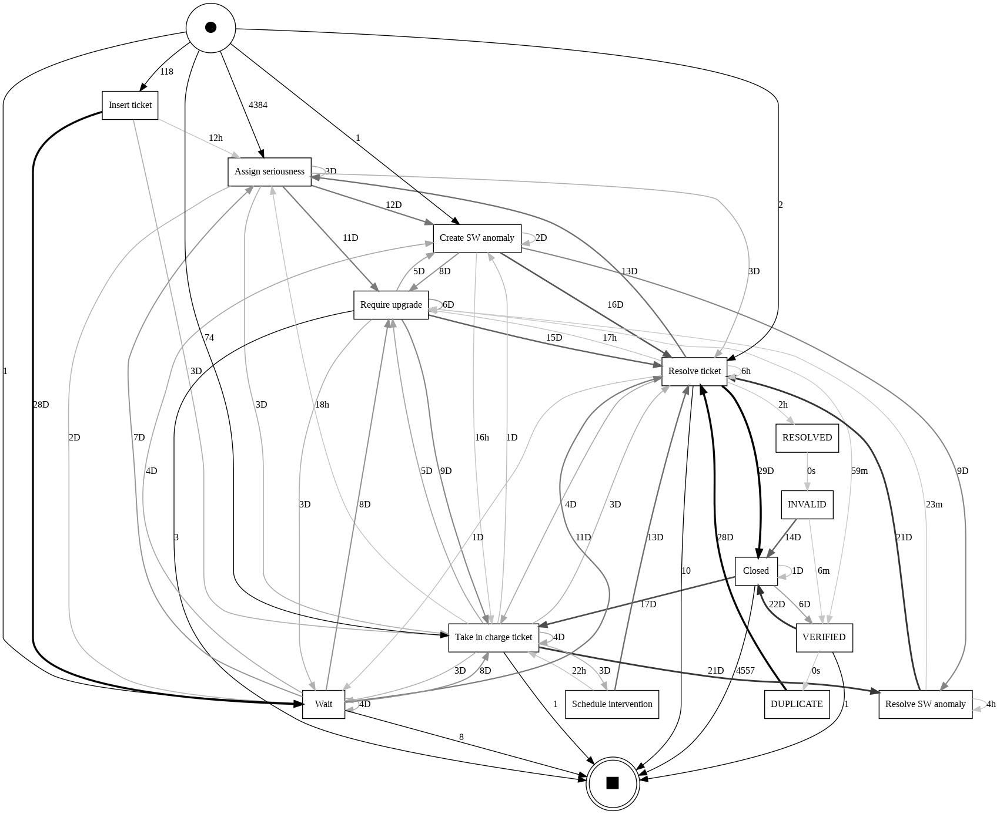

In [ ]:
performance_dfg, start_activities, end_activities = pm4py.discover_performance_dfg(xes_log)
pm4py.view_performance_dfg(performance_dfg, start_activities, end_activities)

**Heuristic Miner**



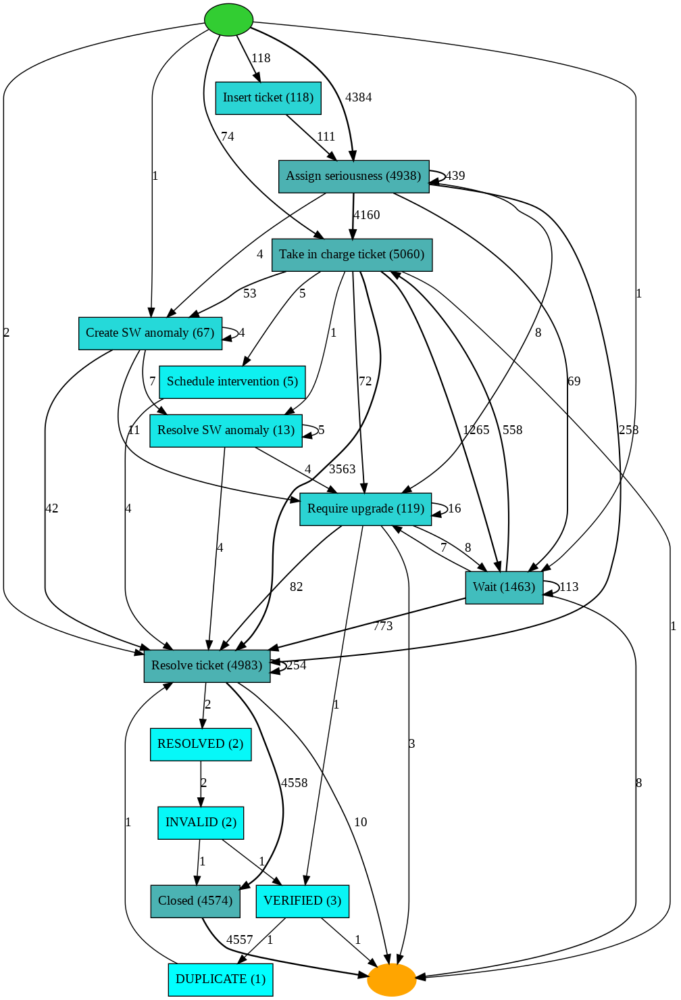

In [ ]:
map = pm4py.discover_heuristics_net(xes_log)
pm4py.view_heuristics_net(map)

### Statistics

In [ ]:
#case description
simple_ga_descritpion = duration_statistics_module.duration_statistics.cases_description(xes_log)
simple_ga_descritpion

{'Case1': {'startTime': 1349783417.0,
  'endTime': 1352458479.0,
  'caseDuration': 2675062.0},
 'Case10': {'startTime': 1265784620.0,
  'endTime': 1270270058.0,
  'caseDuration': 4485438.0},
 'Case100': {'startTime': 1365751517.0,
  'endTime': 1369909280.0,
  'caseDuration': 4157763.0},
 'Case1000': {'startTime': 1264056808.0,
  'endTime': 1267858857.0,
  'caseDuration': 3802049.0},
 'Case1001': {'startTime': 1362754884.0,
  'endTime': 1365748296.0,
  'caseDuration': 2993412.0},
 'Case1002': {'startTime': 1282721770.0,
  'endTime': 1285400432.0,
  'caseDuration': 2678662.0},
 'Case1003': {'startTime': 1293096232.0,
  'endTime': 1296809960.0,
  'caseDuration': 3713728.0},
 'Case1004': {'startTime': 1316578160.0,
  'endTime': 1319256649.0,
  'caseDuration': 2678489.0},
 'Case1005': {'startTime': 1292999714.0,
  'endTime': 1298011243.0,
  'caseDuration': 5011529.0},
 'Case1006': {'startTime': 1264151380.0,
  'endTime': 1268298633.0,
  'caseDuration': 4147253.0},
 'Case1007': {'startTime':

In [ ]:
#Gets all the case durations out of the log
simple_ga_case_duration = duration_statistics_module.duration_statistics.all_case_duration(xes_log)
simple_ga_case_duration

[2646084.0,
 2647272.0,
 2647453.0,
 2648354.0,
 2648660.0,
 2649372.0,
 2649572.0,
 2650758.0,
 2650915.0,
 2650947.0,
 2651366.0,
 2651856.0,
 2652536.0,
 2652564.0,
 2652574.0,
 2654498.0,
 2655403.0,
 2655933.0,
 2656635.0,
 2656827.0,
 2657432.0,
 2657783.0,
 2657856.0,
 2657944.0,
 2659275.0,
 2659972.0,
 2660318.0,
 2660432.0,
 2660631.0,
 2660631.0,
 2660912.0,
 2660974.0,
 2660996.0,
 2661809.0,
 2661979.0,
 2662416.0,
 2663979.0,
 2664151.0,
 2664432.0,
 2664629.0,
 2665122.0,
 2665678.0,
 2665874.0,
 2666410.0,
 2666957.0,
 2667219.0,
 2667353.0,
 2667392.0,
 2667447.0,
 2667589.0,
 2667741.0,
 2667816.0,
 2668065.0,
 2668289.0,
 2668652.0,
 2668793.0,
 2668894.0,
 2668955.0,
 2669553.0,
 2669691.0,
 2669734.0,
 2670128.0,
 2670348.0,
 2670999.0,
 2671029.0,
 2671079.0,
 2671159.0,
 2671225.0,
 2671225.0,
 2671239.0,
 2671249.0,
 2671254.0,
 2671300.0,
 2671307.0,
 2671321.0,
 2671337.0,
 2671342.0,
 2671351.0,
 2671364.0,
 2671370.0,
 2671370.0,
 2671373.0,
 2671407.0,
 267

In [ ]:
simple_ga_median_case_duration = duration_statistics_module.duration_statistics.median_case_duration(xes_log)
print("Median case duration in second: ",simple_ga_median_case_duration, "second")
print("Median case duration in days: ",simple_ga_median_case_duration / 86400, "days")

Median case duration in second:  3444811.0 second
Median case duration in days:  39.870497685185185 days


### SNA

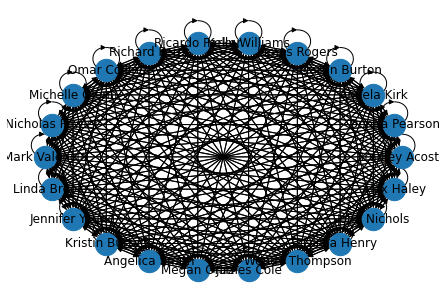

In [ ]:
handover_of_work = social_network_analysis_module.sna.handover_of_work(xes_log)

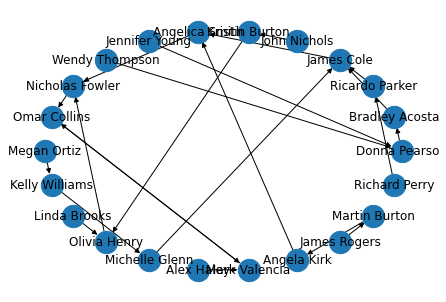

In [ ]:
subcontracting = social_network_analysis_module.sna.subcontracting(xes_log)

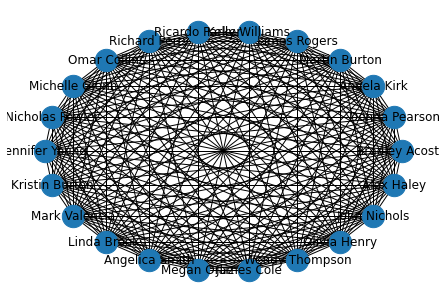

In [ ]:
working_together = social_network_analysis_module.sna.working_together(xes_log) 

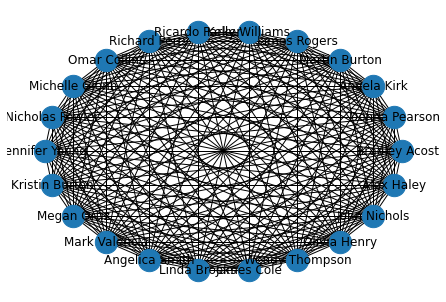

In [ ]:
similar_activities = social_network_analysis_module.sna.similar_activities(xes_log) 

In [ ]:
organizational_mining = social_network_analysis_module.sna.organizational_mining(xes_log) 


group_relative_focus
{'Kelly Williams': {'Assign seriousness': 0.04657756176589713, 'Take in charge ticket': 0.046442687747035576, 'Resolve ticket': 0.04435079269516356, 'Closed': 0.043506777437691296, 'Insert ticket': 0.025423728813559324, 'Wait': 0.04647983595352016, 'Create SW anomaly': 0.029850746268656716, 'Require upgrade': 0.08403361344537816, 'VERIFIED': 0.0, 'DUPLICATE': 0.0, 'Resolve SW anomaly': 0.0, 'Schedule intervention': 0.0, 'RESOLVED': 0.0, 'INVALID': 0.0}, 'Angelica Smith': {'Assign seriousness': 0.04637505062778453, 'Take in charge ticket': 0.0458498023715415, 'Resolve ticket': 0.047561709813365445, 'Closed': 0.04459991254919108, 'Insert ticket': 0.06779661016949153, 'Wait': 0.0430622009569378, 'Create SW anomaly': 0.05970149253731343, 'Require upgrade': 0.058823529411764705, 'VERIFIED': 0.0, 'DUPLICATE': 1.0, 'Resolve SW anomaly': 0.0, 'Schedule intervention': 0.0, 'RESOLVED': 0.0, 'INVALID': 0.0}, 'James Rogers': {'Assign seriousness': 0.04678007290400972, 'Take i

In [ ]:
clustering = social_network_analysis_module.sna.clustering(xes_log) 

clustered similar activities metric: {'1': ['Alex Haley', 'Ricardo Parker', 'James Rogers', 'Wendy Thompson', 'Richard Perry', 'Angela Kirk', 'Angelica Smith', 'John Nichols', 'Michelle Glenn', 'Kelly Williams', 'Martin Burton', 'Nicholas Fowler', 'Donna Pearson', 'Linda Brooks', 'James Cole', 'Mark Valencia'], '0': ['Bradley Acosta', 'Kristin Burton', 'Omar Collins', 'Jennifer Young', 'Olivia Henry', 'Megan Ortiz']}
 working together clustered metric: {'0': ['Alex Haley', 'Kristin Burton', 'Angelica Smith', 'Kelly Williams', 'Linda Brooks', 'Megan Ortiz'], '3': ['Ricardo Parker', 'Donna Pearson'], '1': ['James Rogers', 'Michelle Glenn', 'Omar Collins', 'Nicholas Fowler'], '2': ['Wendy Thompson', 'Angela Kirk', 'John Nichols', 'Jennifer Young', 'Martin Burton'], '4': ['Bradley Acosta', 'Richard Perry', 'Olivia Henry', 'Mark Valencia'], '5': ['James Cole']}


### EDA

<AxesSubplot: >

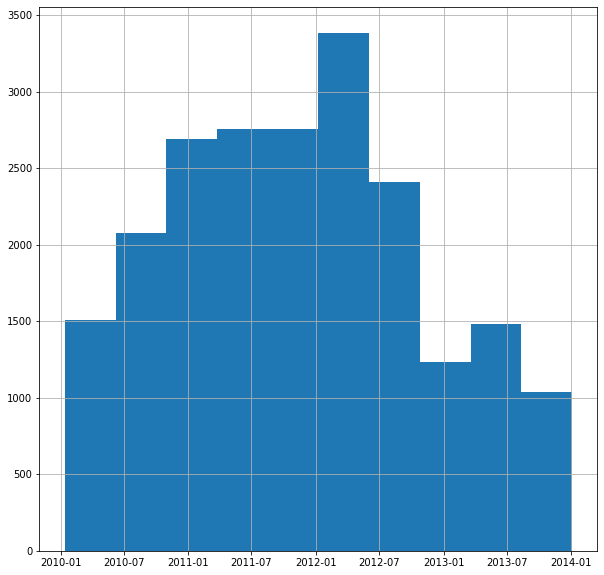

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10,10))
df_log['time:timestamp'].hist()

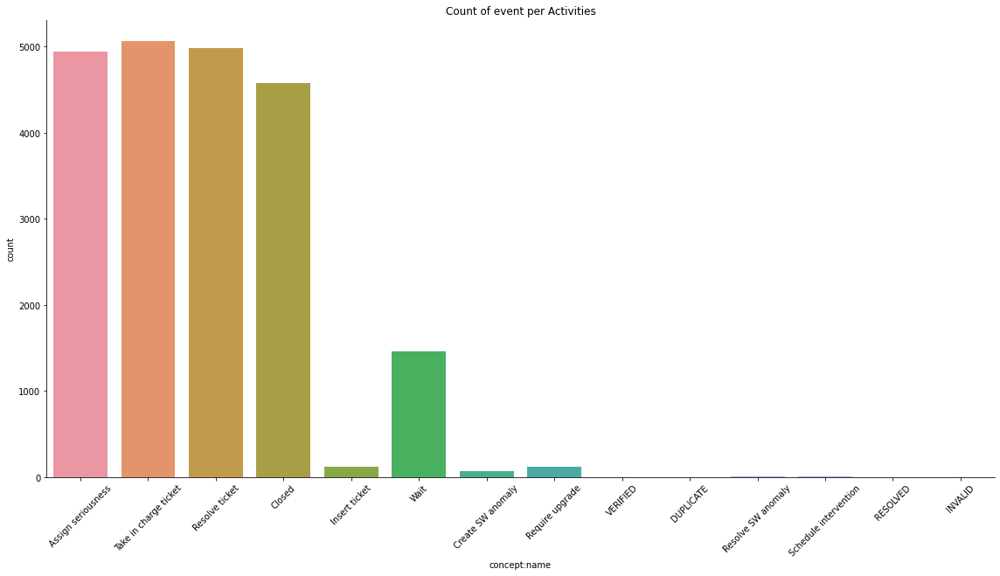

In [ ]:
fig = sns.catplot(x='concept:name', kind='count', data=df_log, height=8, aspect=2)
plt.xticks(rotation=45)
plt.title('Count of event per Activities')
plt.show(fig)

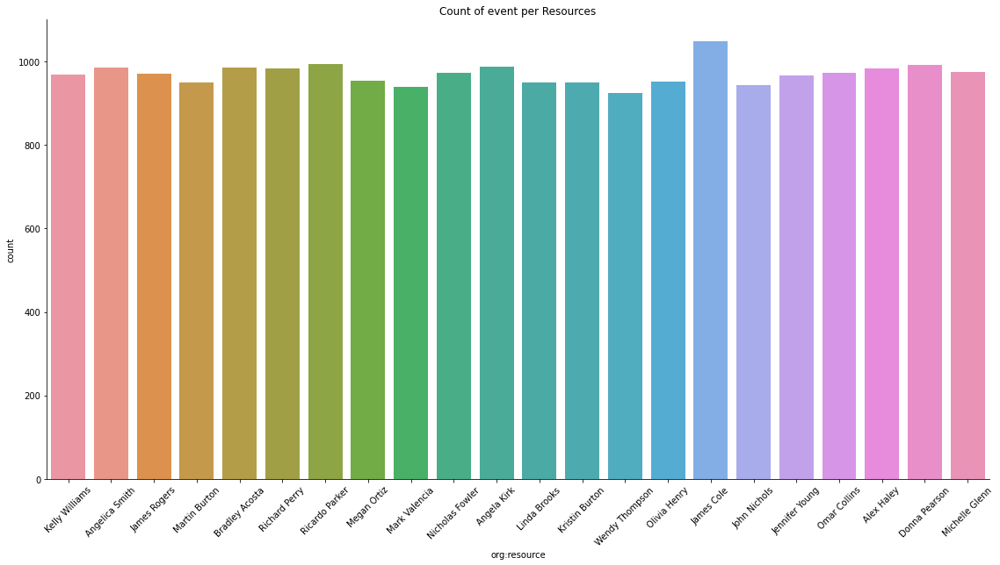

In [ ]:
fig = sns.catplot(x='org:resource', kind='count', data=df_log, height=8, aspect=2)
plt.xticks(rotation=45)
plt.title('Count of event per Resources')
plt.show(fig)

In [ ]:
activities = pm4py.get_event_attribute_values(df_log, "concept:name")
resources = pm4py.get_event_attribute_values(df_log, "org:resource")

In [ ]:
activities

{'Take in charge ticket': 5060,
 'Resolve ticket': 4983,
 'Assign seriousness': 4938,
 'Closed': 4574,
 'Wait': 1463,
 'Require upgrade': 119,
 'Insert ticket': 118,
 'Create SW anomaly': 67,
 'Resolve SW anomaly': 13,
 'Schedule intervention': 5,
 'VERIFIED': 3,
 'RESOLVED': 2,
 'INVALID': 2,
 'DUPLICATE': 1}

In [ ]:
resources

{'James Cole': 1048,
 'Ricardo Parker': 993,
 'Donna Pearson': 992,
 'Angela Kirk': 987,
 'Bradley Acosta': 986,
 'Angelica Smith': 985,
 'Richard Perry': 984,
 'Alex Haley': 983,
 'Michelle Glenn': 976,
 'Nicholas Fowler': 974,
 'Omar Collins': 973,
 'James Rogers': 971,
 'Kelly Williams': 968,
 'Jennifer Young': 967,
 'Megan Ortiz': 955,
 'Olivia Henry': 951,
 'Martin Burton': 950,
 'Kristin Burton': 949,
 'Linda Brooks': 949,
 'John Nichols': 944,
 'Mark Valencia': 939,
 'Wendy Thompson': 924}

### VISPM https://github.com/AdamBanham/vispm

[StaticDottedChartPresentor] Processing event data... 
[StaticDottedChartPresentor] Cannot find concept:name in eventlog attributes. 
[StaticDottedChartPresentor] Ready to plot... 
[StaticDottedChartPresentor] Compiling finished...         
[StaticDottedChartPresentor] Plotting data... 
[StaticDottedChartPresentor] Cleaning up plot... 
[StaticDottedChartPresentor] Plot is ready to show... 


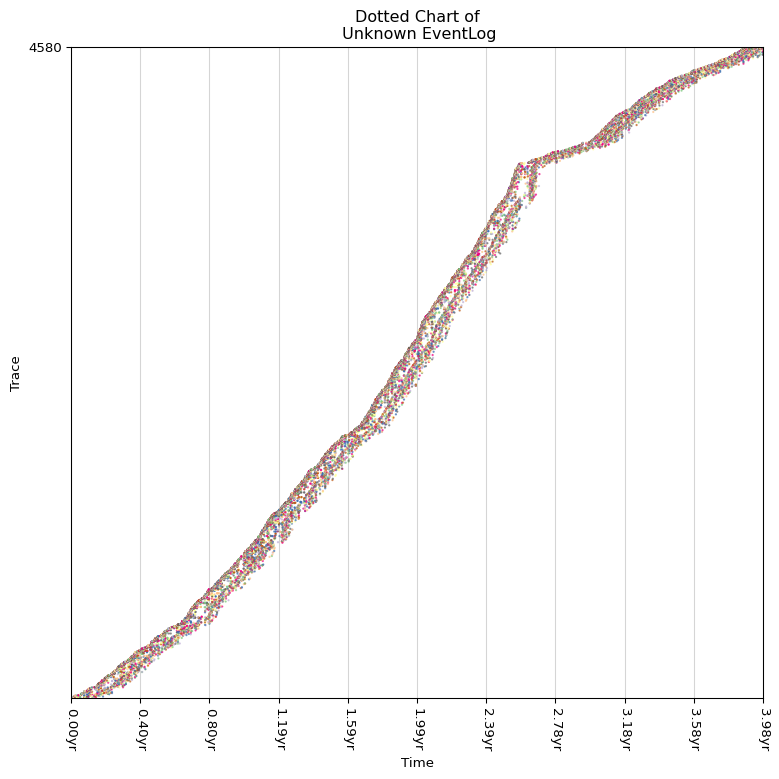

In [ ]:
# Static Presentors
from vispm import StaticDottedChartPresentor
from vispm.helpers.colours.colourmaps import HIGH_CONTRAST_COOL,HIGH_CONTRAST_WARM,EARTH,COOL_WINTER,CATEGORICAL
from matplotlib import pyplot as plt

presentor = StaticDottedChartPresentor(xes_log)
presentor.plot()
plt.show()

[StaticDottedChartPresentor] Processing event data... 
[StaticDottedChartPresentor] Cannot find concept:name in eventlog attributes. 
[StaticDottedChartPresentor] Ready to plot... 
[StaticDottedChartPresentor] Added extension : DottedColourHistogramExtension 
[StaticDottedChartPresentor] Added extension : DottedColourHistogramExtension 
[StaticDottedChartPresentor] Added extension : DottedColourHistogramExtension 
[StaticDottedChartPresentor] Added extension : DottedColourHistogramExtension 
[StaticDottedChartPresentor] Compiling finished...         
[StaticDottedChartPresentor] Plotting data... 
[DottedColourHistogramExtension] ploting histogram... 
[DottedColourHistogramExtension] ploting histogram... 
[DottedColourHistogramExtension] ploting histogram... 
[DottedColourHistogramExtension] ploting histogram... 
[StaticDottedChartPresentor] Cleaning up plot... 
[StaticDottedChartPresentor] Plot is ready to show... 


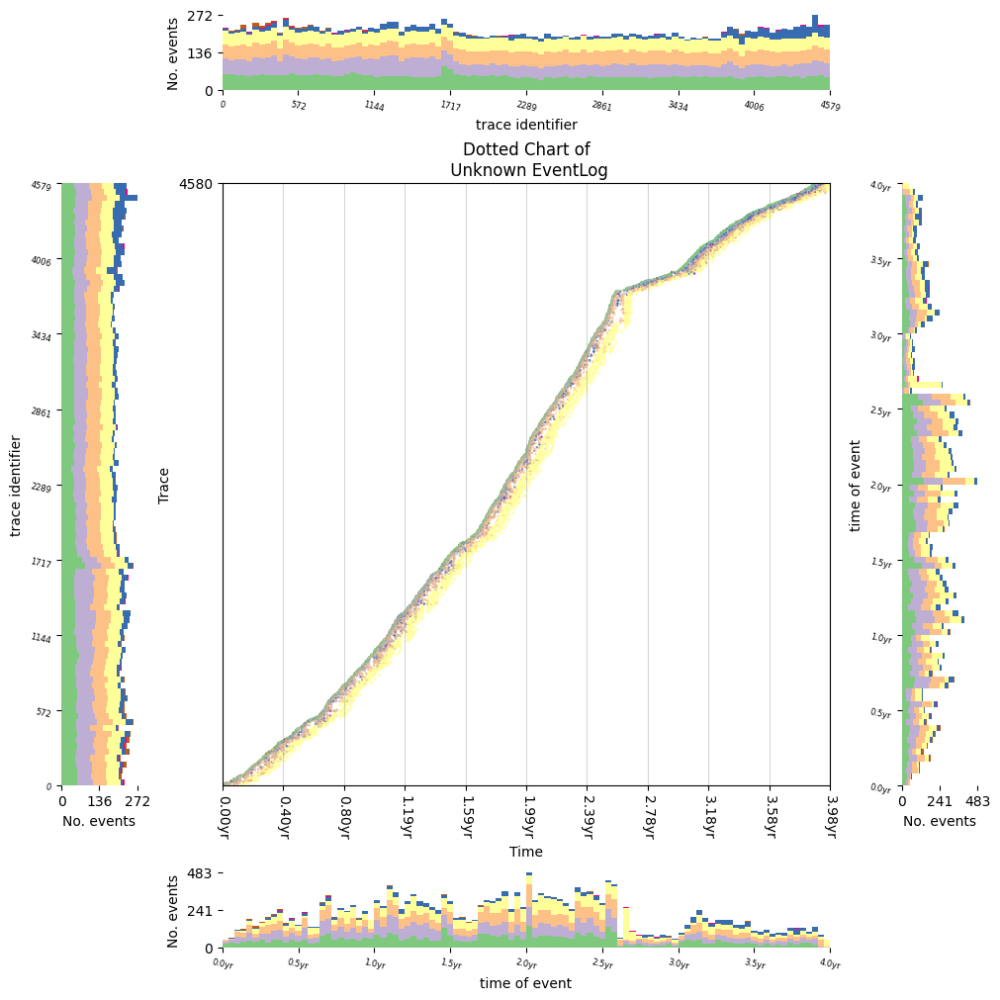

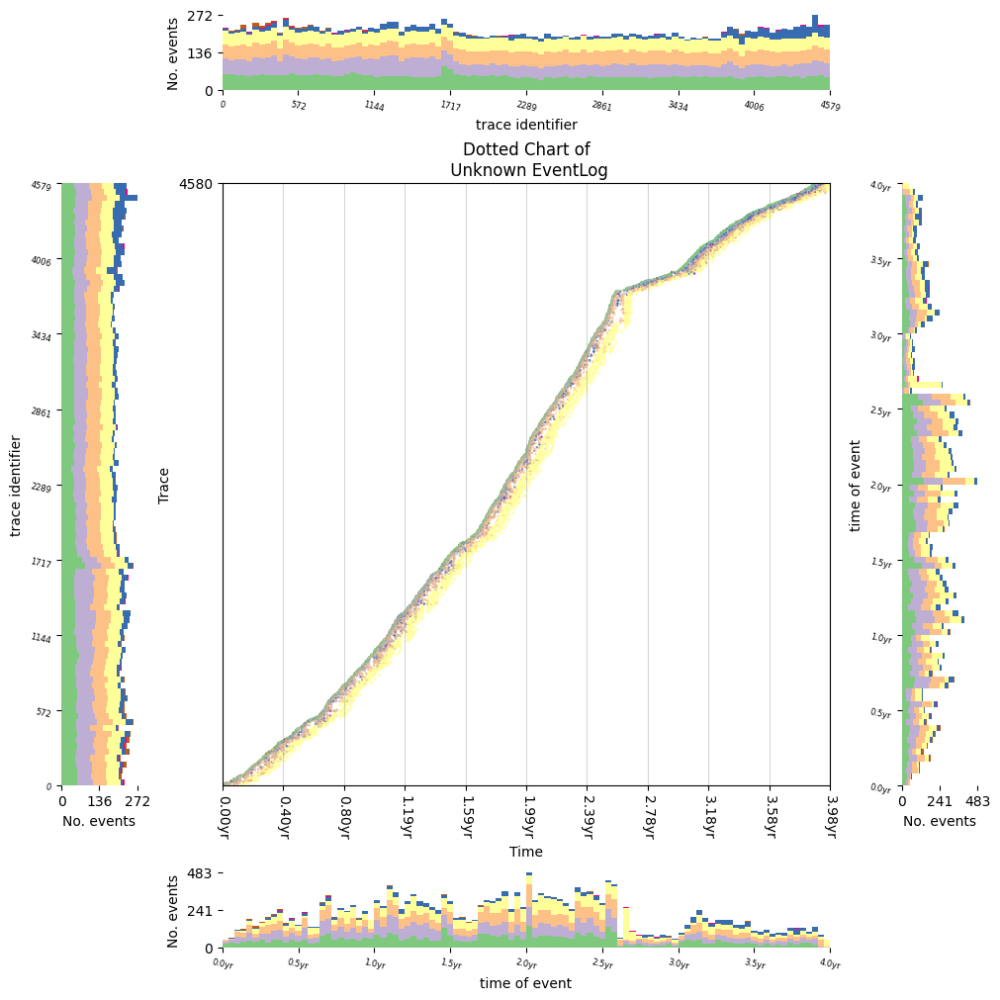

In [ ]:
# DottedColourHistogramExtension
#This extension plots a histogram based on the events within a dotted chart. Events will be broken down by colour for each bin.
from vispm import StaticDottedChartPresentor, DottedColourHistogramExtension
from vispm.helpers.colours.colourmaps import HIGH_CONTRAST_COOL,HIGH_CONTRAST_WARM,EARTH,COOL_WINTER,CATEGORICAL


presentor = StaticDottedChartPresentor(xes_log,dpi=100,
    event_colour_scheme=StaticDottedChartPresentor.EventColourScheme.EventLabel,
    colormap=CATEGORICAL
)
ext = DottedColourHistogramExtension(direction=DottedColourHistogramExtension.Direction.NORTH)
presentor.add_extension(ext)
ext = DottedColourHistogramExtension(direction=DottedColourHistogramExtension.Direction.SOUTH,
         bin_axes=DottedColourHistogramExtension.PlotAxes.X)
presentor.add_extension(ext)
ext = DottedColourHistogramExtension(direction=DottedColourHistogramExtension.Direction.WEST)
presentor.add_extension(ext)
ext = DottedColourHistogramExtension(direction=DottedColourHistogramExtension.Direction.EAST,
         bin_axes=DottedColourHistogramExtension.PlotAxes.X)
presentor.add_extension(ext)
presentor.plot()

[StaticDottedChartPresentor] Processing event data... 
[StaticDottedChartPresentor] Cannot find concept:name in eventlog attributes. 
[StaticDottedChartPresentor] Ready to plot... 
[StaticDottedChartPresentor] Added extension : DottedEventHistogramExtension 
[StaticDottedChartPresentor] Added extension : DottedEventHistogramExtension 
[StaticDottedChartPresentor] Added extension : DottedEventHistogramExtension 
[StaticDottedChartPresentor] Added extension : DottedEventHistogramExtension 
[StaticDottedChartPresentor] Compiling finished...         
[StaticDottedChartPresentor] Plotting data... 
[DottedEventHistogramExtension] ploting histogram... 
[DottedEventHistogramExtension] Event labels are imputed as :: {'Insert ticket': 'A', 'Assign seriousness': 'B', 'Take in charge ticket': 'C', 'Schedule intervention': 'D', 'Wait': 'E', 'Require upgrade': 'F', 'Resolve ticket': 'G', 'Create SW anomaly': 'H', 'Resolve SW anomaly': 'I', 'Closed': 'J', 'RESOLVED': 'K', 'DUPLICATE': 'L', 'INVALID':

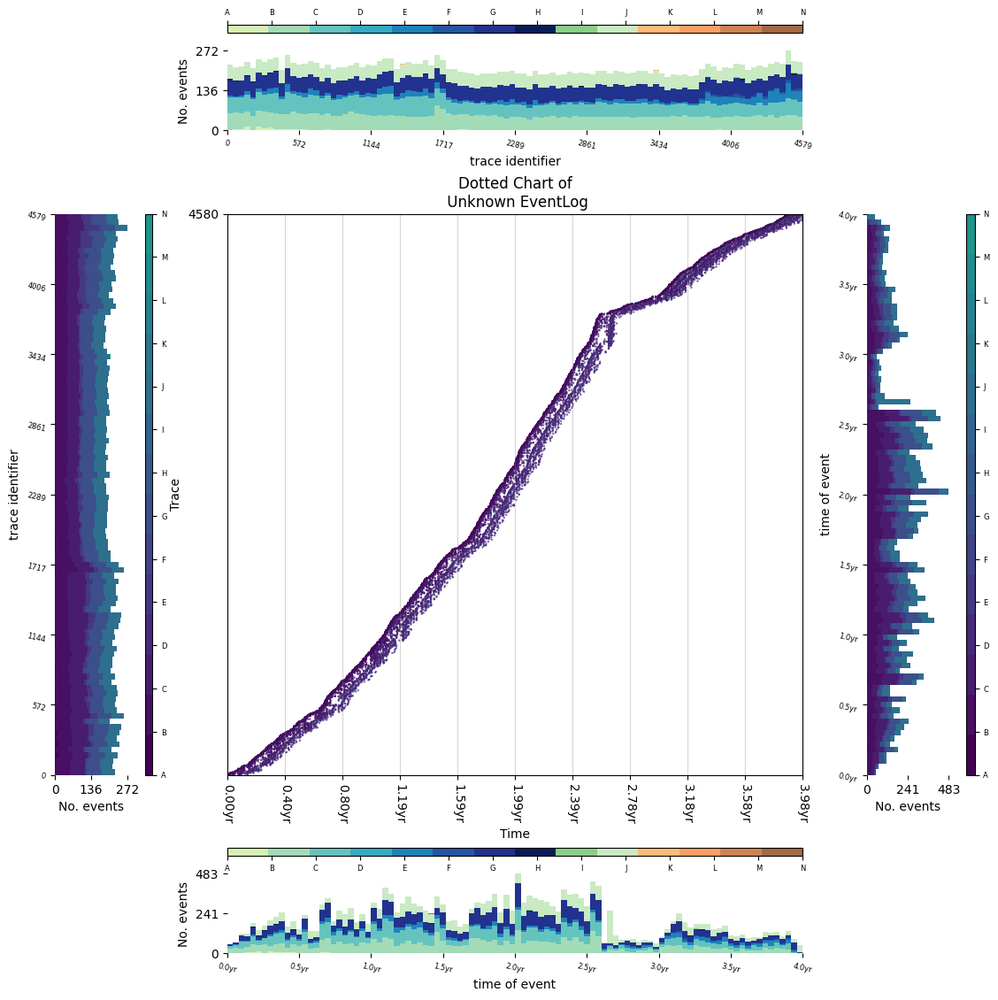

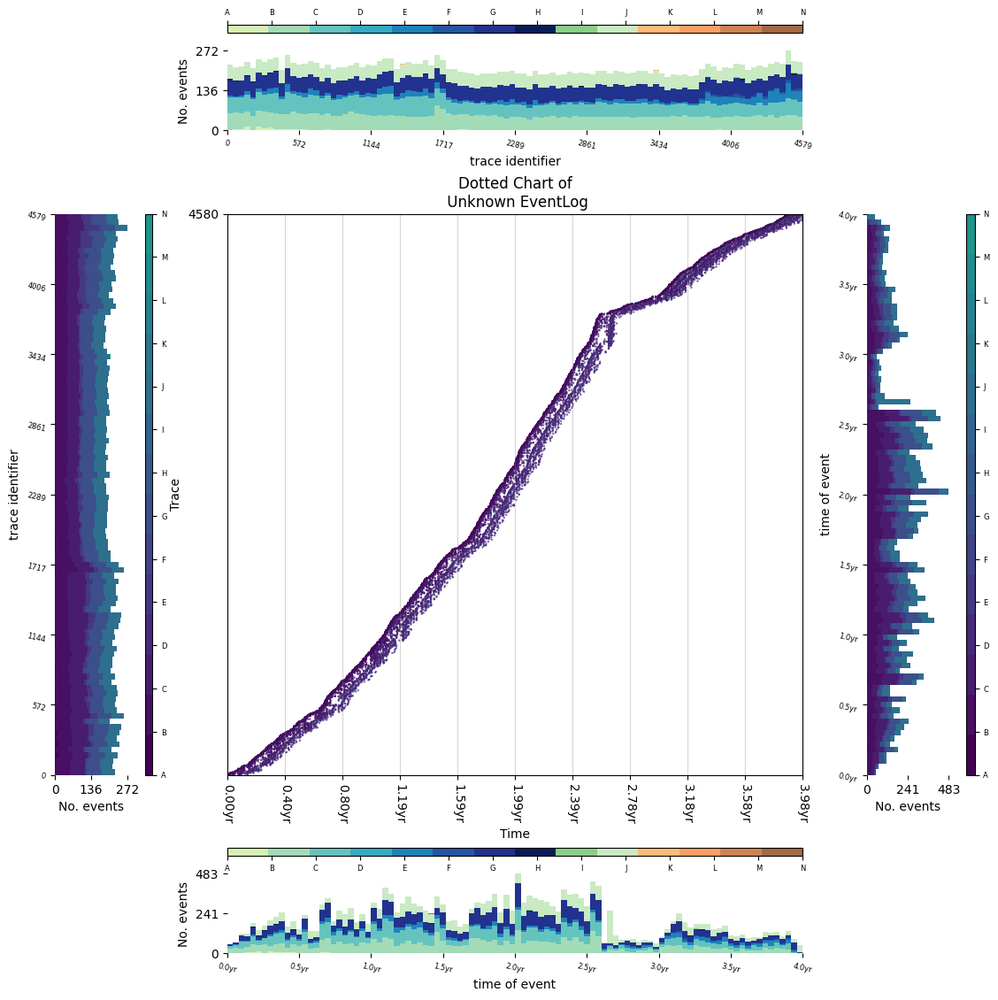

In [ ]:
# 1. setup up colour schemes to use
from vispm import StaticDottedChartPresentor, DottedColourHistogramExtension, DottedEventHistogramExtension
from vispm.helpers.colours.colourmaps import HIGH_CONTRAST_COOL,HIGH_CONTRAST_WARM
from vispm.helpers.colours.colourmaps import EARTH,COOL_WINTER
from vispm import StaticDottedChartPresentor,DottedColourHistogramExtension

import numpy as np
from matplotlib.colors import ListedColormap
from matplotlib.cm import get_cmap

colourmaps = [COOL_WINTER,EARTH,HIGH_CONTRAST_COOL,HIGH_CONTRAST_WARM]
seq_colourmap = np.vstack(
    (
    colourmaps[0](np.linspace(0.20,1,8)),
    colourmaps[1](np.linspace(0.20,1,8)),
    colourmaps[2](np.linspace(0.20,1,8)),
    colourmaps[3](np.linspace(0.20,1,8))
    
    )
)
seq_colourmap = ListedColormap(seq_colourmap, name='VARIANCE')
cmap = get_cmap(HIGH_CONTRAST_COOL, 26)


# 2. create a presentor and add extensions
presentor = StaticDottedChartPresentor(xes_log,dpi=100,
    event_colour_scheme=StaticDottedChartPresentor.EventColourScheme.EventLabel,
    colormap=cmap
)

ext = DottedEventHistogramExtension(
    direction=DottedEventHistogramExtension.Direction.SOUTH,
    bin_axes=DottedEventHistogramExtension.PlotAxes.X,
    colourmap=seq_colourmap
)
presentor.add_extension(ext)
ext = DottedEventHistogramExtension(
    direction=DottedEventHistogramExtension.Direction.NORTH,
    bin_axes=DottedEventHistogramExtension.PlotAxes.Y,
    colourmap=seq_colourmap
)
presentor.add_extension(ext)
ext = DottedEventHistogramExtension(
    direction=DottedEventHistogramExtension.Direction.WEST,
    bin_axes=DottedEventHistogramExtension.PlotAxes.Y,
    colourmap=cmap
)
presentor.add_extension(ext)
ext = DottedEventHistogramExtension(
    direction=DottedEventHistogramExtension.Direction.EAST,
    bin_axes=DottedEventHistogramExtension.PlotAxes.X,
    colourmap=cmap
)
presentor.add_extension(ext)

presentor.plot()

[StaticDottedChartPresentor] Processing event data... 
[StaticDottedChartPresentor] Cannot find concept:name in eventlog attributes. 
[StaticDottedChartPresentor] Ready to plot... 
[StaticDottedChartPresentor] Added extension : DottedEventHistogramExtension 
[StaticDottedChartPresentor] Added extension : DottedEventHistogramExtension 
[StaticDottedChartPresentor] Added extension : DottedEventHistogramExtension 
[StaticDottedChartPresentor] Added extension : DottedEventHistogramExtension 
[StaticDottedChartPresentor] Compiling finished...         
[StaticDottedChartPresentor] Plotting data... 
[DottedEventHistogramExtension] ploting histogram... 
[DottedEventHistogramExtension] Event labels are imputed as :: {'Insert ticket': 'A', 'Assign seriousness': 'B', 'Take in charge ticket': 'C', 'Schedule intervention': 'D', 'Wait': 'E', 'Require upgrade': 'F', 'Resolve ticket': 'G', 'Create SW anomaly': 'H', 'Resolve SW anomaly': 'I', 'Closed': 'J', 'RESOLVED': 'K', 'DUPLICATE': 'L', 'INVALID':

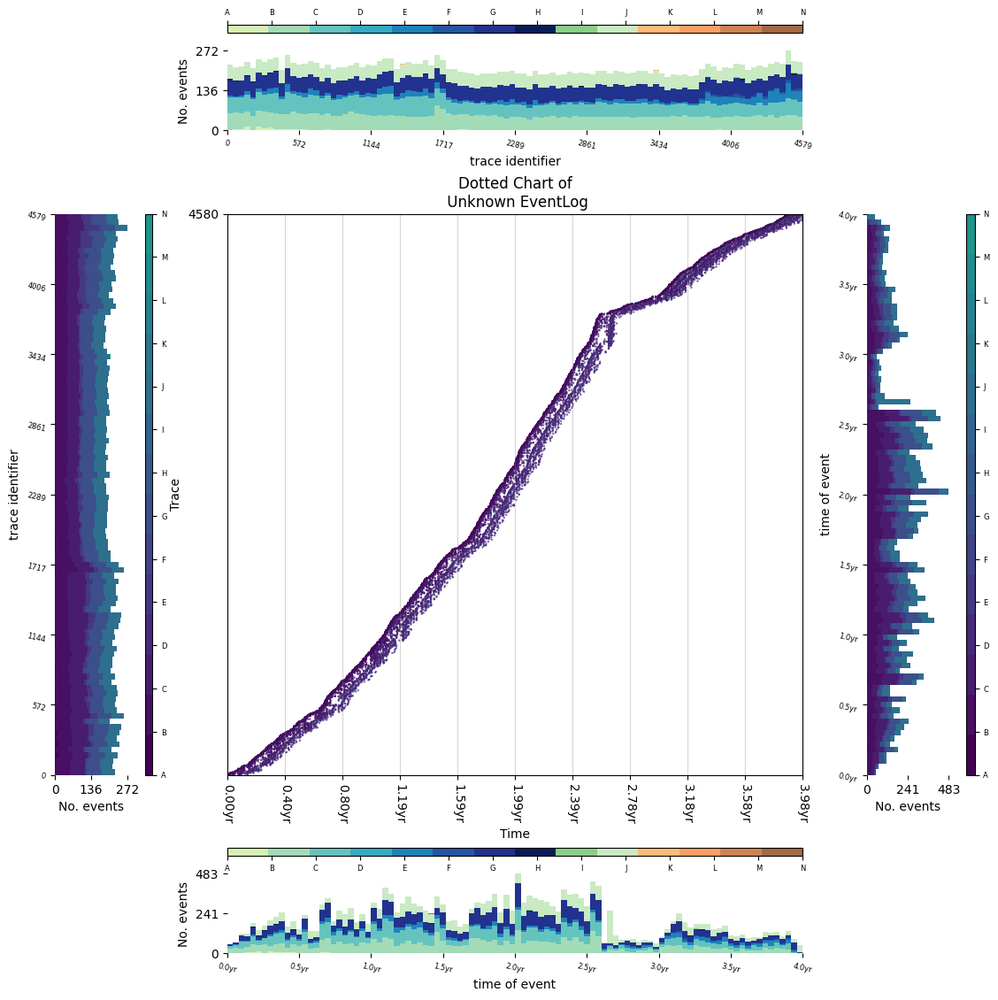

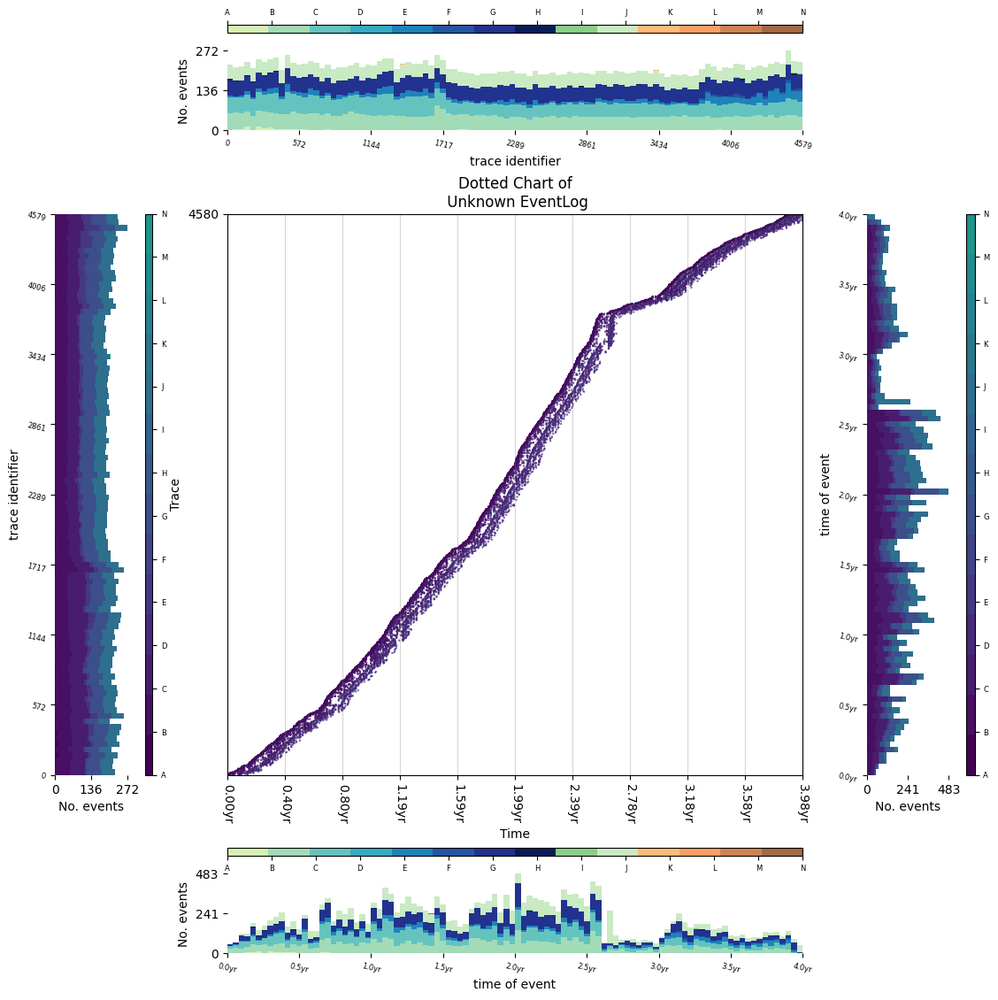

In [ ]:
# 1. setup up colour schemes to use
from vispm import StaticDottedChartPresentor, DottedColourHistogramExtension, DottedEventHistogramExtension
from vispm.helpers.colours.colourmaps import HIGH_CONTRAST_COOL,HIGH_CONTRAST_WARM,EARTH,COOL_WINTER,CATEGORICAL
from vispm import StaticDottedChartPresentor,DottedColourHistogramExtension

import numpy as np
from matplotlib.colors import ListedColormap
from matplotlib.cm import get_cmap

colourmaps = [COOL_WINTER,EARTH,HIGH_CONTRAST_COOL,HIGH_CONTRAST_WARM, CATEGORICAL]
seq_colourmap = np.vstack(
    (
    colourmaps[0](np.linspace(0.20,1,8)),
    colourmaps[1](np.linspace(0.20,1,8)),
    colourmaps[2](np.linspace(0.20,1,8)),
    colourmaps[3](np.linspace(0.20,1,8)),
    colourmaps[4](np.linspace(0.20,1,8))
    
    )
)
seq_colourmap = ListedColormap(seq_colourmap, name='VARIANCE')
cmap = get_cmap(HIGH_CONTRAST_COOL, 26)


# 2. create a presentor and add extensions
presentor = StaticDottedChartPresentor(xes_log,dpi=100,
    event_colour_scheme=StaticDottedChartPresentor.EventColourScheme.EventLabel,
    colormap=cmap
)

ext = DottedEventHistogramExtension(
    direction=DottedEventHistogramExtension.Direction.SOUTH,
    bin_axes=DottedEventHistogramExtension.PlotAxes.X,
    colourmap=seq_colourmap
)
presentor.add_extension(ext)
ext = DottedEventHistogramExtension(
    direction=DottedEventHistogramExtension.Direction.NORTH,
    bin_axes=DottedEventHistogramExtension.PlotAxes.Y,
    colourmap=seq_colourmap
)
presentor.add_extension(ext)
ext = DottedEventHistogramExtension(
    direction=DottedEventHistogramExtension.Direction.WEST,
    bin_axes=DottedEventHistogramExtension.PlotAxes.Y,
    colourmap=cmap
)
presentor.add_extension(ext)
ext = DottedEventHistogramExtension(
    direction=DottedEventHistogramExtension.Direction.EAST,
    bin_axes=DottedEventHistogramExtension.PlotAxes.X,
    colourmap=cmap
)
presentor.add_extension(ext)

presentor.plot()

[StaticDottedChartPresentor] Processing event data... 
[StaticDottedChartPresentor] Cannot find concept:name in eventlog attributes. 
[StaticDottedChartPresentor] Ready to plot... 
[StaticDottedChartPresentor] Added extension : DescriptionHistogramExtension 
[StaticDottedChartPresentor] Added extension : DescriptionHistogramExtension 
[StaticDottedChartPresentor] Added extension : DescriptionHistogramExtension 
[StaticDottedChartPresentor] Added extension : DescriptionHistogramExtension 
[StaticDottedChartPresentor] Compiling finished...         
[StaticDottedChartPresentor] Plotting data... 
[DescriptionHistogramExtension] plotting histogram 
[DescriptionHistogramExtension] Event labels are imputed as :: {'Insert ticket': 'A', 'Assign seriousness': 'B', 'Take in charge ticket': 'C', 'Schedule intervention': 'D', 'Wait': 'E', 'Require upgrade': 'F', 'Resolve ticket': 'G', 'Create SW anomaly': 'H', 'Resolve SW anomaly': 'I', 'Closed': 'J', 'RESOLVED': 'K', 'DUPLICATE': 'L', 'INVALID': '

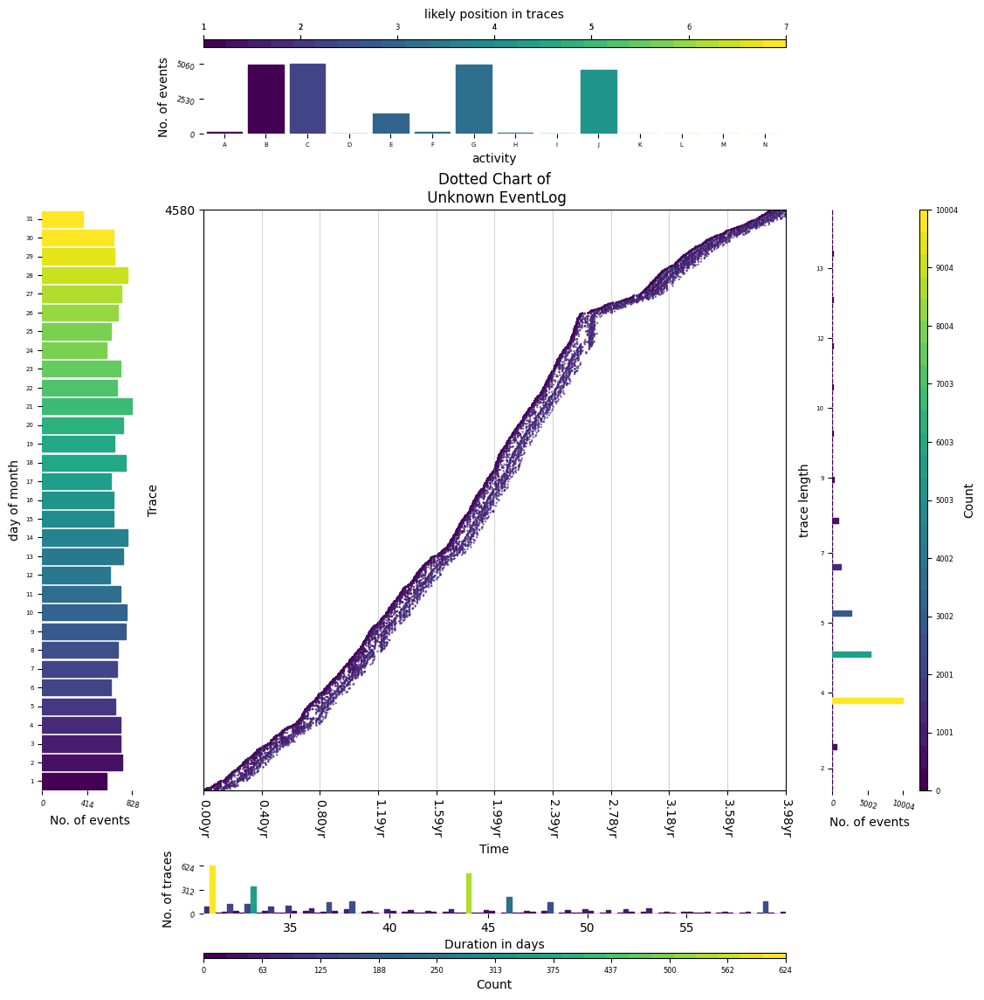

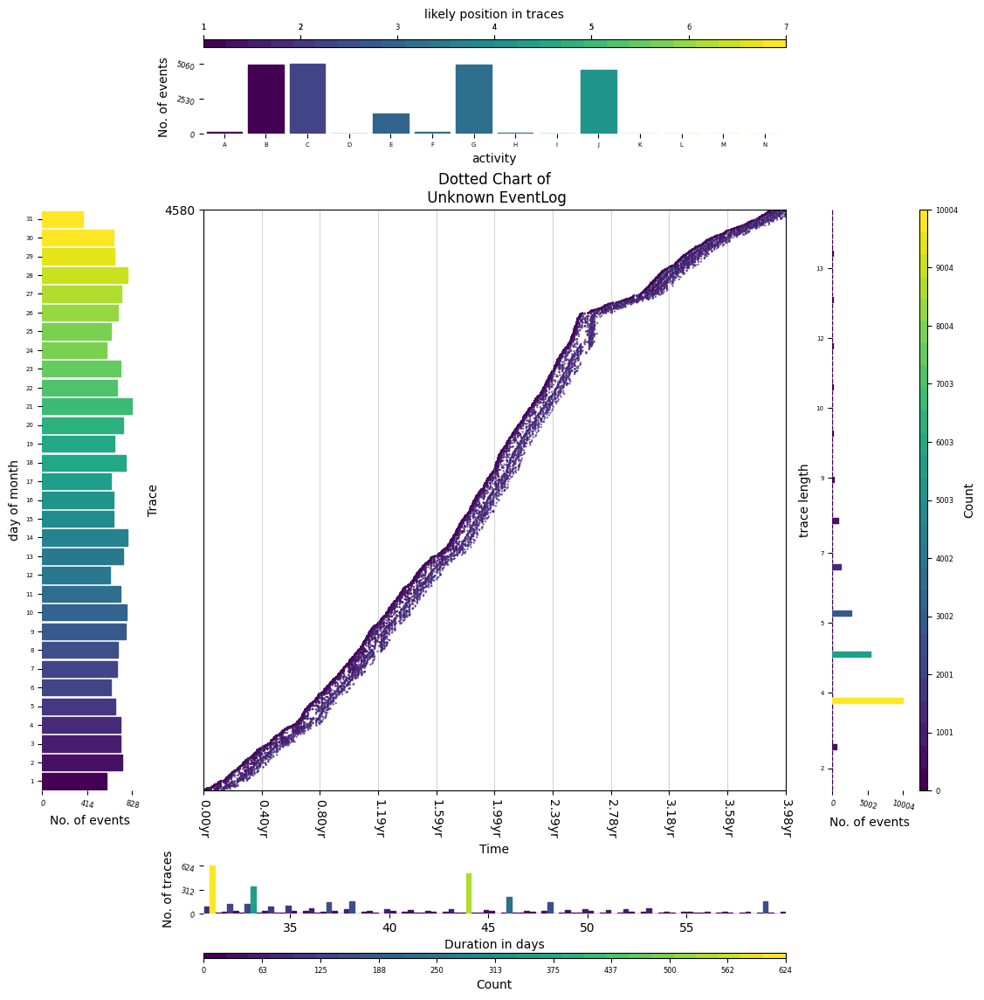

In [ ]:
#DescriptionHistogramExtension
#This extension describes an aspect of the event log.
# For example, a breakdown of trace duration, or trace length (by the number of activities), or event label, or when events occur (weekday or monthday).

#The following example shows how to use this extension to understand the properties of event log, alongside a dotted chart.


from vispm import DescriptionHistogramExtension
from vispm.helpers.colours.colourmaps import HIGH_CONTRAST_COOL,HIGH_CONTRAST_WARM,EARTH,COOL_WINTER,CATEGORICAL
from vispm import StaticDottedChartPresentor,DottedColourHistogramExtension


cmap = get_cmap(HIGH_CONTRAST_COOL, 26)
presentor = StaticDottedChartPresentor(xes_log,dpi=100,
    event_colour_scheme=StaticDottedChartPresentor.EventColourScheme.EventLabel,
    colormap=cmap
)

ext = DescriptionHistogramExtension(
)
presentor.add_extension(ext)

ext = DescriptionHistogramExtension(
    direction=DescriptionHistogramExtension.Direction.EAST,
    describe=DescriptionHistogramExtension.Describe.TraceLength,
    density=DescriptionHistogramExtension.Density.Event
)
presentor.add_extension(ext)

ext = DescriptionHistogramExtension(
    direction=DescriptionHistogramExtension.Direction.SOUTH,
    describe=DescriptionHistogramExtension.Describe.TraceDuration,
    density=DescriptionHistogramExtension.Density.Trace
)
presentor.add_extension(ext)

ext = DescriptionHistogramExtension(
    direction=DescriptionHistogramExtension.Direction.WEST,
    describe=DescriptionHistogramExtension.Describe.Monthday,
    density=DescriptionHistogramExtension.Density.Event
)
presentor.add_extension(ext)

presentor.plot()

## BPI 2012 Challenge Dataset

** Cleaned Dataset**
Previously, I manually cleaned the dataset in term of user invovled so the imported dataset used is already cleaned for observation

The following code was used to replace the "org:resource" by generating a random fake name trough the Faker module for each unique value 



```
# from faker import Faker
import random

faker = Faker()
name = [faker.name() for i in range(56)]
bpi2012_log['name'] = [random.choice(name) for i in bpi2012_log['org:resource']]
bpi2012_log['org:resource'] = bpi2012_log['name']
bpi2012_log.drop('name', axis=1)
```



In [ ]:
bpi_2012 = '/content/drive/MyDrive/Abou Keita - Capstone 606/Datasets/cleaned_bpi2012_log.xes'
df_log = pm4py.read_xes(bpi_2012)

parsing log, completed traces ::   0%|          | 0/9658 [00:00<?, ?it/s]

Get starting and ending activities

In [ ]:
xes_start_activites = pm4py.get_start_activities(df_log)
xes_end_activites = pm4py.get_end_activities(df_log)
print("starting activity: {} \n ending activity: {}".format(xes_start_activites, xes_end_activites))

starting activity: {'W_Completeren aanvraag': 4852, 'W_Afhandelen leads': 4739, 'W_Beoordelen fraude': 67} 
 ending activity: {'W_Valideren aanvraag': 2751, 'W_Completeren aanvraag': 2355, 'W_Afhandelen leads': 2235, 'W_Nabellen offertes': 1803, 'W_Nabellen incomplete dossiers': 457, 'W_Beoordelen fraude': 57}


DataFrame

In [ ]:
df_log

,lifecycle:transition,time:timestamp,(case)_AMOUNT_REQ,concept:name,org:resource,name,case:concept:name,case:variant,case:variant-index,case:creator
0,complete,2011-10-01 09:45:13.917000+00:00,20000,W_Completeren aanvraag,Jennifer Thomas MD,Jennifer Thomas MD,173688,Variant 14,14,Fluxicon Disco
1,complete,2011-10-01 10:17:08.924000+00:00,20000,W_Nabellen offertes,Robert Peters,Robert Peters,173688,Variant 14,14,Fluxicon Disco
2,complete,2011-10-08 14:32:00.886000+00:00,20000,W_Nabellen offertes,Christina Barnes,Christina Barnes,173688,Variant 14,14,Fluxicon Disco
3,complete,2011-10-10 09:33:05.791000+00:00,20000,W_Nabellen offertes,David Adams,David Adams,173688,Variant 14,14,Fluxicon Disco
4,complete,2011-10-13 08:37:37.026000+00:00,20000,W_Valideren aanvraag,William Arroyo,William Arroyo,173688,Variant 14,14,Fluxicon Disco
...,...,...,...,...,...,...,...,...,...,...
72408,complete,2012-03-01 08:28:21.228000+00:00,20000,W_Afhandelen leads,Travis Edwards,Travis Edwards,214370,Variant 1,1,Fluxicon Disco
72409,complete,2012-03-01 08:27:52.388000+00:00,8500,W_Afhandelen leads,Jennifer Collier,Jennifer Collier,214373,Variant 86,86,Fluxicon Disco
72410,complete,2012-03-01 19:22:41.157000+00:00,8500,W_Completeren aanvraag,Emily Rice,Emily Rice,214373,Variant 86,86,Fluxicon Disco
72411,complete,2012-03-10 11:50:54.881000+00:00,8500,W_Nabellen offertes,Mary Thompson,Mary Thompson,214373,Variant 86,86,Fluxicon Disco


In [ ]:
df_log.columns

Index(['lifecycle:transition', 'time:timestamp', '(case)_AMOUNT_REQ',
       'concept:name', 'org:resource', 'name', 'case:concept:name',
       'case:variant', 'case:variant-index', 'case:creator'],
      dtype='object')

In [ ]:
num_event = len(df_log)
num_cases = len(df_log['case:concept:name'].unique())
print("number of event: {} \n Number of unique cases: {}".format(num_event, num_cases))

number of event: 72413 
 Number of unique cases: 9658


In [ ]:
df_log['org:resource'].unique()

array(['Jennifer Thomas MD', 'Robert Peters', 'Christina Barnes',
       'David Adams', 'William Arroyo', 'Anna Schroeder', 'Brianna Bell',
       'Brandon Powell', 'Aaron Ray', 'Scott Little', 'Ashley Daniel',
       'Lisa Henson', 'Jennifer Wilson', 'Jane Turner',
       'Brianna Martinez', 'Laura Morris', 'Wesley Mills',
       'Brittany Valencia', 'Rhonda Brady', 'Emily Rice', 'Patrick Cole',
       'Paul Alvarado', 'Justin Thompson', 'Vanessa Shepherd',
       'Matthew Walker', 'Miguel Reeves', 'Kathy Ingram', 'Derrick Watts',
       'Sarah Hogan', 'Martha Costa', 'Emily Rojas', 'Steven Jones',
       'Rebecca Guerrero', 'David Doyle', 'Michelle Brennan',
       'Donald Wilson', 'Austin Jones', 'Joshua Phelps', 'Nathan Thomas',
       'Mary Thompson', 'Patricia Lloyd', 'Kayla Woods', 'Luis Jackson',
       'Donald White', 'Shawn Barnes', 'Heather Patterson',
       'Pam Martinez', 'Jesse Moore', 'Travis Edwards', 'Ruth Davies',
       'Nancy Clayton', 'Sherry Klein', 'Jacob Wilson

In [ ]:
#the unique activies taking places in the log
df_log['concept:name'].nunique()

6

**Inductive Miner**

In PM4Py, we offer an implementation of the inductive miner (IM), of the inductive miner infrequent (IMf), and of the inductive miner directly-follows (IMd) algorithm. The papers describing the approaches are the following:

Inductive Miner: Discovering block-structured process models from event logs-a constructive approach
Inductive Miner infrequent: Discovering block-structured process models from event logs containing infrequent behaviour
Inductive Miner directly-follows Scalable process discovery with guarantees
The basic idea of Inductive Miner is about detecting a 'cut' in the log (e.g. sequential cut, parallel cut, concurrent cut and loop cut) and then recur on sublogs, which were found applying the cut, until a base case is found. The Directly-Follows variant avoids the recursion on the sublogs but uses the Directly Follows graph.

Inductive miner models usually make extensive use of hidden transitions, especially for skipping/looping on a portion on the model. Furthermore, each visible transition has a unique label (there are no transitions in the model that share the same label). \n

https://pm4py.fit.fraunhofer.de/documentation#discovery


In [ ]:
xes_log = pm4py.convert_to_event_log(df_log)

/usr/local/lib/python3.8/dist-packages/pm4py/utils.py:486: UserWarning: the EventLog class has been deprecated and will be removed in a future release.
  warnings.warn("the EventLog class has been deprecated and will be removed in a future release.")


**BPMN model**

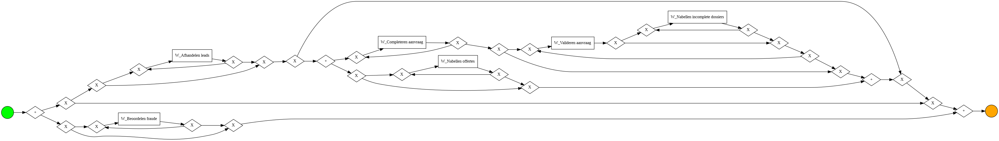

In [ ]:
bpmn_model = pm4py.discover_bpmn_inductive(xes_log)
pm4py.view_bpmn(bpmn_model)

**Process Trees**

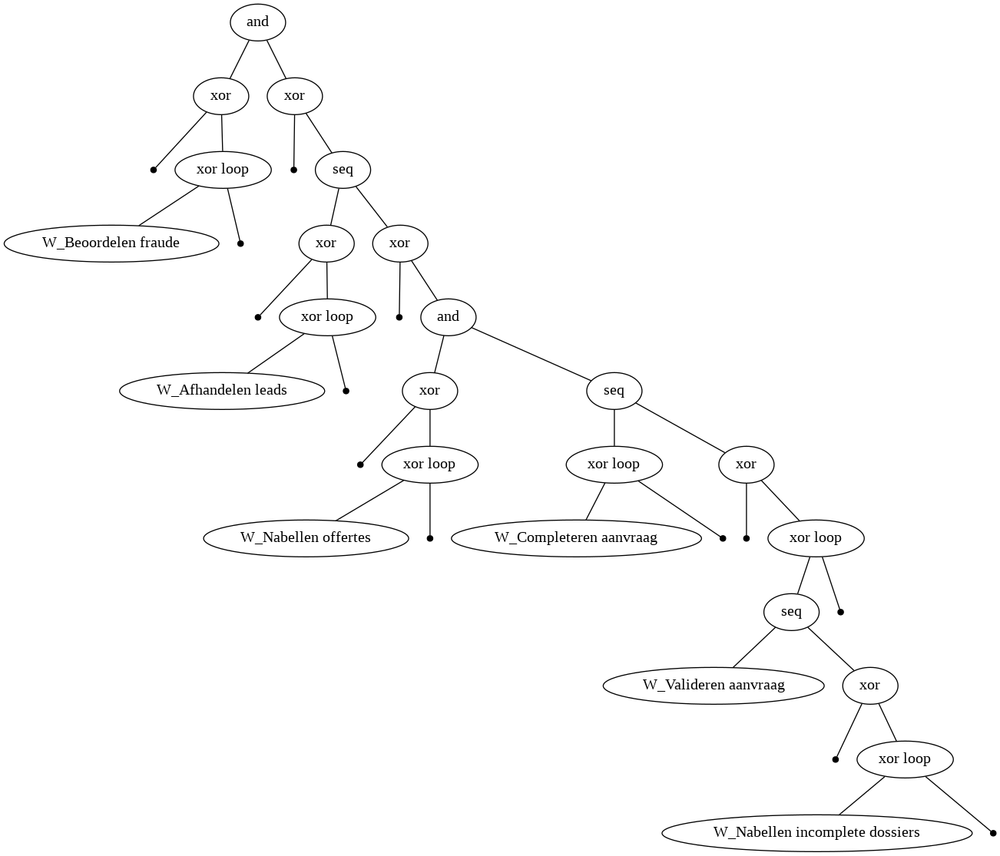

In [ ]:
process_tree = pm4py.discover_process_tree_inductive(xes_log)
pm4py.view_process_tree(process_tree)

**Petri Nets**: To mine a Petri Net 

A log is read, the inductive miner is applied and the Petri net along with the initial and the final marking are found. First, the log is read, then the inductive miner algorithm is applied.

Can also accepts a process tree as input

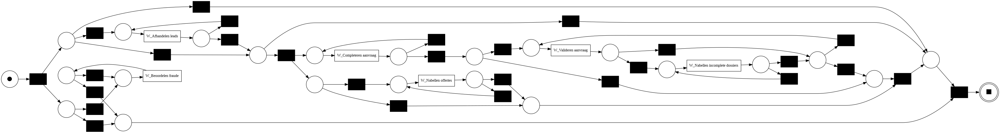

In [ ]:
net, initial_marking, final_marking = pm4py.discover_petri_net_inductive(xes_log)
pm4py.view_petri_net(net, initial_marking, final_marking)

**Alpha Miner**

The alpha miner is one of the most known Process Discovery algorithm and is able to find:

A Petri net model where all the transitions are visible and unique and correspond to classified events (for example, to activities).
An initial marking that describes the status of the Petri net model when a execution starts.
A final marking that describes the status of the Petri net model when a execution ends.

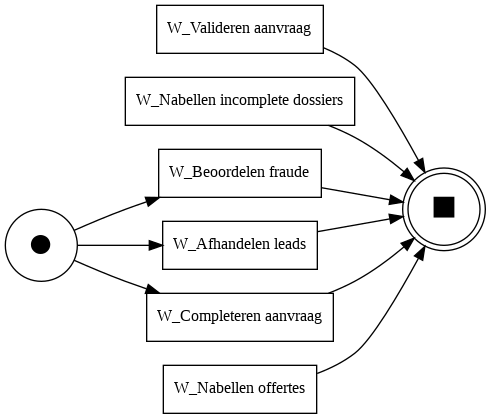

In [ ]:
net1, im1, fm1 = pm4py.discover_petri_net_alpha(xes_log)
pm4py.view_petri_net(net1, im1, fm1)

**Alpha Miner Plus**

a. not good at finding "invisble" transition

b. can be problamatic

<ipython-input-91-d2afa5897a15>:1: DeprecatedWarning: discover_petri_net_alpha_plus is deprecated as of 2.3.0 and will be removed in 3.0.0. this method will be removed in a future release.
  net2, im2, fm2 = pm4py.discover_petri_net_alpha_plus(xes_log)


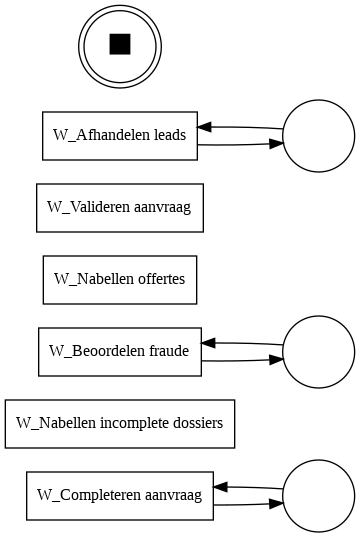

In [ ]:
net2, im2, fm2 = pm4py.discover_petri_net_alpha_plus(xes_log)
pm4py.view_petri_net(net2, im2, fm2)

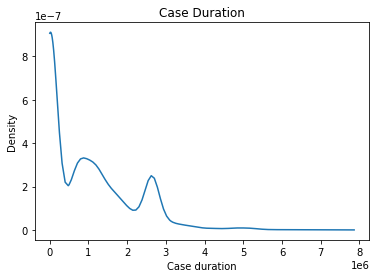

In [ ]:
pm4py.view_case_duration_graph(xes_log)

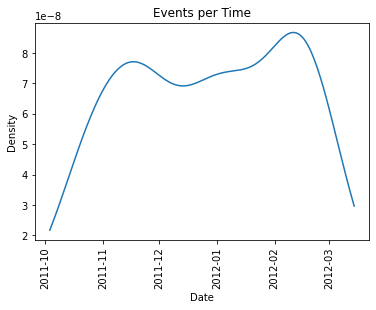

In [ ]:
pm4py.vis.view_events_per_time_graph(xes_log)

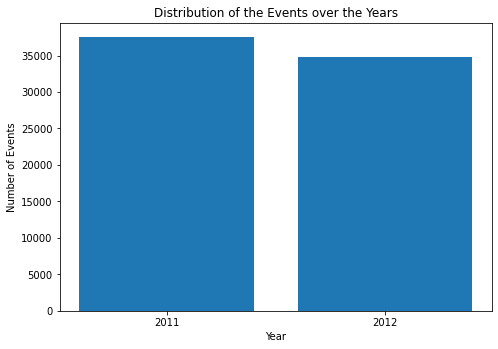

In [ ]:
pm4py.vis.view_events_distribution_graph(xes_log, distr_type= 'years', activity_key='concept:name', case_id_key='case:concept:name', timestamp_key='time:timestamp')

**Directly-Follows Graph**

<ipython-input-95-e14e9b39e739>:1: DeprecatedWarning: discover_dfg is deprecated as of 2.3.0 and will be removed in 2.4.0. this method will be replaced by the discover_dfg_typed function(). Please adapt your code to use pm4py.discover_dfg_typed()
  dfg, start_activities, end_activities = pm4py.discover_dfg(xes_log)


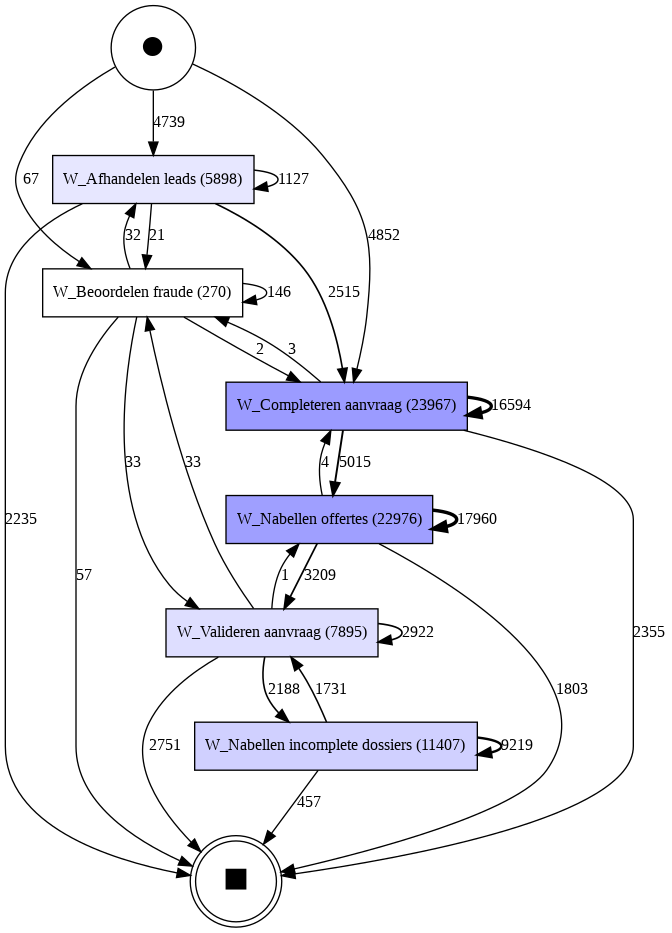

In [ ]:
dfg, start_activities, end_activities = pm4py.discover_dfg(xes_log)
pm4py.view_dfg(dfg, start_activities, end_activities)

**Visualization of DFG**

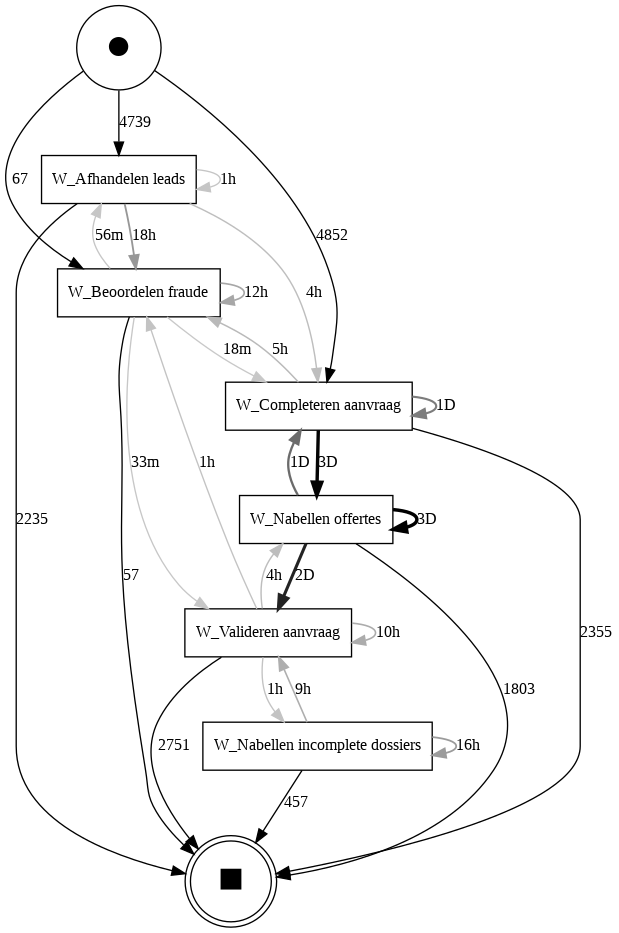

In [ ]:
performance_dfg, start_activities, end_activities = pm4py.discover_performance_dfg(xes_log)
pm4py.view_performance_dfg(performance_dfg, start_activities, end_activities)

**Heuristic Miner**



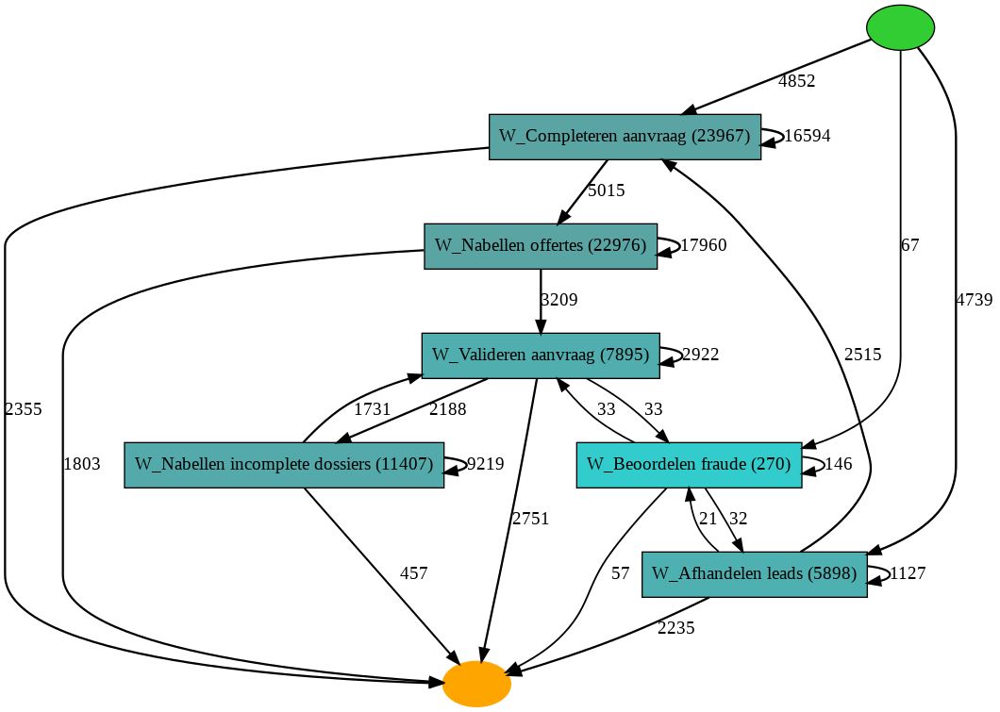

In [ ]:
map = pm4py.discover_heuristics_net(xes_log)
pm4py.view_heuristics_net(map)

### Statistics

In [ ]:
#case description
simple_ga_descritpion = duration_statistics_module.duration_statistics.cases_description(xes_log)
simple_ga_descritpion

{'173688': {'startTime': 1317462313.917,
  'endTime': 1318495057.026,
  'caseDuration': 1032743.1089999676},
 '173691': {'startTime': 1317462193.178,
  'endTime': 1318249054.633,
  'caseDuration': 786861.4549999237},
 '173694': {'startTime': 1317461759.637,
  'endTime': 1320419101.532,
  'caseDuration': 2957341.894999981},
 '173703': {'startTime': 1317462024.141,
  'endTime': 1317466932.557,
  'caseDuration': 4908.415999889374},
 '173706': {'startTime': 1317457009.843,
  'endTime': 1317474002.537,
  'caseDuration': 16992.694000005722},
 '173709': {'startTime': 1317457627.853,
  'endTime': 1320135308.331,
  'caseDuration': 2677680.478000164},
 '173712': {'startTime': 1317456625.759,
  'endTime': 1317645775.584,
  'caseDuration': 189149.82500004768},
 '173715': {'startTime': 1317462366.342,
  'endTime': 1318496728.082,
  'caseDuration': 1034361.7400000095},
 '173718': {'startTime': 1317458683.954,
  'endTime': 1319699881.79,
  'caseDuration': 2241197.8359999657},
 '173721': {'startTime':

In [ ]:
#Gets all the case durations out of the log
simple_ga_case_duration = duration_statistics_module.duration_statistics.all_case_duration(xes_log)
simple_ga_case_duration

[0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0

In [ ]:
simple_ga_median_case_duration = duration_statistics_module.duration_statistics.median_case_duration(xes_log)
print("Median case duration in second: ",simple_ga_median_case_duration, "second")
print("Median case duration in days: ",simple_ga_median_case_duration / 86400, "days")

Median case duration in second:  735614.375 second
Median case duration in days:  8.514055266203703 days


### SNA

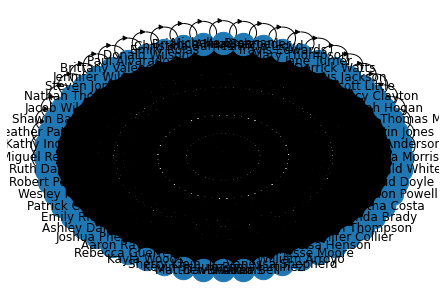

In [ ]:
handover_of_work = social_network_analysis_module.sna.handover_of_work(xes_log)

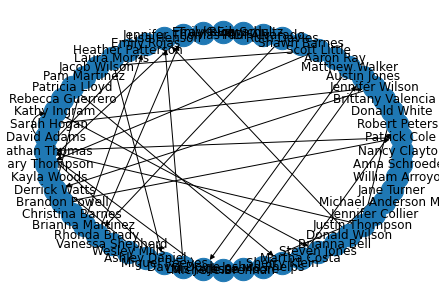

In [ ]:
subcontracting = social_network_analysis_module.sna.subcontracting(xes_log)

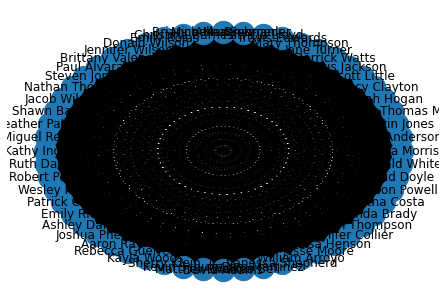

In [ ]:
working_together = social_network_analysis_module.sna.working_together(xes_log) 

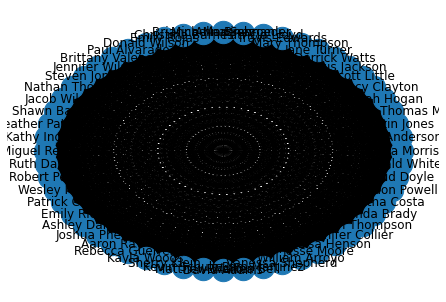

In [ ]:
similar_activities = social_network_analysis_module.sna.similar_activities(xes_log) 

In [ ]:
organizational_mining = social_network_analysis_module.sna.organizational_mining(xes_log) 


group_relative_focus
{'Jennifer Thomas MD': {'W_Completeren aanvraag': 0.018608920599157173, 'W_Nabellen offertes': 0.01841051532033426, 'W_Valideren aanvraag': 0.019379354021532614, 'W_Afhandelen leads': 0.01865038996269922, 'W_Nabellen incomplete dossiers': 0.018848075742964845, 'W_Beoordelen fraude': 0.011111111111111112}, 'Robert Peters': {'W_Completeren aanvraag': 0.01568823799390829, 'W_Nabellen offertes': 0.01745299442896936, 'W_Valideren aanvraag': 0.01773274224192527, 'W_Afhandelen leads': 0.016615801966768397, 'W_Nabellen incomplete dossiers': 0.017182431840098187, 'W_Beoordelen fraude': 0.022222222222222223}, 'Christina Barnes': {'W_Completeren aanvraag': 0.018567196561939333, 'W_Nabellen offertes': 0.017104805013927575, 'W_Valideren aanvraag': 0.018872704243191894, 'W_Afhandelen leads': 0.018480840963038318, 'W_Nabellen incomplete dossiers': 0.01630577715437889, 'W_Beoordelen fraude': 0.014814814814814815}, 'David Adams': {'W_Completeren aanvraag': 0.017524095631493302, 'W

In [ ]:
clustering = social_network_analysis_module.sna.clustering(xes_log) 

clustered similar activities metric: {'1': ['Derrick Watts', 'Christina Barnes', 'Jennifer Wilson', 'Heather Patterson', 'Brianna Bell', 'Joshua Phelps', 'Justin Thompson', 'Travis Edwards', 'Scott Little', 'Steven Jones', 'Jacob Wilson', 'Jane Turner'], '2': ['Patrick Cole', 'Lisa Henson', 'Donald Wilson', 'Rebecca Guerrero', 'Matthew Walker', 'William Arroyo', 'Nancy Clayton', 'Robert Peters', 'Kathy Ingram', 'Brianna Martinez', 'Anna Schroeder', 'Jennifer Collier', 'Nathan Thomas', 'Vanessa Shepherd', 'Luis Jackson', 'Michelle Brennan', 'Ruth Davies', 'Donald White', 'Emily Rojas', 'Aaron Ray', 'Kevin Schultz', 'Shawn Barnes', 'Paul Alvarado', 'Michael Anderson MD', 'Sherry Klein', 'Patricia Lloyd', 'Miguel Reeves', 'Austin Jones'], '0': ['Kayla Woods', 'Martha Costa', 'Laura Morris', 'Brandon Powell', 'Ashley Daniel', 'David Doyle', 'Jennifer Thomas MD', 'Jesse Moore', 'Brittany Valencia', 'Pam Martinez', 'Sarah Hogan', 'Wesley Mills', 'David Adams', 'Emily Rice', 'Rhonda Brady', '

### EDA

<AxesSubplot: >

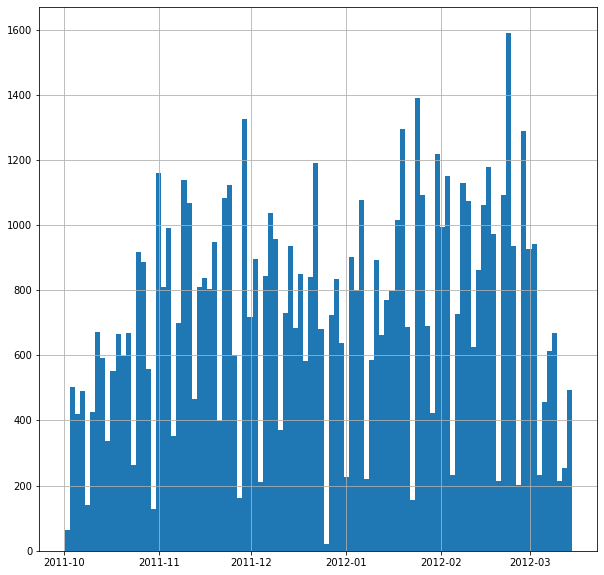

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10,10))
df_log['time:timestamp'].hist(bins=100)

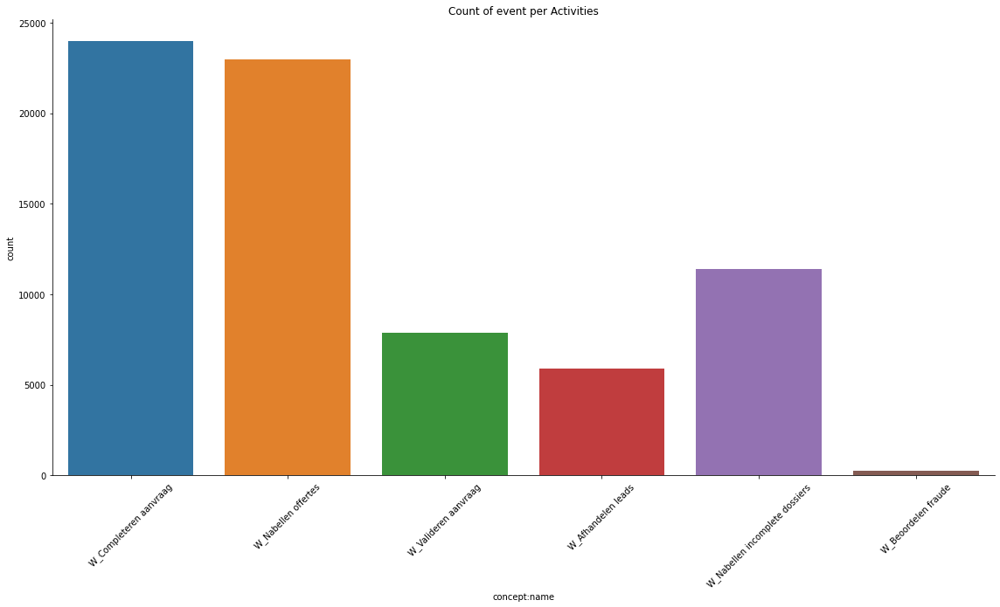

In [ ]:
fig = sns.catplot(x='concept:name', kind='count', data=df_log, height=8, aspect=2)
plt.xticks(rotation=45)
plt.title('Count of event per Activities')
plt.show(fig)

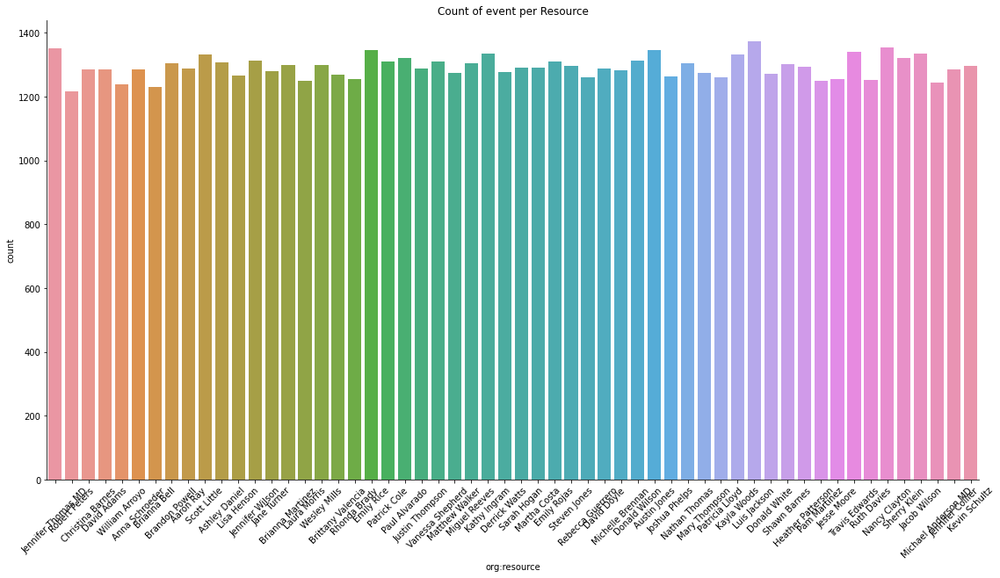

In [ ]:
fig = sns.catplot(x='org:resource', kind='count', data=df_log, height=8, aspect=2)
plt.xticks(rotation=45)
plt.title('Count of event per Resource')
plt.show(fig)

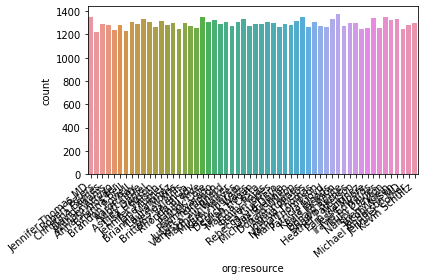

In [ ]:
ax=sns.countplot(x=df_log['org:resource'],data=df_log)

ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")  #it will rotate text on x axis

plt.tight_layout()
plt.show()

In [ ]:
activities = pm4py.get_event_attribute_values(df_log, "concept:name")
resources = pm4py.get_event_attribute_values(df_log, "org:resource")

In [ ]:
activities

{'W_Completeren aanvraag': 23967,
 'W_Nabellen offertes': 22976,
 'W_Nabellen incomplete dossiers': 11407,
 'W_Valideren aanvraag': 7895,
 'W_Afhandelen leads': 5898,
 'W_Beoordelen fraude': 270}

In [ ]:
resources

{'Luis Jackson': 1372,
 'Nancy Clayton': 1353,
 'Jennifer Thomas MD': 1350,
 'Emily Rice': 1346,
 'Austin Jones': 1346,
 'Travis Edwards': 1341,
 'Kathy Ingram': 1335,
 'Jacob Wilson': 1335,
 'Scott Little': 1333,
 'Kayla Woods': 1333,
 'Paul Alvarado': 1322,
 'Sherry Klein': 1321,
 'Donald Wilson': 1314,
 'Jennifer Wilson': 1313,
 'Emily Rojas': 1311,
 'Patrick Cole': 1311,
 'Vanessa Shepherd': 1310,
 'Ashley Daniel': 1307,
 'Brandon Powell': 1305,
 'Nathan Thomas': 1304,
 'Miguel Reeves': 1304,
 'Shawn Barnes': 1302,
 'Wesley Mills': 1300,
 'Brianna Martinez': 1298,
 'Steven Jones': 1296,
 'Kevin Schultz': 1296,
 'Heather Patterson': 1294,
 'Martha Costa': 1292,
 'Sarah Hogan': 1291,
 'David Doyle': 1289,
 'Aaron Ray': 1289,
 'Justin Thompson': 1288,
 'Christina Barnes': 1286,
 'Jennifer Collier': 1285,
 'David Adams': 1285,
 'Anna Schroeder': 1284,
 'Michelle Brennan': 1283,
 'Jane Turner': 1281,
 'Derrick Watts': 1276,
 'Mary Thompson': 1275,
 'Matthew Walker': 1273,
 'Donald White

### VISPM https://github.com/AdamBanham/vispm

[StaticDottedChartPresentor] Processing event data... 
[StaticDottedChartPresentor] Cannot find concept:name in eventlog attributes. 
[StaticDottedChartPresentor] Ready to plot... 
[StaticDottedChartPresentor] Compiling finished...         
[StaticDottedChartPresentor] Plotting data... 
[StaticDottedChartPresentor] Cleaning up plot... 
[StaticDottedChartPresentor] Plot is ready to show... 


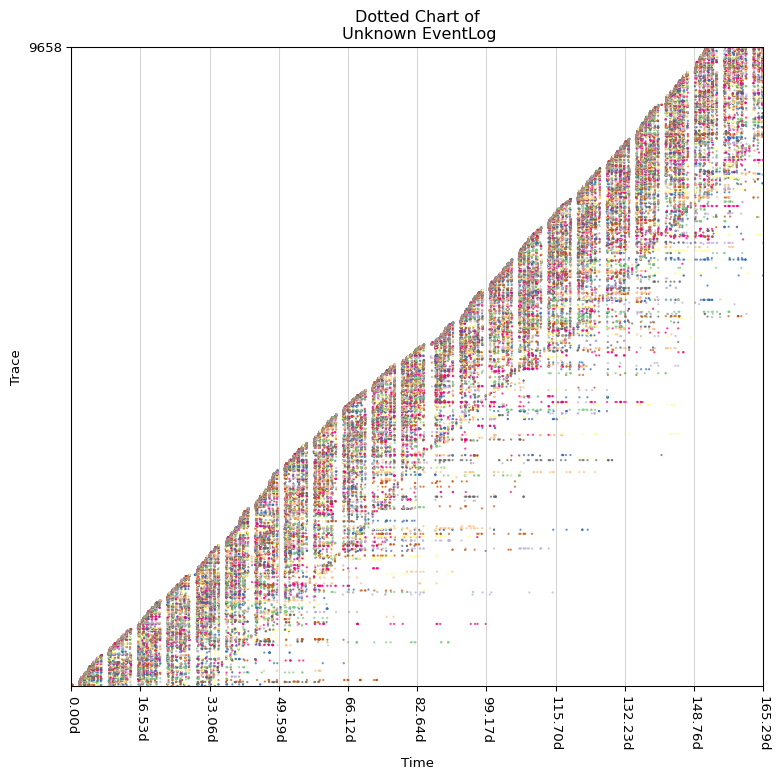

In [ ]:
# Static Presentors
from vispm import StaticDottedChartPresentor
from vispm.helpers.colours.colourmaps import HIGH_CONTRAST_COOL,HIGH_CONTRAST_WARM,EARTH,COOL_WINTER,CATEGORICAL
from matplotlib import pyplot as plt

presentor = StaticDottedChartPresentor(xes_log)
presentor.plot()
plt.show()

[StaticDottedChartPresentor] Processing event data... 
[StaticDottedChartPresentor] Cannot find concept:name in eventlog attributes. 
[StaticDottedChartPresentor] Ready to plot... 
[StaticDottedChartPresentor] Added extension : DottedColourHistogramExtension 
[StaticDottedChartPresentor] Added extension : DottedColourHistogramExtension 
[StaticDottedChartPresentor] Added extension : DottedColourHistogramExtension 
[StaticDottedChartPresentor] Added extension : DottedColourHistogramExtension 
[StaticDottedChartPresentor] Compiling finished...         
[StaticDottedChartPresentor] Plotting data... 
[DottedColourHistogramExtension] ploting histogram... 
[DottedColourHistogramExtension] ploting histogram... 
[DottedColourHistogramExtension] ploting histogram... 
[DottedColourHistogramExtension] ploting histogram... 
[StaticDottedChartPresentor] Cleaning up plot... 
[StaticDottedChartPresentor] Plot is ready to show... 


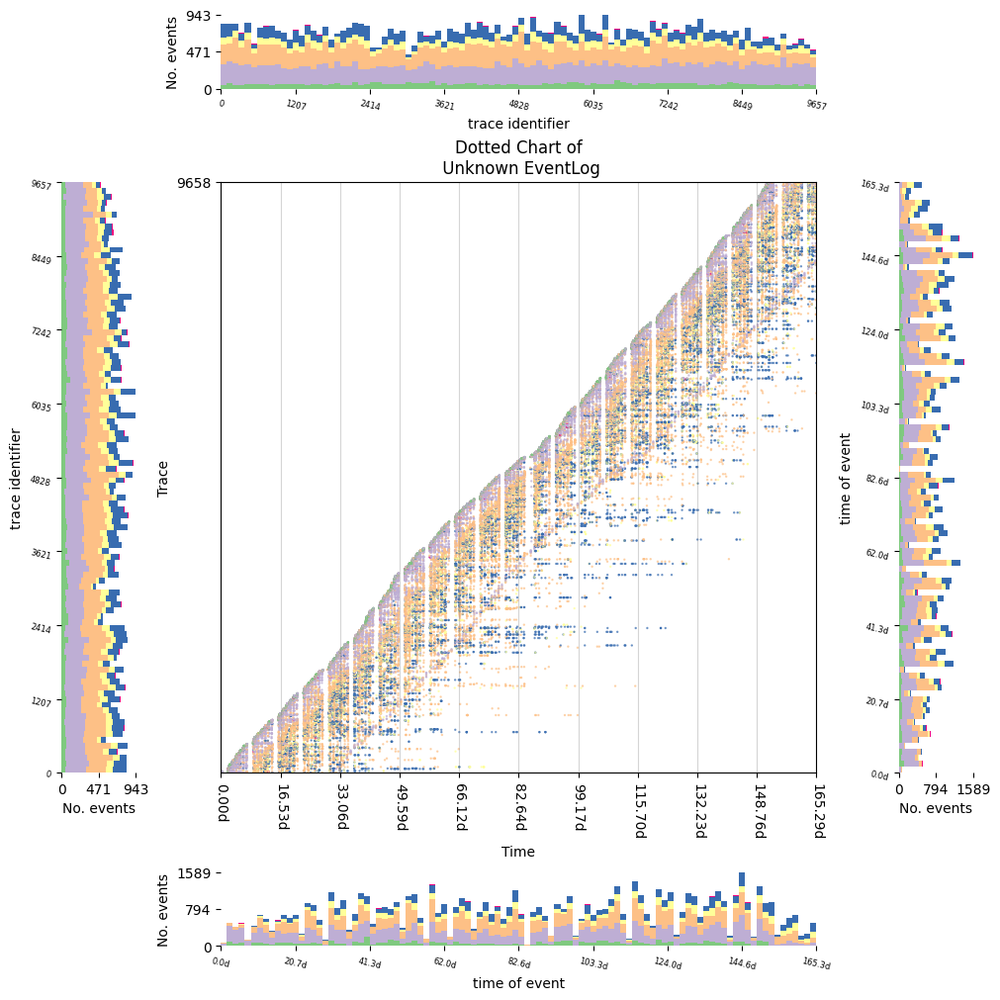

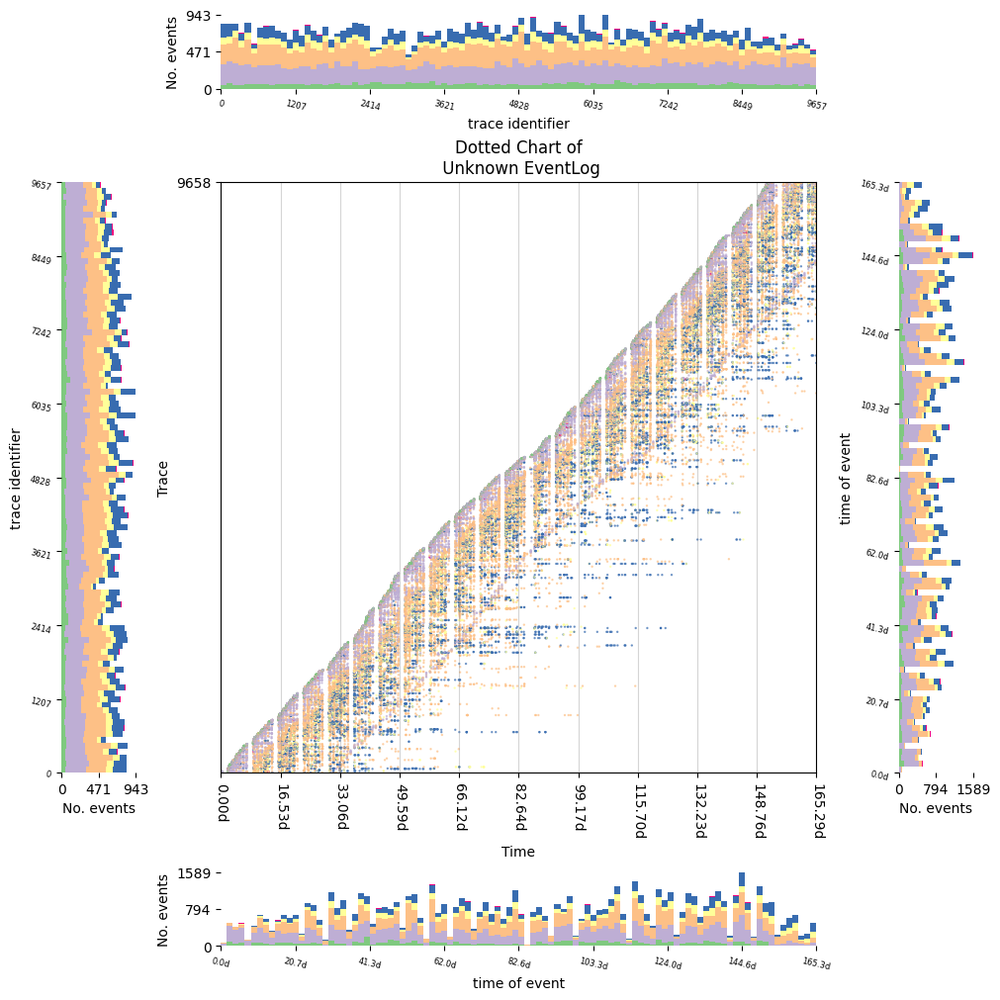

In [ ]:
# DottedColourHistogramExtension
#This extension plots a histogram based on the events within a dotted chart. Events will be broken down by colour for each bin.
from vispm import StaticDottedChartPresentor, DottedColourHistogramExtension
from vispm.helpers.colours.colourmaps import HIGH_CONTRAST_COOL,HIGH_CONTRAST_WARM,EARTH,COOL_WINTER,CATEGORICAL


presentor = StaticDottedChartPresentor(xes_log,dpi=100,
    event_colour_scheme=StaticDottedChartPresentor.EventColourScheme.EventLabel,
    colormap=CATEGORICAL
)
ext = DottedColourHistogramExtension(direction=DottedColourHistogramExtension.Direction.NORTH)
presentor.add_extension(ext)
ext = DottedColourHistogramExtension(direction=DottedColourHistogramExtension.Direction.SOUTH,
         bin_axes=DottedColourHistogramExtension.PlotAxes.X)
presentor.add_extension(ext)
ext = DottedColourHistogramExtension(direction=DottedColourHistogramExtension.Direction.WEST)
presentor.add_extension(ext)
ext = DottedColourHistogramExtension(direction=DottedColourHistogramExtension.Direction.EAST,
         bin_axes=DottedColourHistogramExtension.PlotAxes.X)
presentor.add_extension(ext)
presentor.plot()

[StaticDottedChartPresentor] Processing event data... 
[StaticDottedChartPresentor] Cannot find concept:name in eventlog attributes. 
[StaticDottedChartPresentor] Ready to plot... 
[StaticDottedChartPresentor] Added extension : DottedEventHistogramExtension 
[StaticDottedChartPresentor] Added extension : DottedEventHistogramExtension 
[StaticDottedChartPresentor] Added extension : DottedEventHistogramExtension 
[StaticDottedChartPresentor] Added extension : DottedEventHistogramExtension 
[StaticDottedChartPresentor] Compiling finished...         
[StaticDottedChartPresentor] Plotting data... 
[DottedEventHistogramExtension] ploting histogram... 
[DottedEventHistogramExtension] Event labels are imputed as :: {'W_Afhandelen leads': 'A', 'W_Beoordelen fraude': 'B', 'W_Completeren aanvraag': 'C', 'W_Nabellen offertes': 'D', 'W_Valideren aanvraag': 'E', 'W_Nabellen incomplete dossiers': 'F'} 
[DottedEventHistogramExtension] ploting histogram... 
[DottedEventHistogramExtension] Event labels 

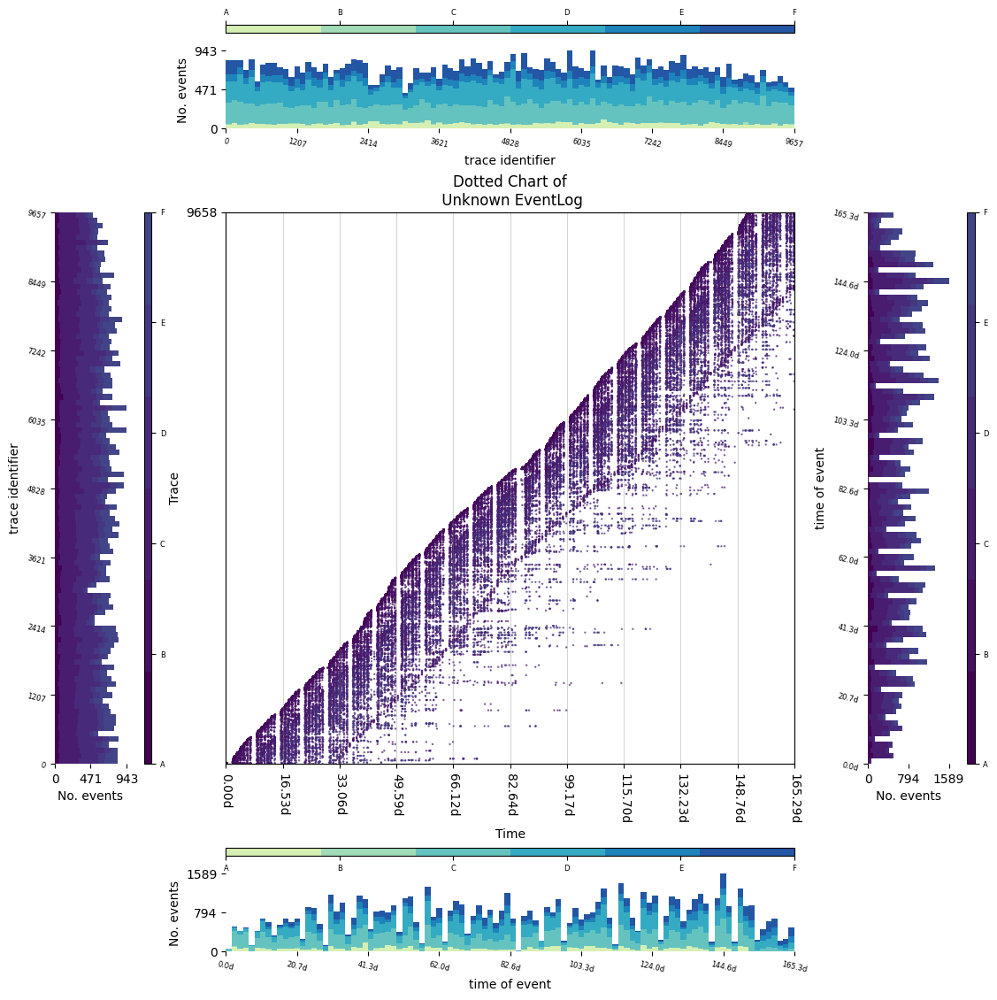

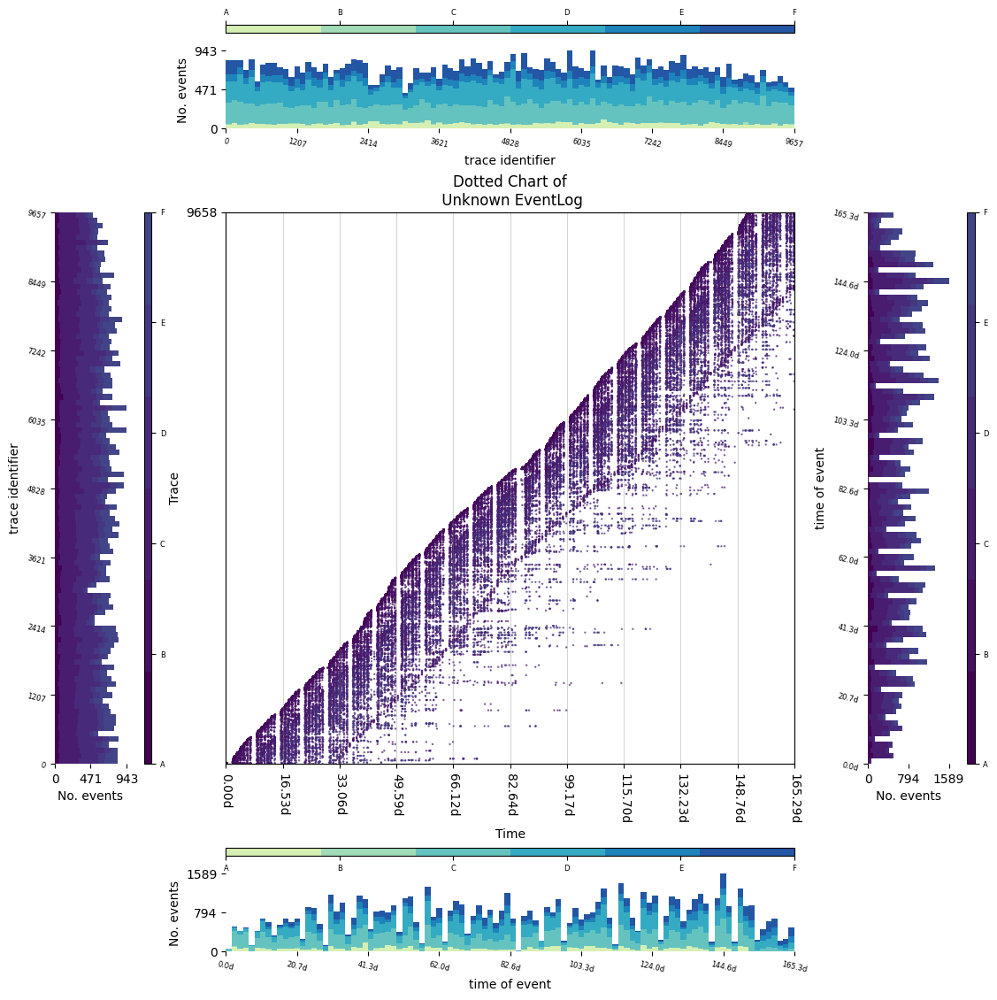

In [ ]:
# 1. setup up colour schemes to use
from vispm import StaticDottedChartPresentor, DottedColourHistogramExtension, DottedEventHistogramExtension
from vispm.helpers.colours.colourmaps import HIGH_CONTRAST_COOL,HIGH_CONTRAST_WARM
from vispm.helpers.colours.colourmaps import EARTH,COOL_WINTER
from vispm import StaticDottedChartPresentor,DottedColourHistogramExtension

import numpy as np
from matplotlib.colors import ListedColormap
from matplotlib.cm import get_cmap

colourmaps = [COOL_WINTER,EARTH,HIGH_CONTRAST_COOL,HIGH_CONTRAST_WARM]
seq_colourmap = np.vstack(
    (
    colourmaps[0](np.linspace(0.20,1,8)),
    colourmaps[1](np.linspace(0.20,1,8)),
    colourmaps[2](np.linspace(0.20,1,8)),
    colourmaps[3](np.linspace(0.20,1,8))
    
    )
)
seq_colourmap = ListedColormap(seq_colourmap, name='VARIANCE')
cmap = get_cmap(HIGH_CONTRAST_COOL, 26)


# 2. create a presentor and add extensions
presentor = StaticDottedChartPresentor(xes_log,dpi=100,
    event_colour_scheme=StaticDottedChartPresentor.EventColourScheme.EventLabel,
    colormap=cmap
)

ext = DottedEventHistogramExtension(
    direction=DottedEventHistogramExtension.Direction.SOUTH,
    bin_axes=DottedEventHistogramExtension.PlotAxes.X,
    colourmap=seq_colourmap
)
presentor.add_extension(ext)
ext = DottedEventHistogramExtension(
    direction=DottedEventHistogramExtension.Direction.NORTH,
    bin_axes=DottedEventHistogramExtension.PlotAxes.Y,
    colourmap=seq_colourmap
)
presentor.add_extension(ext)
ext = DottedEventHistogramExtension(
    direction=DottedEventHistogramExtension.Direction.WEST,
    bin_axes=DottedEventHistogramExtension.PlotAxes.Y,
    colourmap=cmap
)
presentor.add_extension(ext)
ext = DottedEventHistogramExtension(
    direction=DottedEventHistogramExtension.Direction.EAST,
    bin_axes=DottedEventHistogramExtension.PlotAxes.X,
    colourmap=cmap
)
presentor.add_extension(ext)

presentor.plot()

[StaticDottedChartPresentor] Processing event data... 
[StaticDottedChartPresentor] Cannot find concept:name in eventlog attributes. 
[StaticDottedChartPresentor] Ready to plot... 
[StaticDottedChartPresentor] Added extension : DottedEventHistogramExtension 
[StaticDottedChartPresentor] Added extension : DottedEventHistogramExtension 
[StaticDottedChartPresentor] Added extension : DottedEventHistogramExtension 
[StaticDottedChartPresentor] Added extension : DottedEventHistogramExtension 
[StaticDottedChartPresentor] Compiling finished...         
[StaticDottedChartPresentor] Plotting data... 
[DottedEventHistogramExtension] ploting histogram... 
[DottedEventHistogramExtension] Event labels are imputed as :: {'W_Afhandelen leads': 'A', 'W_Beoordelen fraude': 'B', 'W_Completeren aanvraag': 'C', 'W_Nabellen offertes': 'D', 'W_Valideren aanvraag': 'E', 'W_Nabellen incomplete dossiers': 'F'} 
[DottedEventHistogramExtension] ploting histogram... 
[DottedEventHistogramExtension] Event labels 

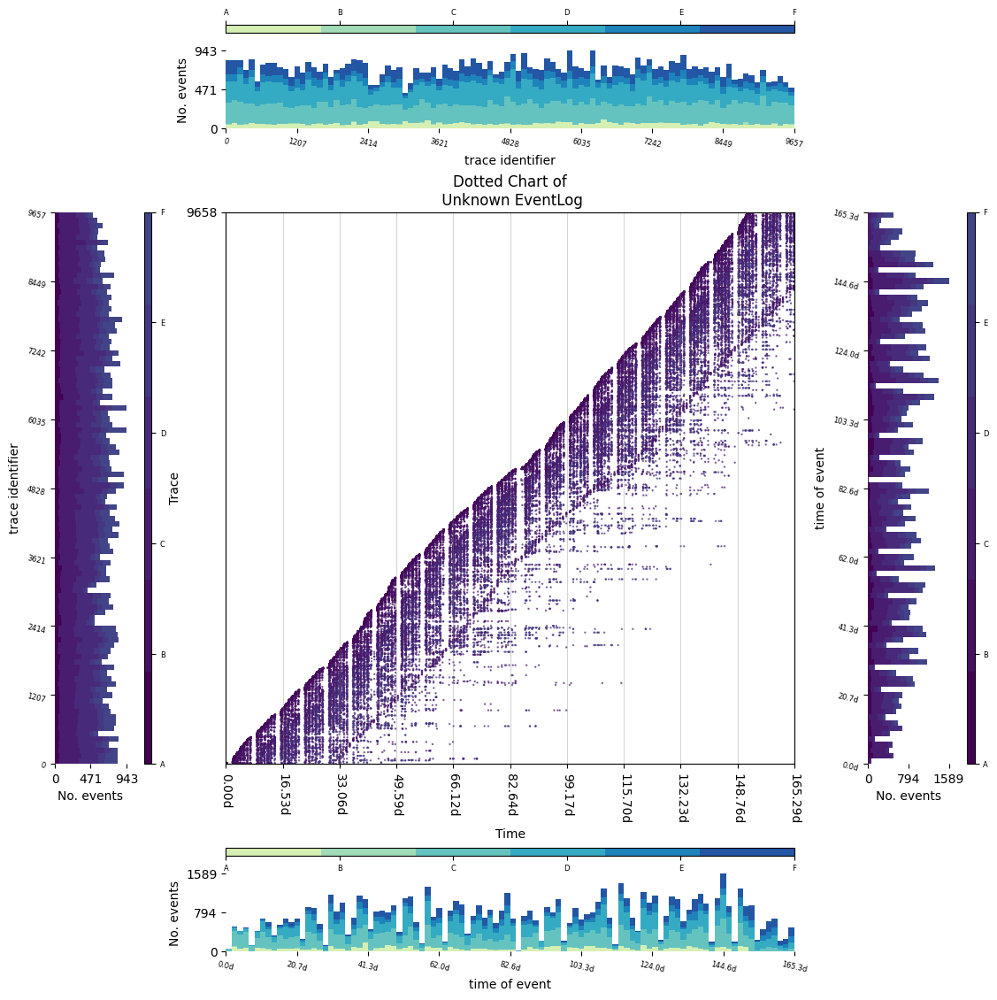

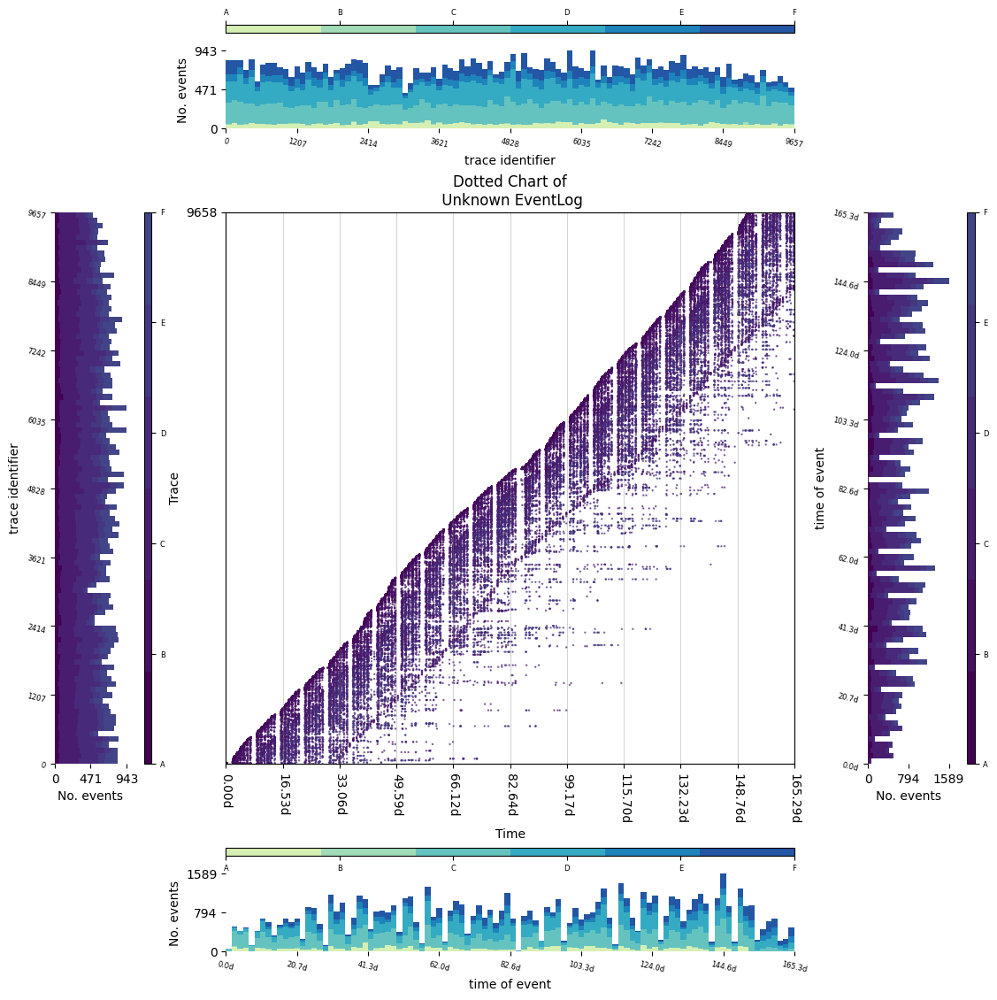

In [ ]:
# 1. setup up colour schemes to use
from vispm import StaticDottedChartPresentor, DottedColourHistogramExtension, DottedEventHistogramExtension
from vispm.helpers.colours.colourmaps import HIGH_CONTRAST_COOL,HIGH_CONTRAST_WARM,EARTH,COOL_WINTER,CATEGORICAL
from vispm import StaticDottedChartPresentor,DottedColourHistogramExtension

import numpy as np
from matplotlib.colors import ListedColormap
from matplotlib.cm import get_cmap

colourmaps = [COOL_WINTER,EARTH,HIGH_CONTRAST_COOL,HIGH_CONTRAST_WARM, CATEGORICAL]
seq_colourmap = np.vstack(
    (
    colourmaps[0](np.linspace(0.20,1,8)),
    colourmaps[1](np.linspace(0.20,1,8)),
    colourmaps[2](np.linspace(0.20,1,8)),
    colourmaps[3](np.linspace(0.20,1,8)),
    colourmaps[4](np.linspace(0.20,1,8))
    
    )
)
seq_colourmap = ListedColormap(seq_colourmap, name='VARIANCE')
cmap = get_cmap(HIGH_CONTRAST_COOL, 26)


# 2. create a presentor and add extensions
presentor = StaticDottedChartPresentor(xes_log,dpi=100,
    event_colour_scheme=StaticDottedChartPresentor.EventColourScheme.EventLabel,
    colormap=cmap
)

ext = DottedEventHistogramExtension(
    direction=DottedEventHistogramExtension.Direction.SOUTH,
    bin_axes=DottedEventHistogramExtension.PlotAxes.X,
    colourmap=seq_colourmap
)
presentor.add_extension(ext)
ext = DottedEventHistogramExtension(
    direction=DottedEventHistogramExtension.Direction.NORTH,
    bin_axes=DottedEventHistogramExtension.PlotAxes.Y,
    colourmap=seq_colourmap
)
presentor.add_extension(ext)
ext = DottedEventHistogramExtension(
    direction=DottedEventHistogramExtension.Direction.WEST,
    bin_axes=DottedEventHistogramExtension.PlotAxes.Y,
    colourmap=cmap
)
presentor.add_extension(ext)
ext = DottedEventHistogramExtension(
    direction=DottedEventHistogramExtension.Direction.EAST,
    bin_axes=DottedEventHistogramExtension.PlotAxes.X,
    colourmap=cmap
)
presentor.add_extension(ext)

presentor.plot()

[StaticDottedChartPresentor] Processing event data... 
[StaticDottedChartPresentor] Cannot find concept:name in eventlog attributes. 
[StaticDottedChartPresentor] Ready to plot... 
[StaticDottedChartPresentor] Added extension : DescriptionHistogramExtension 
[StaticDottedChartPresentor] Added extension : DescriptionHistogramExtension 
[StaticDottedChartPresentor] Added extension : DescriptionHistogramExtension 
[StaticDottedChartPresentor] Added extension : DescriptionHistogramExtension 
[StaticDottedChartPresentor] Compiling finished...         
[StaticDottedChartPresentor] Plotting data... 
[DescriptionHistogramExtension] plotting histogram 
[DescriptionHistogramExtension] Event labels are imputed as :: {'W_Afhandelen leads': 'A', 'W_Beoordelen fraude': 'B', 'W_Completeren aanvraag': 'C', 'W_Nabellen offertes': 'D', 'W_Valideren aanvraag': 'E', 'W_Nabellen incomplete dossiers': 'F'} 
[DescriptionHistogramExtension] plotting histogram 
[DescriptionHistogramExtension] plotting histogra

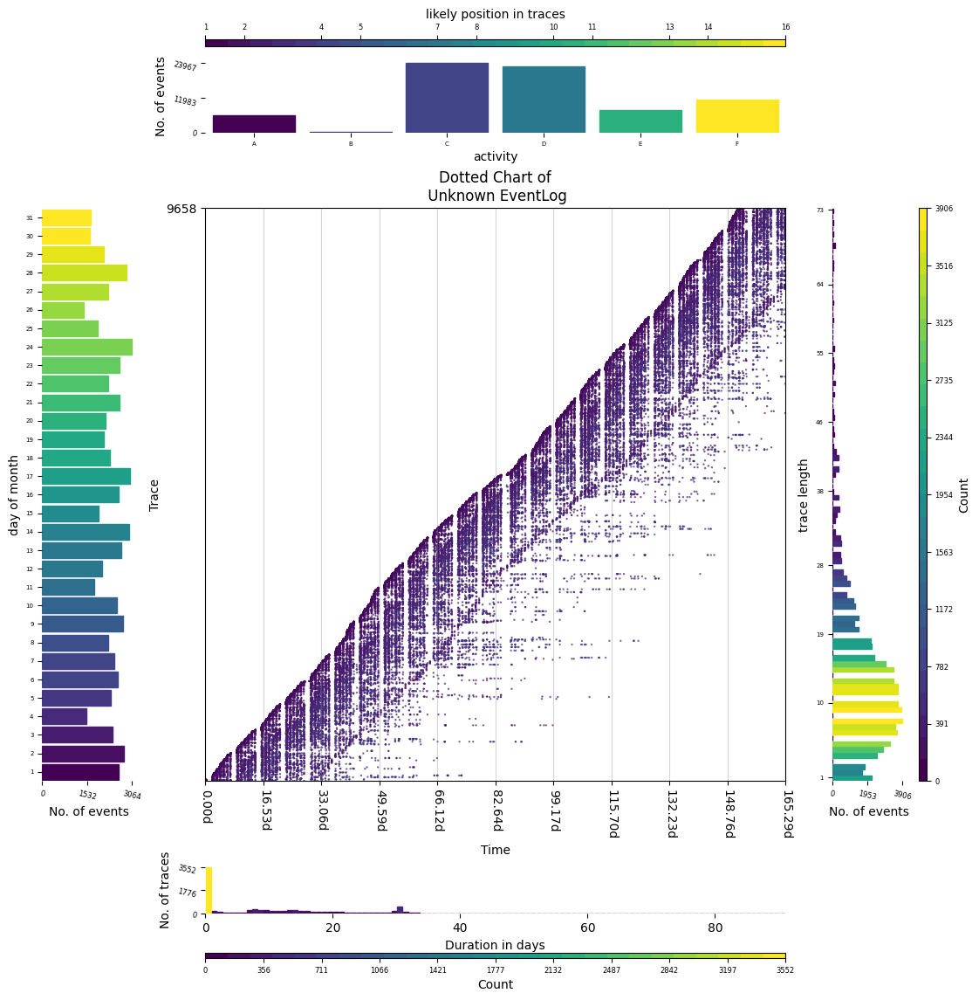

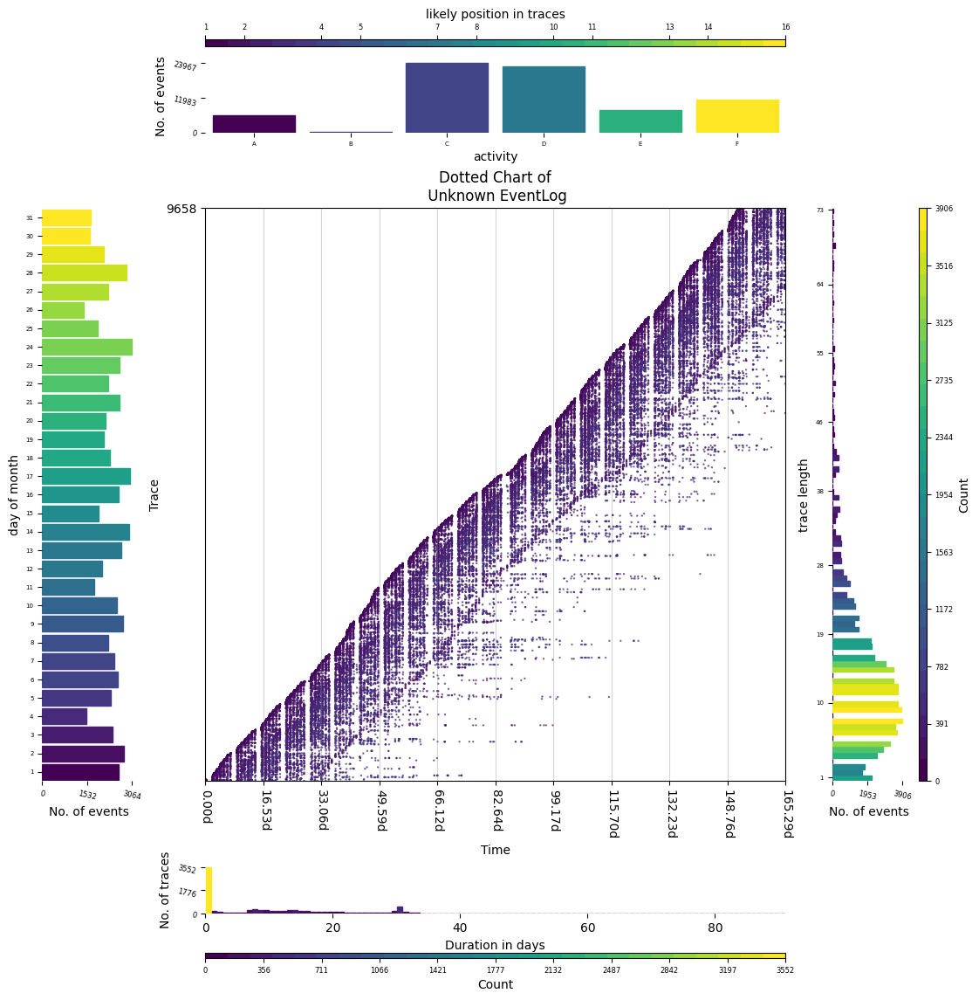

In [ ]:
#DescriptionHistogramExtension
#This extension describes an aspect of the event log.
# For example, a breakdown of trace duration, or trace length (by the number of activities), or event label, or when events occur (weekday or monthday).

#The following example shows how to use this extension to understand the properties of event log, alongside a dotted chart.


from vispm import DescriptionHistogramExtension
from vispm.helpers.colours.colourmaps import HIGH_CONTRAST_COOL,HIGH_CONTRAST_WARM,EARTH,COOL_WINTER,CATEGORICAL
from vispm import StaticDottedChartPresentor,DottedColourHistogramExtension


cmap = get_cmap(HIGH_CONTRAST_COOL, 26)
presentor = StaticDottedChartPresentor(xes_log,dpi=100,
    event_colour_scheme=StaticDottedChartPresentor.EventColourScheme.EventLabel,
    colormap=cmap
)

ext = DescriptionHistogramExtension(
)
presentor.add_extension(ext)

ext = DescriptionHistogramExtension(
    direction=DescriptionHistogramExtension.Direction.EAST,
    describe=DescriptionHistogramExtension.Describe.TraceLength,
    density=DescriptionHistogramExtension.Density.Event
)
presentor.add_extension(ext)

ext = DescriptionHistogramExtension(
    direction=DescriptionHistogramExtension.Direction.SOUTH,
    describe=DescriptionHistogramExtension.Describe.TraceDuration,
    density=DescriptionHistogramExtension.Density.Trace
)
presentor.add_extension(ext)

ext = DescriptionHistogramExtension(
    direction=DescriptionHistogramExtension.Direction.WEST,
    describe=DescriptionHistogramExtension.Describe.Monthday,
    density=DescriptionHistogramExtension.Density.Event
)
presentor.add_extension(ext)

presentor.plot()